In [ ]:
!pip install -U git+https://github.com/BraiDyn-BC/bdbc-nwb-explorer.git

  Cloning https://github.com/BraiDyn-BC/bdbc-nwb-explorer.git to /tmp/pip-req-build-fcjx8u_n
  Running command git clone --filter=blob:none --quiet https://github.com/BraiDyn-BC/bdbc-nwb-explorer.git /tmp/pip-req-build-fcjx8u_n
  Resolved https://github.com/BraiDyn-BC/bdbc-nwb-explorer.git to commit 2bbe7fca25795b4085871aa207fdd1e9fdce837e
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 48.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 336.7/336.7 kB 21.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 118.6/118.6 kB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 739.1/739.1 kB 38.1 MB/s eta 0:00:00
  Created wheel for bdbc-nwb-explorer: filename=bdbc_nwb_explorer-0.3.9-py3-none-any.whl size=37495 sha256=ad4d0530445755b31851d822ed94dde593c247f1431163ee15c1b561e9489105
  Stored in directory: /tmp/pip-

In [ ]:
from time import time as now
from pathlib import Path
from time import time as now
from pynwb import NWBHDF5IO
import numpy as np
import matplotlib.pyplot as plt
from google.colab import drive
import bdbc_nwb_explorer as nwbx
from math import ceil

# Google Driveへの接続
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install japanize-matplotlib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.1/4.1 MB 53.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for japanize-matplotlib: filename=japanize_matplotlib-1.1.3-py3-none-any.whl size=4120257 sha256=8c15adc3962b7eb5090ee7440002e8c94904213ff7d740fb6afb7ddec2742c72
  Stored in directory: /root/.cache/pip/wheels/da/a1/71/b8faeb93276fed10edffcca20746f1ef6f8d9e071eee8425fc
Successfully built japanize-matplotlib


##データの読み込み

slackにあげられているVG1GC-105のファイル（L1L2.csvが含まれているもの）を
mydrive上にアップロードして使っています

In [ ]:
# 適当にテストNWBファイルを選択
dataroot = Path('/content/drive/MyDrive/braidyn-bc/data')
testfile = dataroot / "VG1GC-105" / "VG1GC-105_2024-02-02_task-day8.nwb"
# bdbc-nwb-explorerを使って読み込み
print("--> reading...", end=' ', flush=True)
start = now()
session = nwbx.read_nwb(testfile)
stop = now()
print(f"done (took {(stop - start) / 60:.1f} min)", flush=True)
session

--> reading... 

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)


done (took 0.6 min)


NWBData(
    subject='VG1-GC#105',
    session_date='2024-02-02',
    session_type='task',
    session_description='Lever-pull task: if the animal sufficiently pull the lever with their right forelimb after the tone presentation, a drop of water is given.',
    session_notes='',
    trials=<163 trials>,
    daq=<12 x 54000 timepoints (30 Hz)>,
    imaging=<44 x 54000 timepoints (30 Hz)>,
    body_video=<5 x 54000 timepoints (30 Hz)>,
    face_video=<14 x 54000 timepoints (30 Hz)>,
    eye_video=<4 x 54000 timepoints (30 Hz)>,
)

データを確認します

In [ ]:
session.trials.data

,start_time,stop_time,pull_onset,reaction_time,pull_duration_for_success,trial_outcome
0,11.878400,12.678400,12.645200,0.7738,0.3,miss
1,15.845200,16.878599,NaN,NaN,0.3,failure
2,21.545200,24.011801,21.711800,0.1742,0.3,success
3,38.245399,40.712002,38.411999,0.1398,0.3,success
4,52.045399,54.545399,52.245399,0.1918,0.3,success
...,...,...,...,...,...,...
158,1755.091187,1757.724609,1755.291260,0.2102,0.4,success
159,1772.824585,1775.391357,1772.991211,0.1832,0.4,success
160,1783.057983,1785.557983,1783.157959,0.1036,0.4,success
161,1789.157959,1791.824829,1789.424805,0.2582,0.4,success


In [ ]:
session.trials.data[session.trials.data['trial_outcome']=='miss']

,start_time,stop_time,pull_onset,reaction_time,pull_duration_for_success,trial_outcome
0,11.878400,12.678400,12.645200,0.7738,0.30,miss
7,123.479202,124.479202,124.346001,0.8654,0.30,miss
10,167.379593,167.579605,167.513000,0.1364,0.30,miss
27,356.347595,357.114410,356.914398,0.5802,0.35,miss
36,465.881805,466.148407,466.115204,0.2340,0.35,miss
38,480.748596,480.915192,480.781799,0.0522,0.35,miss
41,509.048798,509.348785,509.348785,0.2512,0.35,miss
50,619.316223,619.449585,619.349609,0.0266,0.35,miss
66,865.218018,865.718018,865.684570,0.4634,0.35,miss
82,1020.185791,1020.452393,1020.185791,0.0000,0.40,miss


In [ ]:
session.entries.data

,tone,lever,reward,lick,lick_rate,motion,state_lever,state_task,air_pressure,CO2_level,...,eyemedial_x,eyemedial_y,eyelateral_x,eyelateral_y,earroot_x,earroot_y,eartip_x,eartip_y,earlateral_x,earlateral_y
5.211800,0.0,0.519626,0.0,0.0,5.805981,0.036374,0,0,1018.970000,541.0,...,334.312256,28.914631,290.913635,45.225594,194.157104,77.742104,30.602299,75.380470,26.094009,124.691795
5.245000,0.0,0.216686,0.0,0.0,5.616387,0.032968,0,0,1018.970000,541.0,...,335.058746,28.775660,291.155823,45.100330,196.883133,76.784897,30.111256,78.131462,27.637333,125.942657
5.278400,0.0,0.212058,0.0,0.0,5.431898,0.037621,0,0,1018.970000,541.0,...,334.725983,28.803545,290.885895,45.991123,197.415344,77.087204,29.054781,79.275230,28.804424,127.173607
5.311800,0.0,0.212058,0.0,0.0,5.253469,0.056915,0,0,1018.970000,541.0,...,333.925751,28.908127,290.753052,45.805489,199.147354,75.974907,30.669128,75.891212,28.767042,124.103142
5.345000,0.0,0.212058,0.0,0.0,5.081917,0.060866,0,0,1018.970000,541.0,...,334.874725,28.663345,291.086578,45.325478,199.806091,76.423859,30.847652,76.498413,29.386515,124.572227
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1805.058228,0.0,0.212058,0.0,0.0,2.716038,0.024478,0,0,1019.430000,495.0,...,332.474030,27.966166,291.792328,42.649578,203.579208,70.278931,32.738758,65.994995,32.652035,117.614616
1805.091553,0.0,0.212058,0.0,0.0,2.626821,0.019120,0,0,1019.430000,495.0,...,333.052765,28.054453,291.626282,42.538361,202.635681,70.635033,33.017254,67.104149,32.069675,118.687103
1805.124756,0.0,0.212058,0.0,0.0,2.541042,0.051879,0,0,1019.430000,495.0,...,331.024933,27.107676,291.679352,42.177811,203.874771,70.649956,35.645515,69.230179,35.257702,121.401268
1805.158203,0.0,0.212058,0.0,0.0,2.457573,0.075222,0,0,1019.430000,495.0,...,330.469452,27.199175,292.691010,40.738544,201.686584,70.864441,35.198524,71.147476,38.182693,126.140762


In [ ]:
# imagingから全データをpandasデータフレームとして取り出す
all_rois = session.imaging.data

all_rois

,AUDp_l,AUDs_l,MOp_l,MOs_l,OB_l,RSPagl_l,RSPd_l,SSp_bfd_l,SSp_ll_l,SSp_m_l,...,SSp_ul_r,SSp_un_r,SSs_r,VISa_r,VISal_r,VISam_r,VISl_r,VISp_r,VISpm_r,VISrl_r
5.211800,0.002977,0.007585,0.056853,0.058798,0.043672,0.031391,-0.017742,0.068076,0.062278,0.052785,...,0.066828,0.066066,0.025527,0.046438,0.028581,0.017354,0.009790,0.028157,0.027719,0.048091
5.245000,-0.003060,-0.004232,0.043067,0.046428,0.014031,0.021761,-0.018728,0.059326,0.042755,0.032639,...,0.042152,0.043105,0.009997,0.029416,0.012356,0.008305,-0.004626,0.013037,0.019118,0.032268
5.278400,0.000455,0.001521,0.047358,0.053567,0.002927,0.026917,-0.001257,0.063649,0.039369,0.028646,...,0.036937,0.037553,0.011899,0.028274,0.010974,0.015732,-0.004890,0.012603,0.022682,0.027696
5.311800,0.005770,0.008610,0.053240,0.060938,0.004258,0.030421,0.011343,0.066274,0.036388,0.030179,...,0.033764,0.036641,0.016143,0.028742,0.011703,0.022671,-0.004222,0.012559,0.024104,0.024876
5.345000,0.006850,0.007163,0.050419,0.057634,0.007039,0.022759,0.007320,0.059969,0.024352,0.029439,...,0.024678,0.032093,0.012818,0.022086,0.006834,0.018543,-0.007744,0.005019,0.017158,0.018644
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1805.058228,-0.003561,-0.005788,0.009846,-0.005103,-0.012954,0.008307,-0.013965,-0.007918,0.040335,0.024248,...,0.016251,0.013767,-0.009574,0.018412,-0.009705,0.001535,0.005136,0.004558,0.003128,-0.015738
1805.091553,-0.002529,-0.002325,0.012964,-0.003075,-0.022085,0.008649,-0.014377,-0.002560,0.043259,0.028526,...,0.017485,0.015566,-0.005157,0.018681,-0.006595,0.001299,0.005572,0.005132,0.003312,-0.011224
1805.124756,0.000041,-0.001285,0.014174,-0.000450,-0.023765,0.009848,-0.012702,0.002238,0.044755,0.027025,...,0.017872,0.016803,-0.000388,0.020479,-0.001855,0.001540,0.007941,0.007462,0.003647,-0.007885
1805.158203,0.001716,-0.001311,0.018371,0.005919,-0.014632,0.013856,-0.008259,0.007967,0.048584,0.025942,...,0.021173,0.019280,0.003218,0.023948,0.002912,0.004854,0.010332,0.011277,0.006150,-0.003826


## 音あり・なし試行でマウスがレバーを引いた瞬間の脳領域の活動を可視化

音あり・なし試行でマウスがレバーを引いた瞬間の脳活動の違いを可視化します

In [ ]:
# # 適当にテストNWBファイルを選択
# dataroot = Path('/content/drive/MyDrive/braidyn-bc/data')
# testfile = dataroot / "VG1GC-105" / "VG1GC-105_2024-02-02_task-day8.nwb"
# # bdbc-nwb-explorerを使って読み込み
# print("--> reading...", end=' ', flush=True)
# start = now()
# session = nwbx.read_nwb(testfile)
# stop = now()
# print(f"done (took {(stop - start) / 60:.1f} min)", flush=True)
# session

# all_rois = session.imaging.data

# successだった試行の抽出
#trials = session.trials.data
#success = trials.loc[trials.trial_outcome == "success"]



音無し試行の可視化です。

(trials['state_task'] == 0) & (trials['diff_value'] > 0.4)を条件に試行を抽出しています

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)


全試行数: 54000
フィルタリング後の試行数: 200
lever_time_nocueの先頭5行:
              t  diff_value  lever_time_nocue
101   8.578400    0.733200          7.845200
377  17.778601    0.666801         17.111799
649  26.845200    0.799999         26.045200
745  30.045200    0.666601         29.378599
895  35.045399    1.033398         34.012001


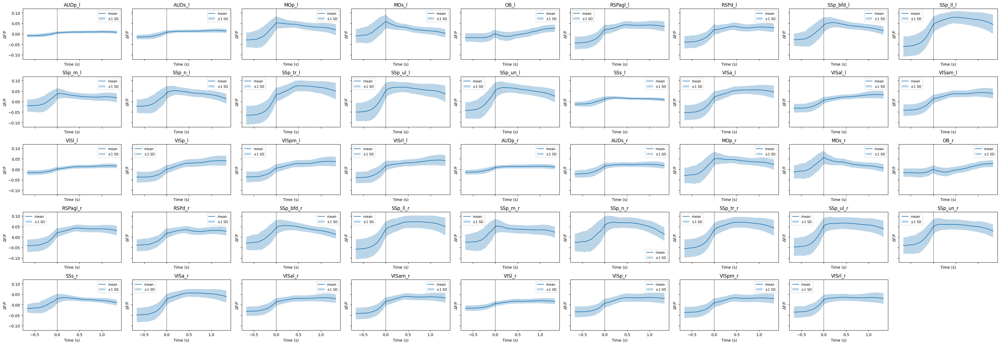

In [ ]:
#音無しレバー引き課題

import numpy as np
import matplotlib.pyplot as plt
from math import ceil
import pandas as pd

# # 適当にテストNWBファイルを選択
dataroot = Path('/content/drive/MyDrive/braidyn-bc/data')
testfile = dataroot / "VG1GC-105" / "VG1GC-105_2024-02-02_task-day8.nwb"
session = nwbx.read_nwb(testfile)



# CSVファイルの読み込み
csv_path = Path('/content/drive/MyDrive/hackathon_data/VG1GC-105/task-day8/trials_L1L2.csv')
trials = pd.read_csv(csv_path)
print("全試行数:", len(trials))

# 条件に合致する行のフィルタリング
filtered_trials = trials[(trials['state_lever']==1) &
                         (trials['state_task'] == 0) &
                         (trials['diff_value'] > 0.4)].copy()
print("フィルタリング後の試行数:", len(filtered_trials))

# lever_time_nocueの算出：tからdiff_valueを引いた時刻
filtered_trials['lever_time_nocue'] = filtered_trials['t'] - filtered_trials['diff_value']
print("lever_time_nocueの先頭5行:\n", filtered_trials[['t', 'diff_value', 'lever_time_nocue']].head())

# 脳活動データ（各ROIの時系列データ）の取得
all_rois = session.imaging.data  # DataFrame形式と仮定

# --- 時間軸生成 ---
imaging_t = all_rois.index.to_numpy()

# プロット用パラメータ
pre_samples  = 20   # レバー引き前のサンプル数
post_samples = 40   # レバー引き後のサンプル数
window_len   = pre_samples + post_samples + 1
time_axis    = (np.arange(window_len) - pre_samples) * (1/30)  # サンプリング30Hz想定

# ROIごとに試行×ウィンドウ長の配列をためる辞書
roi_trials = { roi: [] for roi in all_rois.columns }

for event_time in filtered_trials['lever_time_nocue']:
    idx0 = np.searchsorted(imaging_t, event_time)
    start, end = idx0 - pre_samples, idx0 + post_samples
    if start < 0 or end >= len(imaging_t):
        continue
    window = all_rois.iloc[start:end+1]
    for roi in all_rois.columns:
        roi_trials[roi].append(window[roi].values)

# ROIごとに平均と標準偏差を計算
roi_mean = {}
roi_std  = {}
for roi, trials_list in roi_trials.items():
    if len(trials_list)==0:
        continue
    arr = np.stack(trials_list)  # shape=(n_trials, window_len)
    roi_mean[roi] = np.nanmean(arr, axis=0)
    roi_std[roi]  = np.nanstd(arr, axis=0)

# サブプロット設定
n_rois = len(roi_mean)
n_cols = 9
n_rows = ceil(n_rois / n_cols)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*4, n_rows*2.5), sharex=True, sharey=True)
axes = axes.flatten()

# プロットループ
for ax, roi in zip(axes, roi_mean.keys()):
    mean_ts = roi_mean[roi]
    std_ts  = roi_std[roi]
    ax.plot(time_axis, mean_ts, label='mean')
    ax.fill_between(time_axis,
                    mean_ts - std_ts,
                    mean_ts + std_ts,
                    alpha=0.3, label='±1 SD')
    ax.axvline(0, color='k', linestyle='--', linewidth=0.8)
    ax.set_title(roi)
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('ΔF/F')
    ax.legend(fontsize='small')

# 余分なサブプロットを非表示
for ax in axes[n_rois:]:
    ax.axis('off')

plt.tight_layout()
plt.show()


横軸を時間にして各々の領域の活動を可視化しています（コード未確認）

音あり課題についても同様に可視化を行います。
データを読み込み直しています

lever_time_nocueの先頭5行:
                t  diff_value  pull_onset
564    24.011801         NaN   21.711800
1065   40.712002         NaN   38.411999
1480   54.545399         NaN   52.245399
2165   77.378998         NaN   75.079002
2939  103.179199         NaN  100.879204
event_time=21.712 → imaging_t[495]=21.712
event_time=38.412 → imaging_t[996]=38.412
event_time=52.245 → imaging_t[1411]=52.245
event_time=75.079 → imaging_t[2096]=75.079
event_time=100.879 → imaging_t[2870]=100.879


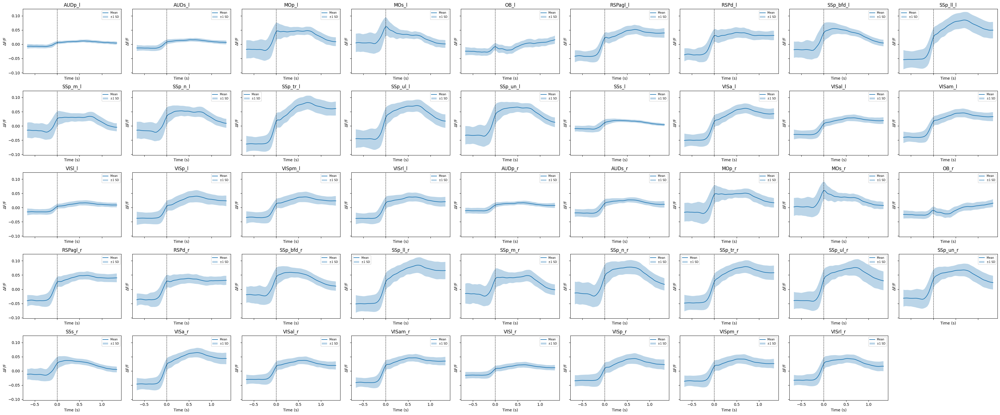

In [ ]:
#音ありレバー引き課題。インデックスの検証が不十分

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

# # --- データ読み込み ---
# csv_path = Path('/content/drive/MyDrive/VG1GC-105/VG1GC-105/task-day8/trials_L1L2.csv')
# trials = pd.read_csv(csv_path)

# dataroot = Path('/content/drive/MyDrive/braidyn-bc/data')
# testfile = dataroot / "VG1GC-105" / "VG1GC-105_2024-02-02_task-day8.nwb"
# session = nwbx.read_nwb(testfile)

# # --- ROI 時系列データ取得 ---
# all_rois = session.imaging.data  # DataFrame: 各列が ROI、各行が時間サンプル

# # --- 時間軸生成 ---
# imaging_t = all_rois.index.to_numpy()

# --- trials フィルタリング ---
filtered = trials.dropna(subset=['trial_outcome'])
filtered = filtered[
    (filtered['first_diff'] > 1.0) &
    (filtered['reaction_time'] > 0.091) &
    (filtered['reaction_time'] < 0.361)
].copy()

print("lever_time_nocueの先頭5行:\n", filtered[['t', 'diff_value', 'pull_onset']].head())

# --- インデックス検証 (最初の5件) ---
for event_time in filtered['pull_onset'].values[:5]:
    idx = np.searchsorted(imaging_t, event_time)
    print(f"event_time={event_time:.3f} → imaging_t[{idx}]={imaging_t[idx]:.3f}")

# --- プロット用パラメータ ---
pre_samples  = 20   # pull_onset の前何サンプル
post_samples = 40   # pull_onset の後何サンプル
window_len   = pre_samples + post_samples + 1
fs           = 30   # サンプリングレート (Hz)
time_axis    = (np.arange(window_len) - pre_samples) / fs  # 秒

# --- ROIごとの試行データを収集 ---
roi_trials = { roi: [] for roi in all_rois.columns }

for event_time in filtered['pull_onset']:
    idx0 = np.searchsorted(imaging_t, event_time)
    start, end = idx0 - pre_samples, idx0 + post_samples
    if start < 0 or end >= len(imaging_t):
        continue
    window = all_rois.iloc[start:end+1]
    for roi in all_rois.columns:
        roi_trials[roi].append(window[roi].values)

# --- 平均と標準偏差を計算 ---
roi_mean = {}
roi_std  = {}
for roi, arr_list in roi_trials.items():
    if not arr_list:
        continue
    arr = np.stack(arr_list)  # shape = (n_trials, window_len)
    roi_mean[roi] = np.nanmean(arr, axis=0)
    roi_std[roi]  = np.nanstd(arr, axis=0)

# --- 描画 ---
n_rois = len(roi_mean)
n_cols = 9
n_rows = ceil(n_rois / n_cols)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*4, n_rows*3), sharex=True, sharey=True)
axes = axes.flatten()

for ax, roi in zip(axes, roi_mean):
    mean_ts = roi_mean[roi]
    std_ts  = roi_std[roi]
    ax.plot(time_axis, mean_ts, label='Mean')
    ax.fill_between(time_axis,
                    mean_ts - std_ts,
                    mean_ts + std_ts,
                    alpha=0.3, label='±1 SD')
    ax.axvline(0, color='k', linestyle='--', lw=0.8)
    ax.set_title(roi)
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('ΔF/F')
    ax.legend(fontsize='x-small')

# 余分なサブプロットを非表示
for ax in axes[n_rois:]:
    ax.axis('off')

plt.tight_layout()
plt.show()


レバー引き情報から抽出した時間情報と、脳活動の時間情報がすこしずれていたので確認しました

修正前後で誤差情報の変化を確認しています。
他のミスもないか確認しています

In [ ]:
# ── pull_onset と imaging_t の対応誤差 Δt を計算 ──
#timestamp修正した後
event_idx  = np.searchsorted(imaging_t, filtered['pull_onset'])
nearest_ts = imaging_t[event_idx.clip(max=len(imaging_t)-1)]
dt         = nearest_ts - filtered['pull_onset'].values   # +なら imaging_t の方が遅い

print("Δt 5 件:", dt[:5])
print("Δt 統計 (秒)", pd.Series(dt).describe())


Δt 5 件: [0. 0. 0. 0. 0.]
Δt 統計 (秒) count    8.500000e+01
mean     2.674984e-15
std      1.495184e-14
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      1.136868e-13
dtype: float64


In [ ]:
check_df = pd.DataFrame({
    'pull_onset':    filtered['pull_onset'].reset_index(drop=True),
    'event_idx':     event_idx,
    'ts_at_idx':     nearest_ts,
    'dt_sec':        dt
})
display(check_df.head())


,pull_onset,event_idx,ts_at_idx,dt_sec
0,21.711800,495,21.711800,0.0
1,38.411999,996,38.411999,0.0
2,52.245399,1411,52.245399,0.0
3,75.079002,2096,75.079002,0.0
4,100.879204,2870,100.879204,0.0


音あり、なしの活動の違いを重ねて可視化したものです
（idxは正しい。仔細は未確認）

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)


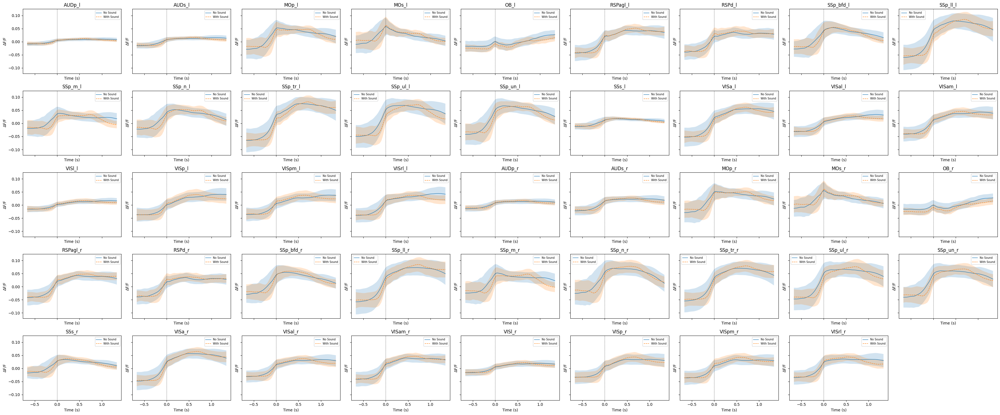

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from math import ceil
from pathlib import Path

# --- データ読み込み ---
csv_path = Path('/content/drive/MyDrive/VG1GC-105/VG1GC-105/task-day8/trials_L1L2.csv')
trials = pd.read_csv(csv_path)

dataroot = Path('/content/drive/MyDrive/braidyn-bc/data')
testfile = dataroot / "VG1GC-105" / "VG1GC-105_2024-02-02_task-day8.nwb"
session = nwbx.read_nwb(testfile)
all_rois = session.imaging.data
imaging_t = all_rois.index.to_numpy()

# --- イベント時刻を２条件でつくる ---
# 音無し： state_task==0, diff_value>0.4 → lever_time_nocue
f_ns = trials[(trials['state_task']==0) & (trials['diff_value']>0.4)].copy()
f_ns['event_time'] = f_ns['t'] - f_ns['diff_value']

# 音有り： reaction_time の閾内試行 → pull_onset
f_s  = trials.dropna(subset=['trial_outcome'])
f_s  = f_s[(f_s['first_diff']>1.0)
           & (f_s['reaction_time']>0.091)
           & (f_s['reaction_time']<0.361)].copy()
f_s['event_time'] = f_s['pull_onset']

# --- ウィンドウ定義 ---
pre_samps  = 20   # pull 前サンプル数
post_samps = 40   # pull 後サンプル数
wnd_len    = pre_samps + post_samps + 1
fs         = 30   # Hz（実データに合わせて）
time_axis  = (np.arange(wnd_len) - pre_samps) / fs

# --- ROIごとに試行データをためる ---
def collect_trials(event_times):
    d = {roi: [] for roi in all_rois.columns}
    for t0 in event_times:
        idx0 = np.searchsorted(imaging_t, t0)
        start, end = idx0-pre_samps, idx0+post_samps
        if start<0 or end>=len(imaging_t): continue
        win = all_rois.iloc[start:end+1]
        for roi in all_rois.columns:
            d[roi].append(win[roi].values)
    return d

trials_ns = collect_trials(f_ns['event_time'])
trials_s  = collect_trials(f_s['event_time'])

# --- 平均・SD を計算 ---
mean_ns, std_ns = {}, {}
mean_s,  std_s  = {}, {}
for roi in all_rois.columns:
    if trials_ns[roi]:
        arr = np.stack(trials_ns[roi])
        mean_ns[roi] = arr.mean(0)
        std_ns[roi]  = arr.std(0)
    if trials_s[roi]:
        arr = np.stack(trials_s[roi])
        mean_s[roi] = arr.mean(0)
        std_s[roi]  = arr.std(0)

# --- 描画 ---
rois = list(mean_ns.keys())  # 両方ある ROI のみなら filter してもOK
n = len(rois)
cols = 9
rows = ceil(n/cols)
fig, axes = plt.subplots(rows, cols, figsize=(cols*4, rows*3), sharex=True, sharey=True)
axes = axes.flatten()

for ax, roi in zip(axes, rois):
    # 音無し
    ax.plot(time_axis, mean_ns[roi], label='No Sound', linewidth=1)
    ax.fill_between(time_axis,
                    mean_ns[roi]-std_ns[roi],
                    mean_ns[roi]+std_ns[roi],
                    alpha=0.2)
    # 音有り
    ax.plot(time_axis, mean_s[roi], label='With Sound', linestyle='--', linewidth=1)
    ax.fill_between(time_axis,
                    mean_s[roi]-std_s[roi],
                    mean_s[roi]+std_s[roi],
                    alpha=0.2)
    ax.axvline(0, color='k', linestyle=':', linewidth=0.8)
    ax.set_title(roi)
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('ΔF/F')
    ax.legend(fontsize='x-small')

# 余分なサブプロットをオフ
for ax in axes[n:]:
    ax.axis('off')

plt.tight_layout()
plt.show()


##音あり成功、音あり失敗、音無しの三つを図示
三パターンの活動の違いを可視化した。
音あり試行の抽出法も変化させた

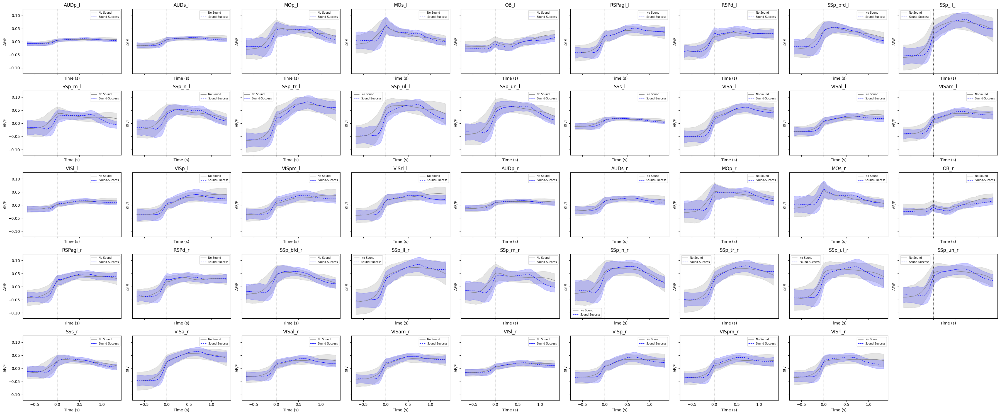

In [ ]:
# # --- データ読み込み ---
# csv_path = Path('/content/drive/MyDrive/VG1GC-105/VG1GC-105/task-day8/trials_L1L2.csv')
# trials = pd.read_csv(csv_path)

# dataroot = Path('/content/drive/MyDrive/braidyn-bc/data')
# testfile = dataroot / "VG1GC-105" / "VG1GC-105_2024-02-02_task-day8.nwb"
# session = nwbx.read_nwb(testfile)
# all_rois = session.imaging.data
# imaging_t = all_rois.index.to_numpy()

# # --- イベント時刻を２条件でつくる ---
# # 音無し： state_task==0, diff_value>0.4 → lever_time_nocue
# f_ns = trials[(trials['state_task']==0) & (trials['diff_value']>0.4)].copy()
# f_ns['event_time'] = f_ns['t'] - f_ns['diff_value']

# # 音有り： reaction_time の閾内試行 → pull_onset
# f_s  = trials.dropna(subset=['trial_outcome'])
# f_s  = f_s[(f_s['first_diff']>1.0)
#            & (f_s['reaction_time']>0.091)
#            & (f_s['reaction_time']<0.361)].copy()
# f_s['event_time'] = f_s['pull_onset']

#音あり成功、音あり失敗、音無し失敗
# --- 音あり trial_outcome ごとに分割 ---
f_s_success = f_s[f_s['trial_outcome'] == 'success']
f_s_miss    = f_s[f_s['trial_outcome'] == 'miss']

# --- それぞれの時系列を収集 ---
trials_ns        = collect_trials(f_ns['event_time'])           # 音なし
trials_s_success = collect_trials(f_s_success['event_time'])    # 音あり・成功
trials_s_miss    = collect_trials(f_s_miss['event_time'])        # 音あり・失敗

# --- 平均・SD を計算 ---
mean_ns, std_ns = {}, {}
mean_s_succ, std_s_succ = {}, {}
mean_s_miss, std_s_miss = {}, {}

for roi in all_rois.columns:
    if trials_ns[roi]:
        arr = np.stack(trials_ns[roi])
        mean_ns[roi] = arr.mean(0)
        std_ns[roi]  = arr.std(0)
    if trials_s_success[roi]:
        arr = np.stack(trials_s_success[roi])
        mean_s_succ[roi] = arr.mean(0)
        std_s_succ[roi]  = arr.std(0)
    if trials_s_miss[roi]:
        arr = np.stack(trials_s_miss[roi])
        mean_s_miss[roi] = arr.mean(0)
        std_s_miss[roi]  = arr.std(0)

# --- 描画 ---
rois = list(mean_ns.keys())
n = len(rois)
cols = 9
rows = ceil(n/cols)
fig, axes = plt.subplots(rows, cols, figsize=(cols*4, rows*3), sharex=True, sharey=True)
axes = axes.flatten()

for ax, roi in zip(axes, rois):
    # 音なし
    if roi in mean_ns:
        ax.plot(time_axis, mean_ns[roi], label='No Sound', color='gray', linewidth=1)
        ax.fill_between(time_axis,
                        mean_ns[roi]-std_ns[roi],
                        mean_ns[roi]+std_ns[roi],
                        alpha=0.2, color='gray')
    # 音あり・成功
    if roi in mean_s_succ:
        ax.plot(time_axis, mean_s_succ[roi], label='Sound-Success', color='blue', linestyle='--', linewidth=1)
        ax.fill_between(time_axis,
                        mean_s_succ[roi]-std_s_succ[roi],
                        mean_s_succ[roi]+std_s_succ[roi],
                        alpha=0.2, color='blue')
    # 音あり・失敗
    if roi in mean_s_miss:
        ax.plot(time_axis, mean_s_miss[roi], label='Sound-Miss', color='red', linestyle='--', linewidth=1)
        ax.fill_between(time_axis,
                        mean_s_miss[roi]-std_s_miss[roi],
                        mean_s_miss[roi]+std_s_miss[roi],
                        alpha=0.2, color='red')

    ax.axvline(0, color='k', linestyle=':', linewidth=0.8)
    ax.set_title(roi)
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('ΔF/F')
    ax.legend(fontsize='x-small')

# 余分なサブプロット非表示
for ax in axes[n:]:
    ax.axis('off')

plt.tight_layout()
plt.show()



In [ ]:
# 音有り： reaction_time の閾内試行 → pull_onset
f_s_raw  = trials.dropna(subset=['trial_outcome'])
f_s_raw  = f_s_raw.copy()
f_s_raw['event_time'] = f_s_raw['pull_onset']

In [ ]:
len(f_s_raw[f_s_raw['trial_outcome']=='miss'])

20

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


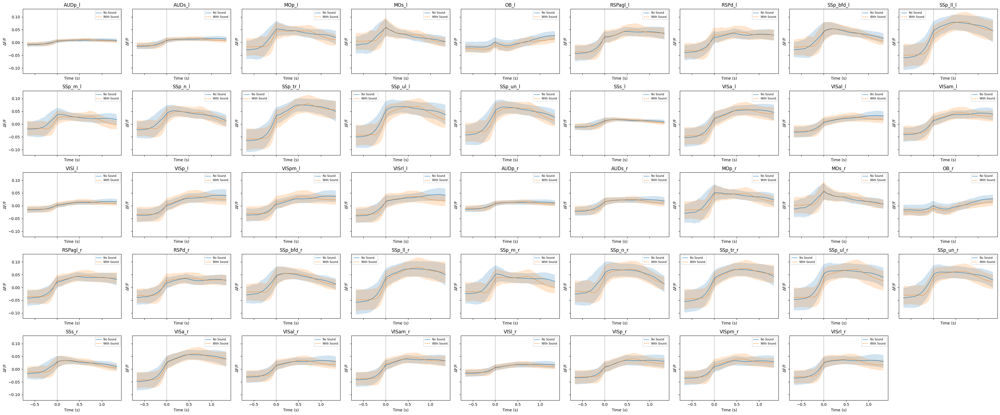

In [ ]:
#音あり試行を条件付け抽出せずに図示
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from math import ceil
from pathlib import Path

# # --- データ読み込み ---
# csv_path = Path('/content/drive/MyDrive/VG1GC-105/VG1GC-105/task-day8/trials_L1L2.csv')
# trials = pd.read_csv(csv_path)

# dataroot = Path('/content/drive/MyDrive/braidyn-bc/data')
# testfile = dataroot / "VG1GC-105" / "VG1GC-105_2024-02-02_task-day8.nwb"
# session = nwbx.read_nwb(testfile)
# all_rois = session.imaging.data
# imaging_t = all_rois.index.to_numpy()

# --- イベント時刻を２条件でつくる ---
# 音無し： state_task==0, diff_value>0.4 → lever_time_nocue
f_ns = trials[(trials['state_task']==0) & (trials['diff_value']>0.4)].copy()
f_ns['event_time'] = f_ns['t'] - f_ns['diff_value']


# --- ウィンドウ定義 ---
pre_samps  = 20   # pull 前サンプル数
post_samps = 40   # pull 後サンプル数
wnd_len    = pre_samps + post_samps + 1
fs         = 30   # Hz（実データに合わせて）
time_axis  = (np.arange(wnd_len) - pre_samps) / fs

# --- ROIごとに試行データをためる ---
def collect_trials(event_times):
    d = {roi: [] for roi in all_rois.columns}
    for t0 in event_times:
        idx0 = np.searchsorted(imaging_t, t0)
        start, end = idx0-pre_samps, idx0+post_samps
        if start<0 or end>=len(imaging_t): continue
        win = all_rois.iloc[start:end+1]
        for roi in all_rois.columns:
            d[roi].append(win[roi].values)
    return d

trials_ns = collect_trials(f_ns['event_time'])
trials_s  = collect_trials(f_s_raw['event_time'])

# --- 平均・SD を計算 ---
mean_ns, std_ns = {}, {}
mean_s,  std_s  = {}, {}
for roi in all_rois.columns:
    if trials_ns[roi]:
        arr = np.stack(trials_ns[roi])
        mean_ns[roi] = arr.mean(0)
        std_ns[roi]  = arr.std(0)
    if trials_s[roi]:
        arr = np.stack(trials_s[roi])
        mean_s[roi] = arr.mean(0)
        std_s[roi]  = arr.std(0)

# --- 描画 ---
rois = list(mean_ns.keys())  # 両方ある ROI のみなら filter してもOK
n = len(rois)
cols = 9
rows = ceil(n/cols)
fig, axes = plt.subplots(rows, cols, figsize=(cols*4, rows*3), sharex=True, sharey=True)
axes = axes.flatten()

for ax, roi in zip(axes, rois):
    # 音無し
    ax.plot(time_axis, mean_ns[roi], label='No Sound', linewidth=1)
    ax.fill_between(time_axis,
                    mean_ns[roi]-std_ns[roi],
                    mean_ns[roi]+std_ns[roi],
                    alpha=0.2)
    # 音有り
    ax.plot(time_axis, mean_s[roi], label='With Sound', linestyle='--', linewidth=1)
    ax.fill_between(time_axis,
                    mean_s[roi]-std_s[roi],
                    mean_s[roi]+std_s[roi],
                    alpha=0.2)
    ax.axvline(0, color='k', linestyle=':', linewidth=0.8)
    ax.set_title(roi)
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('ΔF/F')
    ax.legend(fontsize='x-small')

# 余分なサブプロットをオフ
for ax in axes[n:]:
    ax.axis('off')

plt.tight_layout()
plt.show()


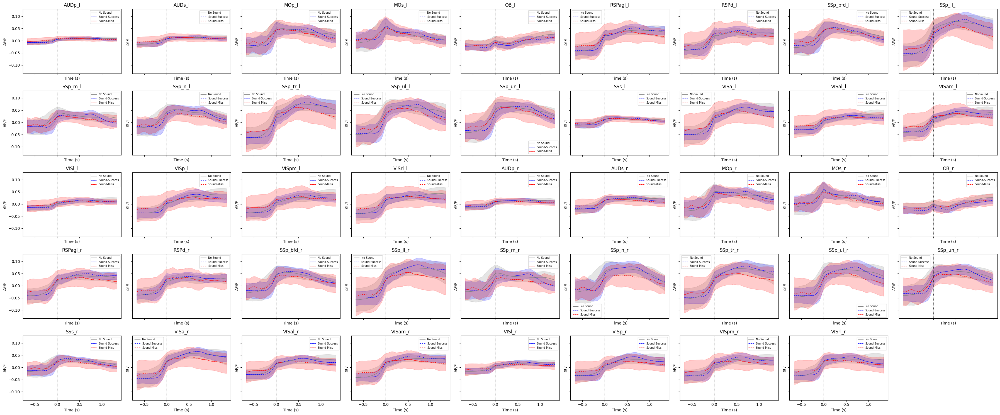

In [ ]:
#音あり成功、音あり失敗、失敗
# --- 音あり trial_outcome ごとに分割 ---
f_s_success = f_s_raw[f_s_raw['trial_outcome'] == 'success']
f_s_miss    = f_s_raw[f_s_raw['trial_outcome'] == 'miss']

# --- それぞれの時系列を収集 ---
trials_ns        = collect_trials(f_ns['event_time'])           # 音なし
trials_s_success = collect_trials(f_s_success['event_time'])    # 音あり・成功
trials_s_miss    = collect_trials(f_s_miss['event_time'])        # 音あり・失敗

# --- 平均・SD を計算 ---
mean_ns, std_ns = {}, {}
mean_s_succ, std_s_succ = {}, {}
mean_s_miss, std_s_miss = {}, {}

for roi in all_rois.columns:
    if trials_ns[roi]:
        arr = np.stack(trials_ns[roi])
        mean_ns[roi] = arr.mean(0)
        std_ns[roi]  = arr.std(0)
    if trials_s_success[roi]:
        arr = np.stack(trials_s_success[roi])
        mean_s_succ[roi] = arr.mean(0)
        std_s_succ[roi]  = arr.std(0)
    if trials_s_miss[roi]:
        arr = np.stack(trials_s_miss[roi])
        mean_s_miss[roi] = arr.mean(0)
        std_s_miss[roi]  = arr.std(0)

# --- 描画 ---
rois = list(mean_ns.keys())
n = len(rois)
cols = 9
rows = ceil(n/cols)
fig, axes = plt.subplots(rows, cols, figsize=(cols*4, rows*3), sharex=True, sharey=True)
axes = axes.flatten()

for ax, roi in zip(axes, rois):
    # 音なし
    if roi in mean_ns:
        ax.plot(time_axis, mean_ns[roi], label='No Sound', color='gray', linewidth=1)
        ax.fill_between(time_axis,
                        mean_ns[roi]-std_ns[roi],
                        mean_ns[roi]+std_ns[roi],
                        alpha=0.2, color='gray')
    # 音あり・成功
    if roi in mean_s_succ:
        ax.plot(time_axis, mean_s_succ[roi], label='Sound-Success', color='blue', linestyle='--', linewidth=1)
        ax.fill_between(time_axis,
                        mean_s_succ[roi]-std_s_succ[roi],
                        mean_s_succ[roi]+std_s_succ[roi],
                        alpha=0.2, color='blue')
    # 音あり・失敗
    if roi in mean_s_miss:
        ax.plot(time_axis, mean_s_miss[roi], label='Sound-Miss', color='red', linestyle='--', linewidth=1)
        ax.fill_between(time_axis,
                        mean_s_miss[roi]-std_s_miss[roi],
                        mean_s_miss[roi]+std_s_miss[roi],
                        alpha=0.2, color='red')

    ax.axvline(0, color='k', linestyle=':', linewidth=0.8)
    ax.set_title(roi)
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('ΔF/F')
    ax.legend(fontsize='x-small')

# 余分なサブプロット非表示
for ax in axes[n:]:
    ax.axis('off')

plt.tight_layout()
plt.show()



##音への反応を可視化
前までfailureを機器のエラーによるNAと理解していたが、
マウスがレバーを引かなかったものと理解して修正した

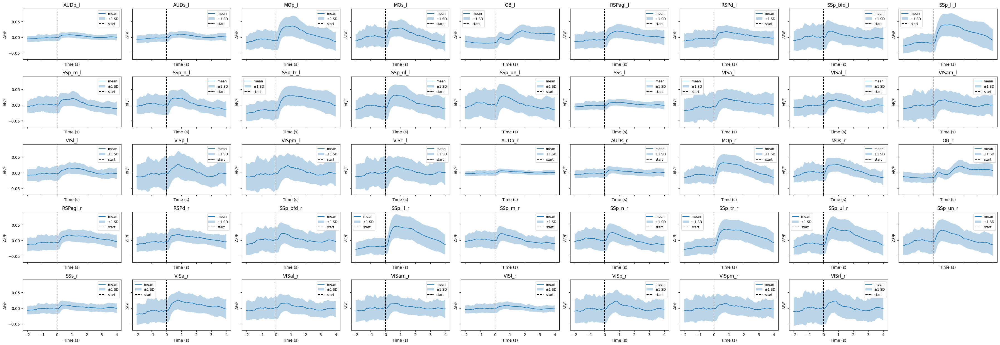

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from math import ceil

# # --- データ読み込み ---
# csv_path = Path('/content/drive/MyDrive/VG1GC-105/VG1GC-105/task-day8/trials_L1L2.csv')
# trials = pd.read_csv(csv_path)

# dataroot = Path('/content/drive/MyDrive/braidyn-bc/data')
# testfile = dataroot / "VG1GC-105" / "VG1GC-105_2024-02-02_task-day8.nwb"
# session = nwbx.read_nwb(testfile)
# all_rois = session.imaging.data
# imaging_t = all_rois.index.to_numpy()

# === パラメータ ===
fs = 30  # 30Hz
pre_time  = 2.0  # 開始前 2秒
post_time = 4.0  # 終了後 4秒
pre_samples  = int(pre_time * fs)
post_samples = int(post_time * fs)
window_len = pre_samples + post_samples + 1
time_axis = (np.arange(window_len) - pre_samples) / fs

# === データ取得 ===
all_rois = session.imaging.data            # index: 時間（秒）, columns: ROI
trial_df = session.trials.data             # DataFrame: 各試行の情報
imaging_t = all_rois.index.to_numpy()      # NumPy配列化して検索高速化

# === ROIごとに試行ごとの時系列を保存 ===
roi_trials = {roi: [] for roi in all_rois.columns}

for trial_start in trial_df['start_time']:
    idx0 = np.searchsorted(imaging_t, trial_start)
    start_idx = idx0 - pre_samples
    end_idx   = idx0 + post_samples
    if start_idx < 0 or end_idx >= len(imaging_t):
        continue  # 範囲外はスキップ
    window = all_rois.iloc[start_idx:end_idx+1]
    for roi in all_rois.columns:
        roi_trials[roi].append(window[roi].values)

# === 平均と標準偏差を計算 ===
roi_mean = {}
roi_std = {}
for roi, trial_list in roi_trials.items():
    if len(trial_list) == 0:
        continue
    arr = np.stack(trial_list)  # shape = (n_trials, window_len)
    roi_mean[roi] = np.nanmean(arr, axis=0)
    roi_std[roi]  = np.nanstd(arr, axis=0)

# === サブプロット表示 ===
n_rois = len(roi_mean)
n_cols = 9
n_rows = ceil(n_rois / n_cols)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*4, n_rows*2.5), sharex=True, sharey=True)
axes = axes.flatten()

for ax, roi in zip(axes, roi_mean.keys()):
    ax.plot(time_axis, roi_mean[roi], label='mean')
    ax.fill_between(time_axis,
                    roi_mean[roi] - roi_std[roi],
                    roi_mean[roi] + roi_std[roi],
                    alpha=0.3, label='±1 SD')
    ax.axvline(0, color='k', linestyle='--', label='start')
    ax.set_title(roi)
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('ΔF/F')
    ax.legend(fontsize='small')

# 残りの空白サブプロットを非表示
for ax in axes[n_rois:]:
    ax.axis('off')

plt.tight_layout()
plt.show()


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


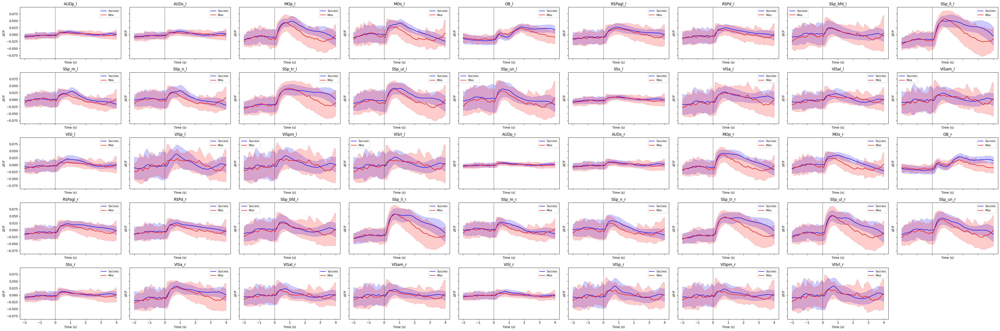

In [ ]:
#１個体の音への反応の違い
import numpy as np
import matplotlib.pyplot as plt
from math import ceil

# dataroot = Path('/content/drive/MyDrive/braidyn-bc/data')
# testfile = dataroot / "VG1GC-105" / "VG1GC-105_2024-02-02_task-day8.nwb"
session = nwbx.read_nwb('/content/drive/MyDrive/braidyn-bc/data/VG1GC-51/VG1GC-51_2023-06-26_task-day8.nwb')

# === パラメータ ===
fs = 30
pre_time  = 2.0  # 開始前2秒
post_time = 4.0  # 終了後4秒
pre_samples  = int(pre_time * fs)
post_samples = int(post_time * fs)
window_len = pre_samples + post_samples + 1
time_axis = (np.arange(window_len) - pre_samples) / fs

# === データ取得 ===
all_rois = session.imaging.data
trial_df = session.trials.data
imaging_t = all_rois.index.to_numpy()

# === 成功/失敗で分けた試行ごとのデータ保存用辞書 ===
roi_trials_success = {roi: [] for roi in all_rois.columns}
roi_trials_fail    = {roi: [] for roi in all_rois.columns}

for idx, trial_start in enumerate(trial_df['start_time']):
    outcome = trial_df['trial_outcome'].iloc[idx]
    idx0 = np.searchsorted(imaging_t, trial_start)
    start_idx = idx0 - pre_samples
    end_idx   = idx0 + post_samples
    if start_idx < 0 or end_idx >= len(imaging_t):
        continue
    window = all_rois.iloc[start_idx:end_idx+1]
    for roi in all_rois.columns:
        if outcome == 'success' :
            roi_trials_success[roi].append(window[roi].values)
        elif outcome == 'miss' :
            roi_trials_fail[roi].append(window[roi].values)

# === 平均・標準偏差を計算 ===
roi_mean_succ, roi_std_succ = {}, {}
roi_mean_fail, roi_std_fail = {}, {}

for roi in all_rois.columns:
    # 成功
    if roi_trials_success[roi]:
        arr = np.stack(roi_trials_success[roi])
        roi_mean_succ[roi] = np.nanmean(arr, axis=0)
        roi_std_succ[roi]  = np.nanstd(arr, axis=0)
    # 失敗
    if roi_trials_fail[roi]:
        arr = np.stack(roi_trials_fail[roi])
        roi_mean_fail[roi] = np.nanmean(arr, axis=0)
        roi_std_fail[roi]  = np.nanstd(arr, axis=0)

# === プロット ===
n_rois = len(all_rois.columns)
n_cols = 9
n_rows = ceil(n_rois / n_cols)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*5, n_rows*3), sharex=True, sharey=True)
axes = axes.flatten()

for ax, roi in zip(axes, all_rois.columns):
    has_data = False
    if roi in roi_mean_succ:
        m, s = roi_mean_succ[roi], roi_std_succ[roi]
        ax.plot(time_axis, m, label='Success', color='blue')
        ax.fill_between(time_axis, m - s, m + s, alpha=0.2, color='blue')
        has_data = True
    if roi in roi_mean_fail:
        m, s = roi_mean_fail[roi], roi_std_fail[roi]
        ax.plot(time_axis, m, label='Miss', color='red')
        ax.fill_between(time_axis, m - s, m + s, alpha=0.2, color='red')
        has_data = True
    if has_data:
        ax.axvline(0, color='k', linestyle='--', linewidth=0.8)
        ax.set_title(roi)
        ax.set_xlabel('Time (s)')
        ax.set_ylabel('ΔF/F')
        ax.legend(fontsize='small')
    else:
        ax.axis('off')  # データが全く無ければ非表示

for ax in axes[n_rois:]:
    ax.axis('off')

plt.tight_layout()
plt.show()


0it [00:00, ?it/s]/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
1it [00:39, 39.79s/it]/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
2it [01:07, 32.86s/it]/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
3it [01:34, 30.08s/it]/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because versio

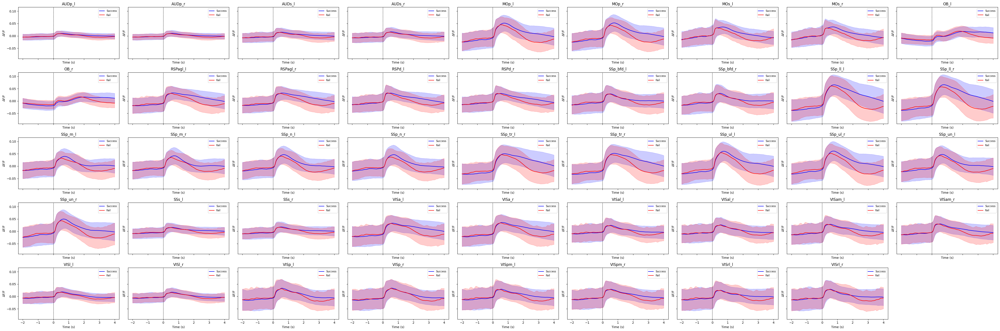

In [ ]:
#全個体の音への反応の違い
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from math import ceil
from pathlib import Path
from tqdm import tqdm

# === パラメータ ===
fs = 30
pre_time = 2.0
post_time = 4.0
pre_samples = int(pre_time * fs)
post_samples = int(post_time * fs)
window_len = pre_samples + post_samples + 1
time_axis = (np.arange(window_len) - pre_samples) / fs

# === 入力ルートパス ===
root = Path("/content/drive/MyDrive/braidyn-bc/data")

# === ROI単位の全セッションデータ ===
roi_trials_success_all = {}
roi_trials_fail_all = {}

# === ファイルを再帰的に検索し、処理 ===
for file in tqdm(root.rglob("*task-day8.nwb")):
    try:
        session = nwbx.read_nwb(file)
        all_rois = session.imaging.data
        trial_df = session.trials.data
        imaging_t = all_rois.index.to_numpy()

        for idx, row in trial_df.iterrows():
            outcome = row["trial_outcome"]
            trial_start = row["start_time"]
            idx0 = np.searchsorted(imaging_t, trial_start)
            start_idx = idx0 - pre_samples
            end_idx = idx0 + post_samples
            if start_idx < 0 or end_idx >= len(imaging_t):
                continue
            window = all_rois.iloc[start_idx:end_idx+1]
            for roi in all_rois.columns:
                if outcome == "success":
                    roi_trials_success_all.setdefault(roi, []).append(window[roi].values)
                elif outcome == "miss":
                    roi_trials_fail_all.setdefault(roi, []).append(window[roi].values)

    except Exception as e:
        print(f"スキップ: {file.name} ({e})")

# === 各ROIについて平均・標準偏差を計算 ===
roi_mean_succ, roi_std_succ = {}, {}
roi_mean_fail, roi_std_fail = {}, {}

all_rois_set = set(roi_trials_success_all.keys()).union(roi_trials_fail_all.keys())

for roi in all_rois_set:
    if roi in roi_trials_success_all:
        arr = np.stack(roi_trials_success_all[roi])
        roi_mean_succ[roi] = np.nanmean(arr, axis=0)
        roi_std_succ[roi]  = np.nanstd(arr, axis=0)
    if roi in roi_trials_fail_all:
        arr = np.stack(roi_trials_fail_all[roi])
        roi_mean_fail[roi] = np.nanmean(arr, axis=0)
        roi_std_fail[roi]  = np.nanstd(arr, axis=0)

# === プロット ===
n_rois = len(all_rois_set)
n_cols = 9
n_rows = ceil(n_rois / n_cols)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*5, n_rows*3), sharex=True, sharey=True)
axes = axes.flatten()

for ax, roi in zip(axes, sorted(all_rois_set)):
    has_data = False
    if roi in roi_mean_succ:
        m, s = roi_mean_succ[roi], roi_std_succ[roi]
        ax.plot(time_axis, m, label='Success', color='blue')
        ax.fill_between(time_axis, m - s, m + s, alpha=0.2, color='blue')
        has_data = True
    if roi in roi_mean_fail:
        m, s = roi_mean_fail[roi], roi_std_fail[roi]
        ax.plot(time_axis, m, label='Fail', color='red')
        ax.fill_between(time_axis, m - s, m + s, alpha=0.2, color='red')
        has_data = True
    if has_data:
        ax.axvline(0, color='k', linestyle='--', linewidth=0.8)
        ax.set_title(roi)
        ax.set_xlabel('Time (s)')
        ax.set_ylabel('ΔF/F')
        ax.legend(fontsize='small')
    else:
        ax.axis('off')

for ax in axes[n_rois:]:
    ax.axis('off')

plt.tight_layout()
plt.show()


1it [00:03,  3.34s/it]


--- 処理中: VG1GC-53_2023-06-26_task-day8.nwb (マウスID: 053) ---


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
2it [01:06, 38.47s/it]

  ROI数: 44, 試行数: 211, Imaging長: 54000
  有効試行数: 211, スキップ試行数: 0

--- 処理中: VG1GC-51_2023-06-26_task-day8.nwb (マウスID: 051) ---


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
3it [01:53, 42.62s/it]

  ROI数: 44, 試行数: 203, Imaging長: 54000
  有効試行数: 203, スキップ試行数: 0

--- 処理中: VG1GC-61_2023-06-26_task-day8.nwb (マウスID: 061) ---


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)


  ROI数: 44, 試行数: 147, Imaging長: 54000


6it [02:25, 21.37s/it]

  有効試行数: 147, スキップ試行数: 0

--- 処理中: VG1GC-66_2023-08-30_task-day8.nwb (マウスID: 066) ---


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
7it [03:01, 24.83s/it]

  ROI数: 44, 試行数: 153, Imaging長: 54000
  有効試行数: 152, スキップ試行数: 1

--- 処理中: VG1GC-63_2023-08-30_task-day8.nwb (マウスID: 063) ---


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
13it [03:32, 11.58s/it]

  ROI数: 44, 試行数: 52, Imaging長: 54000
  有効試行数: 52, スキップ試行数: 0

--- 処理中: VG1GC-48_2023-08-30_task-day8.nwb (マウスID: 048) ---


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)


  ROI数: 44, 試行数: 182, Imaging長: 54000


14it [04:14, 15.83s/it]

  有効試行数: 182, スキップ試行数: 0

--- 処理中: VG1GC-105_2024-02-02_task-day8.nwb (マウスID: 105) ---


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
15it [04:54, 19.82s/it]

  ROI数: 44, 試行数: 163, Imaging長: 54000
  有効試行数: 163, スキップ試行数: 0


25it [04:54, 11.78s/it]



=== 最終集計 ===
  Successに含まれるROI数: 44
  Failに含まれるROI数: 44


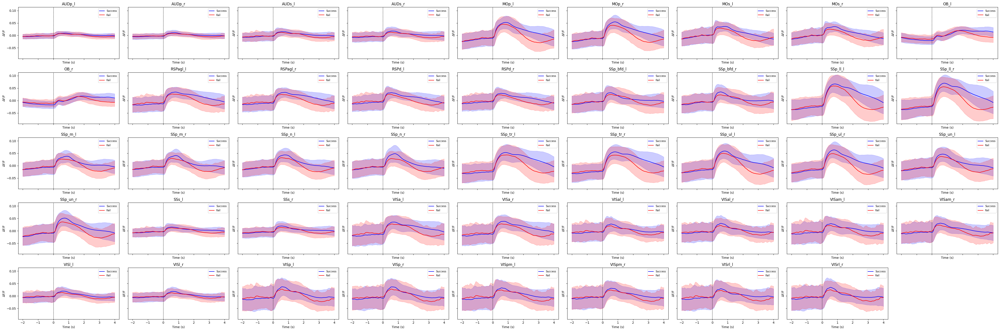

In [ ]:
#クラスタＡの音への反応の違い
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from math import ceil
from pathlib import Path
from tqdm import tqdm

# === パラメータ ===
fs = 30
pre_time = 2.0
post_time = 4.0
pre_samples = int(pre_time * fs)
post_samples = int(post_time * fs)
window_len = pre_samples + post_samples + 1
time_axis = (np.arange(window_len) - pre_samples) / fs

# === 入力ルートパス ===
root = Path("/content/drive/MyDrive/braidyn-bc/data")

# === ROI単位の全セッションデータ ===
roi_trials_success_all = {}
roi_trials_fail_all = {}

# === 対象マウスのリスト ===
target_mouse_ids = {"051", "053", "105", "063", "061", "066", "048"}

# === ファイルを再帰的に検索し、処理 ===
for file in tqdm(root.rglob("*task-day8.nwb")):
    mouse_id = file.parts[-2].split("-")[-1].zfill(3)
    if mouse_id not in target_mouse_ids:
        continue

    try:
        print(f"\n--- 処理中: {file.name} (マウスID: {mouse_id}) ---")
        session = nwbx.read_nwb(file)
        all_rois = session.imaging.data
        trial_df = session.trials.data
        imaging_t = all_rois.index.to_numpy()

        print(f"  ROI数: {len(all_rois.columns)}, 試行数: {len(trial_df)}, Imaging長: {len(imaging_t)}")

        skipped_counter = 0
        used_counter = 0

        for idx, row in trial_df.iterrows():
            outcome = row["trial_outcome"]
            trial_start = row["start_time"]
            idx0 = np.searchsorted(imaging_t, trial_start)
            start_idx = idx0 - pre_samples
            end_idx = idx0 + post_samples
            if start_idx < 0 or end_idx >= len(imaging_t):
                skipped_counter += 1
                continue

            window = all_rois.iloc[start_idx:end_idx+1]
            for roi in all_rois.columns:
                if outcome == "success":
                    roi_trials_success_all.setdefault(roi, []).append(window[roi].values)
                elif outcome == "miss":
                    roi_trials_fail_all.setdefault(roi, []).append(window[roi].values)
            used_counter += 1

        print(f"  有効試行数: {used_counter}, スキップ試行数: {skipped_counter}")

    except Exception as e:
        print(f"  スキップ: {file.name} | エラー: {e}")

# === 成功/失敗ごとのROI登録状況 ===
print(f"\n=== 最終集計 ===")
print(f"  Successに含まれるROI数: {len(roi_trials_success_all)}")
print(f"  Failに含まれるROI数: {len(roi_trials_fail_all)}")

# === （以下はプロット部分のまま）===

# === 各ROIについて平均・標準偏差を計算 ===
roi_mean_succ, roi_std_succ = {}, {}
roi_mean_fail, roi_std_fail = {}, {}

all_rois_set = set(roi_trials_success_all.keys()).union(roi_trials_fail_all.keys())

for roi in all_rois_set:
    if roi in roi_trials_success_all:
        arr = np.stack(roi_trials_success_all[roi])
        roi_mean_succ[roi] = np.nanmean(arr, axis=0)
        roi_std_succ[roi]  = np.nanstd(arr, axis=0)
    if roi in roi_trials_fail_all:
        arr = np.stack(roi_trials_fail_all[roi])
        roi_mean_fail[roi] = np.nanmean(arr, axis=0)
        roi_std_fail[roi]  = np.nanstd(arr, axis=0)

# === プロット ===
n_rois = len(all_rois_set)
n_cols = 9
n_rows = ceil(n_rois / n_cols)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*5, n_rows*3), sharex=True, sharey=True)
axes = axes.flatten()

for ax, roi in zip(axes, sorted(all_rois_set)):
    has_data = False
    if roi in roi_mean_succ:
        m, s = roi_mean_succ[roi], roi_std_succ[roi]
        ax.plot(time_axis, m, label='Success', color='blue')
        ax.fill_between(time_axis, m - s, m + s, alpha=0.2, color='blue')
        has_data = True
    if roi in roi_mean_fail:
        m, s = roi_mean_fail[roi], roi_std_fail[roi]
        ax.plot(time_axis, m, label='Fail', color='red')
        ax.fill_between(time_axis, m - s, m + s, alpha=0.2, color='red')
        has_data = True
    if has_data:
        ax.axvline(0, color='k', linestyle='--', linewidth=0.8)
        ax.set_title(roi)
        ax.set_xlabel('Time (s)')
        ax.set_ylabel('ΔF/F')
        ax.legend(fontsize='small')
    else:
        ax.axis('off')

for ax in axes[n_rois:]:
    ax.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
!pip install japanize_matplotlib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.1/4.1 MB 21.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for japanize_matplotlib: filename=japanize_matplotlib-1.1.3-py3-none-any.whl size=4120257 sha256=ff13db8944fe2b71c441a3a7ef5df7c90086c2ea11ef81d2c4a0279e97bfdf33
  Stored in directory: /root/.cache/pip/wheels/da/a1/71/b8faeb93276fed10edffcca20746f1ef6f8d9e071eee8425fc
Successfully built japanize_matplotlib


0it [00:00, ?it/s]/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
2it [00:47, 23.86s/it]/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
3it [01:31, 31.99s/it]/usr/local/lib/p

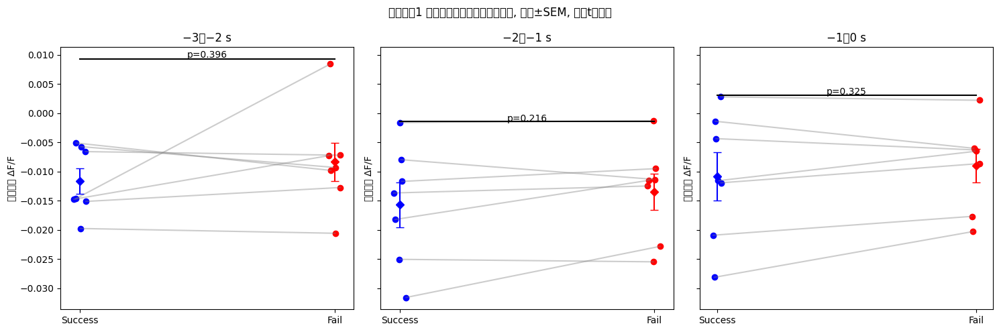

In [ ]:
#音前の活動を可視化、有意差計算（ave+std
import japanize_matplotlib
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from tqdm import tqdm
from scipy.stats import ttest_rel

# --------- パラメータ ---------
fs          = 30          # Hz
pre_time    = 3.0         # 解析したい前刺激時間（秒）
post_time   = 4.0         # 後刺激はそのまま
pre_samples = int(pre_time * fs)
post_samples= int(post_time * fs)

root = Path("/content/drive/MyDrive/braidyn-bc/data")
mouse_ids = ["051","053","105","063","061","066","048"]  # 可視化対象

# 1 秒区間を 3 つに分割（index スライス）
seg_slices = {
    'seg1': slice(0,   30),   # −3〜−2 s
    'seg2': slice(30,  60),   # −2〜−1 s
    'seg3': slice(60,  90)    # −1〜 0 s
}
seg_names  = {'seg1':'−3〜−2 s', 'seg2':'−2〜−1 s', 'seg3':'−1〜0 s'}

# --------- データ収集 ---------
vals = {seg: {'success': {}, 'fail': {}} for seg in seg_slices}

for file in tqdm(root.rglob("*task-day8.nwb")):
    mid = file.parts[-2].split("-")[-1].zfill(3)
    if mid not in mouse_ids:
        continue
    try:
        session   = nwbx.read_nwb(file)
        rois      = session.imaging.data           # (time, ROI)
        trials    = session.trials.data
        imaging_t = rois.index.to_numpy()

        for _, row in trials.iterrows():
            if row["trial_outcome"] not in ("success", "miss"):
                continue
            idx0 = np.searchsorted(imaging_t, row["start_time"])
            s, e = idx0 - pre_samples, idx0 + post_samples
            if s < 0 or e >= len(imaging_t):
                continue
            win = rois.iloc[s:e+1].mean(axis=1).values   # 全 ROI 平均

            for seg, sl in seg_slices.items():
                m = np.nanmean(win[sl])
                key = 'success' if row["trial_outcome"]=="success" else 'fail'
                vals[seg][key].setdefault(mid, []).append(m)
    except Exception as e:
        print(f"{mid}: {e}")

# --------- 可視化 ---------
fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharey=True)
for ax, seg in zip(axes, seg_slices):
    succ = []
    fail = []
    # ---- 個体ごとの平均 ----
    for mid in mouse_ids:
        s_list = vals[seg]['success'].get(mid, [])
        f_list = vals[seg]['fail'   ].get(mid, [])
        if s_list and f_list:         # 成功・失敗ともにデータあり
            succ.append(np.mean(s_list))
            fail.append(np.mean(f_list))
            # 点と線
            jitter = (np.random.rand()-0.5)*0.06
            ax.scatter(0+jitter, succ[-1], color='blue')
            ax.scatter(1+jitter, fail[-1], color='red')
            ax.plot([0+jitter,1+jitter], [succ[-1],fail[-1]], color='gray', alpha=0.4)

    # ---- グループ平均 ± SEM ----
    if succ and fail:
        sem = lambda x: np.std(x, ddof=1)/np.sqrt(len(x))
        ax.errorbar(0, np.mean(succ), yerr=sem(succ),
                    fmt='D', color='blue', capsize=4)
        ax.errorbar(1, np.mean(fail), yerr=sem(fail),
                    fmt='D', color='red',  capsize=4)
        # ---- 対応のある t 検定 ----
        t, p = ttest_rel(succ, fail)
        ymax = max(max(succ), max(fail))*1.1
        ax.plot([0,1], [ymax, ymax], color='k')
        ax.text(0.5, ymax*1.02, f"p={p:.3g}", ha='center')

    ax.set_xticks([0,1])
    ax.set_xticklabels(["Success","Fail"])
    ax.set_title(seg_names[seg])
    ax.set_ylabel("全脳平均 ΔF/F")

fig.suptitle("音提示前1 秒区間ごとの活動（各個体点, 平均±SEM, 対応t検定）")
plt.tight_layout()
plt.show()


1it [00:02,  2.78s/it]/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
2it [01:19, 46.02s/it]/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
3it [02:22, 54.12s/it]/usr/local/l

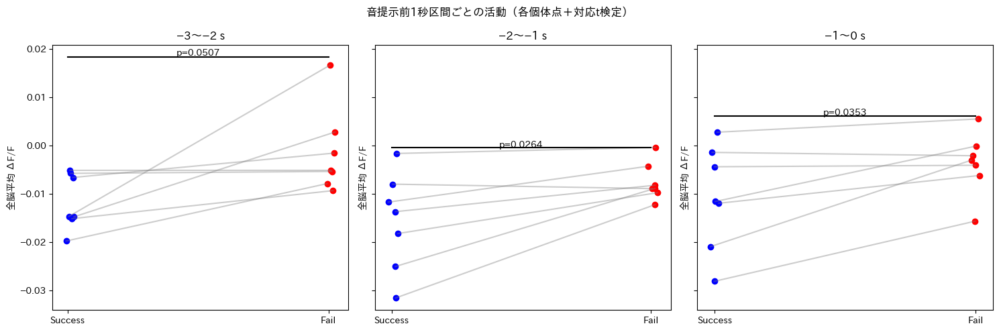

In [ ]:
#miss と failure の両方を「fail」に含めたver
import japanize_matplotlib
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from tqdm import tqdm
from scipy.stats import ttest_rel


# --------- パラメータ ---------
fs           = 30          # Hz
pre_time     = 3.0         # 解析したい前刺激時間（秒）
post_time    = 4.0         # 後刺激はそのまま
pre_samples  = int(pre_time * fs)
post_samples = int(post_time * fs)

root = Path("/content/drive/MyDrive/braidyn-bc/data")
mouse_ids = ["051","053","105","063","061","066","048"]  # 可視化対象

# 1 秒区間を 3 つに分割（index スライス）
seg_slices = {
    'seg1': slice(0,   30),   # −3〜−2 s
    'seg2': slice(30,  60),   # −2〜−1 s
    'seg3': slice(60,  90)    # −1〜 0 s
}
seg_names  = {'seg1':'−3〜−2 s', 'seg2':'−2〜−1 s', 'seg3':'−1〜0 s'}

# --------- データ収集 ---------
vals = {seg: {'success': {}, 'fail': {}} for seg in seg_slices}

for file in tqdm(root.rglob("*task-day8.nwb")):
    mid = file.parts[-2].split("-")[-1].zfill(3)
    if mid not in mouse_ids:
        continue
    session   = nwbx.read_nwb(file)
    rois      = session.imaging.data           # (time, ROI)
    trials    = session.trials.data
    imaging_t = rois.index.to_numpy()

    for _, row in trials.iterrows():
        # miss と failure の両方を「fail」に含める
        if row["trial_outcome"] not in ("success", "miss", "failure"):
            continue
        idx0 = np.searchsorted(imaging_t, row["start_time"])
        s, e = idx0 - pre_samples, idx0 + post_samples
        if s < 0 or e >= len(imaging_t):
            continue
        win = rois.iloc[s:e+1].mean(axis=1).values   # 全 ROI 平均

        for seg, sl in seg_slices.items():
            m = np.nanmean(win[sl])
            key = 'success' if row["trial_outcome"] == "success" else 'fail'
            vals[seg][key].setdefault(mid, []).append(m)

# --------- 可視化 ---------
fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharey=True)
for ax, seg in zip(axes, seg_slices):
    succ = []
    fail = []
    for mid in mouse_ids:
        s_list = vals[seg]['success'].get(mid, [])
        f_list = vals[seg]['fail'   ].get(mid, [])
        if s_list and f_list:
            succ.append(np.mean(s_list))
            fail.append(np.mean(f_list))
            jitter = (np.random.rand() - 0.5) * 0.06
            ax.scatter(0 + jitter, succ[-1], color='blue')
            ax.scatter(1 + jitter, fail[-1], color='red')
            ax.plot([0 + jitter, 1 + jitter], [succ[-1], fail[-1]], color='gray', alpha=0.4)

    # ---- 対応のある t 検定と p 値表示 ----
    if succ and fail:
        t, p = ttest_rel(succ, fail)
        ymax = max(max(succ), max(fail)) * 1.1
        ax.plot([0, 1], [ymax, ymax], color='k')
        ax.text(0.5, ymax * 1.02, f"p={p:.3g}", ha='center')

    ax.set_xticks([0, 1])
    ax.set_xticklabels(["Success", "Fail"])
    ax.set_title(seg_names[seg])
    ax.set_ylabel("全脳平均 ΔF/F")

fig.suptitle("音提示前1秒区間ごとの活動（各個体点＋対応t検定）")
plt.tight_layout()
plt.show()


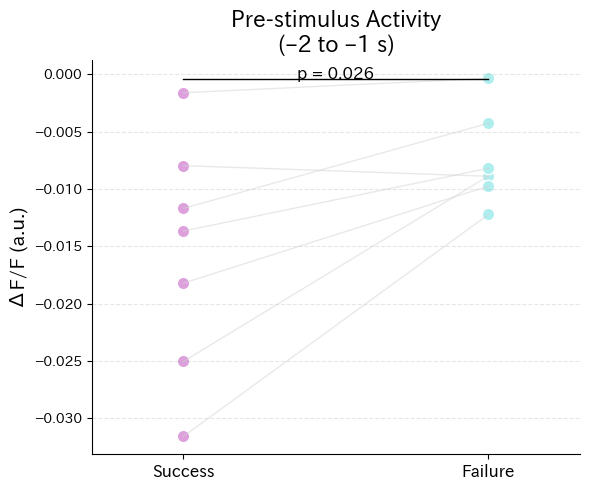

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import ttest_rel

# ---------- スタイリッシュな -2〜-1秒区間の可視化 ----------
seg = 'seg2'  # -2〜-1秒
# 個体ごとの平均を準備
succ_vals, fail_vals, pairs = [], [], []
for mid in mouse_ids:
    s = vals[seg]['success'].get(mid, [])
    f = vals[seg]['fail'   ].get(mid, [])
    if s and f:
        s_mean = np.mean(s)
        f_mean = np.mean(f)
        succ_vals.append(s_mean)
        fail_vals.append(f_mean)
        pairs.append((s_mean, f_mean))

# 対応のある t 検定
t_stat, p_val = ttest_rel(succ_vals, fail_vals)
# ↓ これをプロット直前に追加
pastel_success = 'plum'  # パステルブルー
pastel_failure = 'turquoise'  # パステルピーチ

# ---------- スタイリッシュな -2〜-1秒区間の可視化 ----------
fig, ax = plt.subplots(figsize=(6, 5))

# 個体間を結ぶ薄いグレーの線
for s_mean, f_mean in pairs:
    ax.plot([0, 1], [s_mean, f_mean], color='lightgray', alpha=0.5, linewidth=1)

# パステルカラーの点
ax.scatter([0]*len(succ_vals), succ_vals,
           color=pastel_success, edgecolors='white', s=80, label='Success')
ax.scatter([1]*len(fail_vals), fail_vals,
           color=pastel_failure, edgecolors='white', s=80, label='Failure')

# p 値のアノテーション
ymax = max(max(succ_vals), max(fail_vals)) * 1.1
ax.plot([0, 1], [ymax, ymax], color='black', linewidth=1)
ax.text(0.5, ymax * 1.02, f'p = {p_val:.3f}', ha='center', fontsize=12)

# 軸とタイトルを英語ラベルに
ax.set_title('Pre-stimulus Activity\n(–2 to –1 s)', fontsize=16, fontweight='bold')
ax.set_xticks([0, 1])
ax.set_xticklabels(['Success', 'Failure'], fontsize=12)
ax.set_ylabel('ΔF/F (a.u.)', fontsize=14)
ax.set_xlim(-0.3, 1.3)

# 軸のスタイル
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.grid(axis='y', linestyle='--', alpha=0.3)

plt.tight_layout()
plt.show()


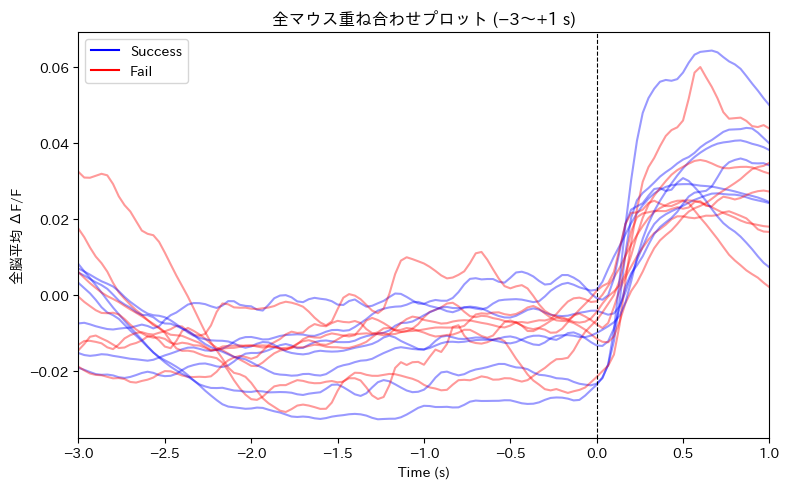

In [ ]:
#7個体の全脳音あり、なし平均を可視化
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from tqdm import tqdm


# ---------- 解析パラメータ ----------
fs           = 30          # imaging frame rate [Hz]
pre_time     = 3.0         # 試行開始前にさかのぼる時間 [s]
post_time    = 4.0         # 試行開始後に追跡する時間 [s]
pre_samples  = int(pre_time  * fs)
post_samples = int(post_time * fs)
win_len      = pre_samples + post_samples + 1
time_axis    = (np.arange(win_len) - pre_samples) / fs   # −3 s … 0 s … +4 s

root       = Path("/content/drive/MyDrive/braidyn-bc/data")
mouse_ids  = ["051","053","105","063","061","066","048"]   # 可視化したい個体

# ---------- 全 ROI 平均の時間波形を集める ----------
succ_traces = {mid: [] for mid in mouse_ids}
fail_traces = {mid: [] for mid in mouse_ids}

for file in tqdm(root.rglob("*task-day8.nwb")):
    mid = file.parts[-2].split("-")[-1].zfill(3)
    if mid not in mouse_ids:
        continue
    try:
        session   = nwbx.read_nwb(file)
        rois      = session.imaging.data             # DataFrame (time, ROI)
        trials    = session.trials.data
        imaging_t = rois.index.to_numpy()

        for _, row in trials.iterrows():
            if row["trial_outcome"] not in ("success","miss"):
                continue
            idx0 = np.searchsorted(imaging_t, row["start_time"])
            s, e = idx0 - pre_samples, idx0 + post_samples
            if s < 0 or e >= len(imaging_t):
                continue

            # 全 ROI 平均 → 1D 時系列
            trace = rois.iloc[s:e+1].mean(axis=1).values
            if len(trace) != win_len:     # 保険
                continue

            if row["trial_outcome"] == "success":
                succ_traces[mid].append(trace)
            else:
                fail_traces[mid].append(trace)
    except Exception as e:
        print(f"{mid}: {e}")

# ---------- 個体ごとに平均を計算 ----------
mouse_plot_data = {}
for mid in mouse_ids:
    s_list = np.stack(succ_traces[mid]) if succ_traces[mid] else None
    f_list = np.stack(fail_traces[mid]) if fail_traces[mid] else None
    s_mean = np.nanmean(s_list, axis=0) if s_list is not None else None
    f_mean = np.nanmean(f_list, axis=0) if f_list is not None else None
    mouse_plot_data[mid] = (s_mean, f_mean)

# ---------- 重ね合わせプロット（−3〜+1秒） ----------
xmin, xmax = -3, 1
mask = (time_axis >= xmin) & (time_axis <= xmax)

plt.figure(figsize=(8, 5))
# 凡例用のダミー
plt.plot([], [], color='blue', label='Success')
plt.plot([], [], color='red',  label='Fail')

for mid in mouse_ids:
    s_mean, f_mean = mouse_plot_data[mid]
    if s_mean is not None:
        plt.plot(time_axis[mask], s_mean[mask], color='blue', alpha=0.4)
    if f_mean is not None:
        plt.plot(time_axis[mask], f_mean[mask], color='red',  alpha=0.4)

plt.axvline(0, color='k', linestyle='--', linewidth=0.8)
plt.xlim(xmin, xmax)
plt.xlabel("Time (s)")
plt.ylabel("全脳平均 ΔF/F")
plt.title("全マウス重ね合わせプロット (−3〜+1 s)")
plt.legend()
plt.tight_layout()
plt.show()


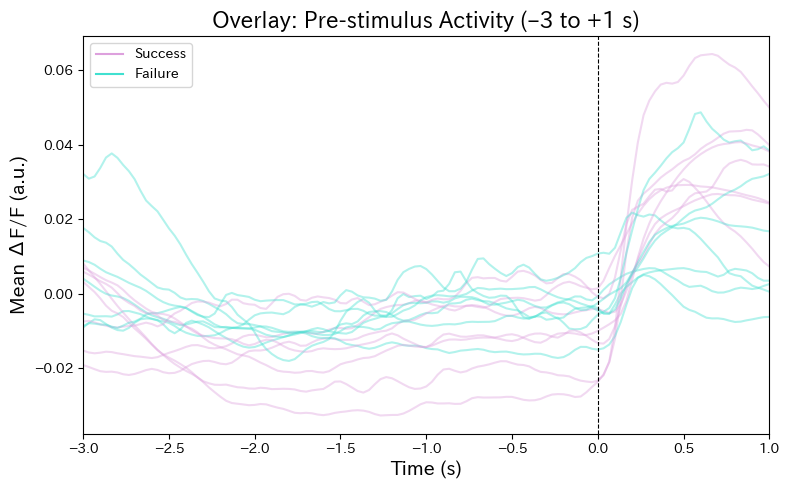

In [ ]:
#上のコードにfailure試行も加えて修正したもの

import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from tqdm import tqdm

# ---------- パラメータ ----------
fs           = 30
pre_time     = 3.0
post_time    = 4.0
pre_samples  = int(pre_time  * fs)
post_samples = int(post_time * fs)
win_len      = pre_samples + post_samples + 1
time_axis    = (np.arange(win_len) - pre_samples) / fs  # -3 … +4秒

root       = Path("/content/drive/MyDrive/braidyn-bc/data")
mouse_ids  = ["051","053","105","063","061","066","048"]


# ---------- データ収集 ----------
succ_traces = {mid: [] for mid in mouse_ids}
fail_traces = {mid: [] for mid in mouse_ids}

for file in tqdm(root.rglob("*task-day8.nwb")):
    mid = file.parts[-2].split("-")[-1].zfill(3)
    if mid not in mouse_ids:
        continue
    session   = nwbx.read_nwb(file)
    rois      = session.imaging.data
    trials    = session.trials.data
    times     = rois.index.to_numpy()

    for _, row in trials.iterrows():
        if row["trial_outcome"] not in ("success", "miss", "failure"):
            continue
        idx0 = np.searchsorted(times, row["start_time"])
        s, e = idx0 - pre_samples, idx0 + post_samples
        if s < 0 or e >= len(times):
            continue
        trace = rois.iloc[s:e+1].mean(axis=1).values
        if row["trial_outcome"] == "success":
            succ_traces[mid].append(trace)
        else:
            fail_traces[mid].append(trace)

# ---------- 個体平均計算 ----------
mouse_plot_data = {}
for mid in mouse_ids:
    s_arr = np.stack(succ_traces[mid]) if succ_traces[mid] else None
    f_arr = np.stack(fail_traces[mid]) if fail_traces[mid] else None
    s_mean = np.nanmean(s_arr, axis=0) if s_arr is not None else None
    f_mean = np.nanmean(f_arr, axis=0) if f_arr is not None else None
    mouse_plot_data[mid] = (s_mean, f_mean)

# ---------- 色設定（パステル調） ----------
color_success = 'plum'
color_failure = 'turquoise'
# ---------- プロット（重ね合わせ, -3～+1秒） ----------
xmin, xmax = -3, 1
mask = (time_axis >= xmin) & (time_axis <= xmax)

plt.figure(figsize=(8, 5))
plt.plot([], [], color=color_success, label='Success')
plt.plot([], [], color=color_failure, label='Failure')

for mid in mouse_ids:
    s_mean, f_mean = mouse_plot_data[mid]
    if s_mean is not None:
        plt.plot(time_axis[mask], s_mean[mask],
                 color=color_success, alpha=0.4)
    if f_mean is not None:
        plt.plot(time_axis[mask], f_mean[mask],
                 color=color_failure, alpha=0.4)

plt.axvline(0, color='k', linestyle='--', linewidth=0.8)
plt.xlim(xmin, xmax)
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Mean ΔF/F (a.u.)", fontsize=14)
plt.title("Overlay: Pre-stimulus Activity (–3 to +1 s)", fontsize=16)
plt.legend()
plt.tight_layout()
plt.show()


**↑failure vs success,missでレバー引き有無での活動の違いを見るのもいいかもしれない**

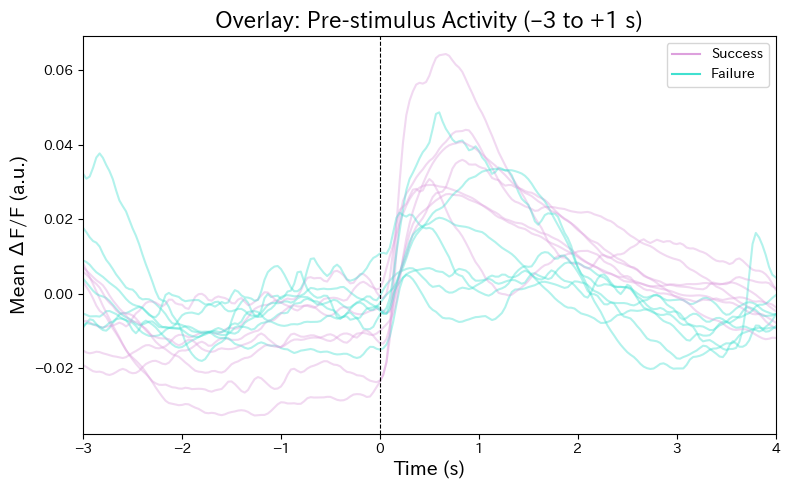

In [ ]:

# ---------- 個体平均計算 ----------
mouse_plot_data = {}
for mid in mouse_ids:
    s_arr = np.stack(succ_traces[mid]) if succ_traces[mid] else None
    f_arr = np.stack(fail_traces[mid]) if fail_traces[mid] else None
    s_mean = np.nanmean(s_arr, axis=0) if s_arr is not None else None
    f_mean = np.nanmean(f_arr, axis=0) if f_arr is not None else None
    mouse_plot_data[mid] = (s_mean, f_mean)

# ---------- 色設定（パステル調） ----------
color_success = 'plum'
color_failure = 'turquoise'
# ---------- プロット（重ね合わせ, -3～+1秒） ----------
xmin, xmax = -3, 4
mask = (time_axis >= xmin) & (time_axis <= xmax)

plt.figure(figsize=(8, 5))
plt.plot([], [], color=color_success, label='Success')
plt.plot([], [], color=color_failure, label='Failure')

for mid in mouse_ids:
    s_mean, f_mean = mouse_plot_data[mid]
    if s_mean is not None:
        plt.plot(time_axis[mask], s_mean[mask],
                 color=color_success, alpha=0.4)
    if f_mean is not None:
        plt.plot(time_axis[mask], f_mean[mask],
                 color=color_failure, alpha=0.4)

plt.axvline(0, color='k', linestyle='--', linewidth=0.8)
plt.xlim(xmin, xmax)
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Mean ΔF/F (a.u.)", fontsize=14)
plt.title("Overlay: Pre-stimulus Activity (–3 to +1 s)", fontsize=16)
plt.legend()
plt.tight_layout()
plt.show()


0it [00:00, ?it/s]/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
2it [01:00, 30.29s/it]/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
3it [01:57, 41.36s/it]/usr/local/lib/p

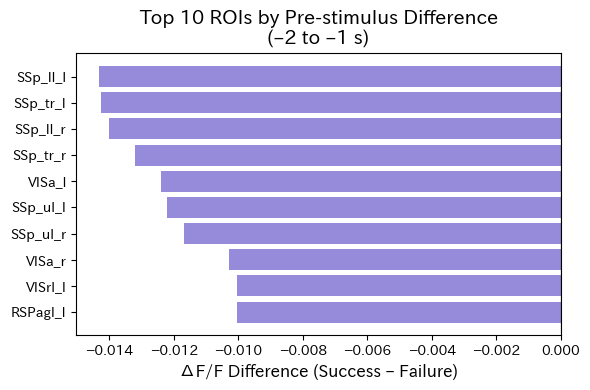

        ROI  mean_diff    t_stat     p_val
0  SSp_ll_l  -0.014322 -3.054596  0.022380
1  SSp_tr_l  -0.014252 -3.001672  0.023956
2  SSp_ll_r  -0.014023 -2.924679  0.026470
3  SSp_tr_r  -0.013197 -3.113534  0.020755
4    VISa_l  -0.012392 -3.158233  0.019609
5  SSp_ul_l  -0.012218 -2.511448  0.045813
6  SSp_ul_r  -0.011690 -2.523908  0.045049
7    VISa_r  -0.010288 -2.752022  0.033203
8   VISrl_l  -0.010051 -2.806791  0.030886
9  RSPagl_l  -0.010033 -3.214694  0.018259


In [ ]:
#FDRなしで、各脳領域の音の反応の有意差を確認（-2 ~ -1秒）。データ処理用として必要
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
from tqdm import tqdm
from scipy.stats import ttest_rel


# ---------- パラメータ ----------
fs           = 30
pre_time     = 3.0
post_time    = 4.0
pre_samples  = int(pre_time  * fs)
post_samples = int(post_time * fs)
win_len      = pre_samples + post_samples + 1
# −3…0…+4秒のうち −2～−1秒に対応するインデックス
seg2_slice   = slice(pre_samples - 2*fs, pre_samples - 1*fs)

root      = Path("/content/drive/MyDrive/braidyn-bc/data")
mouse_ids = ["051","053","105","063","061","066","048"]

# ---------- ROIごとのデータ収集 ----------
roi_vals = {}  # roi_vals[roi] = {'success': {mid: [means...]}, 'fail': {mid: [...]}}
for file in tqdm(root.rglob("*task-day8.nwb")):
    mid = file.parts[-2].split("-")[-1].zfill(3)
    if mid not in mouse_ids:
        continue

    session = nwbx.read_nwb(file)
    rois    = session.imaging.data       # DataFrame (time × ROI)
    trials  = session.trials.data
    times   = rois.index.to_numpy()

    for _, row in trials.iterrows():
        out = row["trial_outcome"]
        if out not in ("success","miss","failure"):
            continue
        idx0 = np.searchsorted(times, row["start_time"])
        s, e = idx0 - pre_samples, idx0 + post_samples
        if s<0 or e>=len(times):
            continue

        window = rois.iloc[s:e+1]          # shape (win_len × n_rois)
        for roi in rois.columns:
            trace = window[roi].values[seg2_slice].mean()
            key = 'success' if out=="success" else 'fail'
            roi_vals.setdefault(roi, {'success':{}, 'fail':{}}) \
                   [key].setdefault(mid, []).append(trace)

# ---------- ROIごとに t検定 & 効果量計算 ----------
results = []
for roi, grp in roi_vals.items():
    succ = []
    fail = []
    for mid in mouse_ids:
        if mid in grp['success'] and mid in grp['fail']:
            succ.append(np.mean(grp['success'][mid]))
            fail.append(np.mean(grp['fail'][mid]))
    if len(succ) > 1:
        t_stat, p_val = ttest_rel(succ, fail)
        diff = np.mean(succ) - np.mean(fail)
        results.append((roi, diff, t_stat, p_val))

# DataFrame にまとめて差の絶対値でソート
df = pd.DataFrame(results, columns=['ROI','mean_diff','t_stat','p_val'])
df['abs_diff'] = df['mean_diff'].abs()
df = df.sort_values('abs_diff', ascending=False).reset_index(drop=True)

# 上位 10 ROI をプロット
topn = 10
plt.figure(figsize=(6, topn*0.4))
bars = plt.barh(df['ROI'][:topn][::-1],
                df['mean_diff'][:topn][::-1],
                color='slateblue', alpha=0.7)
plt.axvline(0, color='k', linewidth=0.8)
plt.xlabel('ΔF/F Difference (Success – Failure)', fontsize=12)
plt.title(f'Top {topn} ROIs by Pre-stimulus Difference\n(–2 to –1 s)', fontsize=14)
plt.tight_layout()
plt.show()

# 結果テーブルを表示
print(df[['ROI','mean_diff','t_stat','p_val']].head(topn))


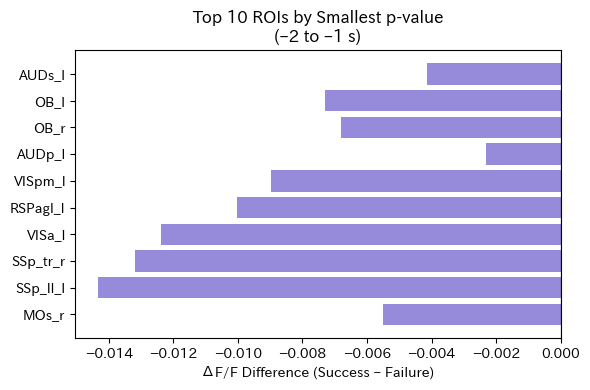

        ROI  mean_diff    t_stat     p_val
0    AUDs_l  -0.004149 -3.847801  0.008482
1      OB_l  -0.007297 -3.831190  0.008647
2      OB_r  -0.006792 -3.495185  0.012902
3    AUDp_l  -0.002327 -3.406012  0.014389
4   VISpm_l  -0.008983 -3.314447  0.016115
5  RSPagl_l  -0.010033 -3.214694  0.018259
6    VISa_l  -0.012392 -3.158233  0.019609
7  SSp_tr_r  -0.013197 -3.113534  0.020755
8  SSp_ll_l  -0.014322 -3.054596  0.022380
9     MOs_r  -0.005515 -3.013204  0.023603


In [ ]:
#ｐ値順に並べてる

df = pd.DataFrame(results, columns=['ROI','mean_diff','t_stat','p_val'])
# p値が小さい順にソート
df = df.sort_values('p_val', ascending=True).reset_index(drop=True)

# プロット（上位10領域）
topn = 10
plt.figure(figsize=(6, topn*0.4))
plt.barh(df['ROI'][:topn][::-1],
         df['mean_diff'][:topn][::-1],
         color='slateblue', alpha=0.7)
plt.axvline(0, color='k', linewidth=0.8)
plt.xlabel('ΔF/F Difference (Success – Failure)')
plt.title(f'Top {topn} ROIs by Smallest p-value\n(–2 to –1 s)')
plt.tight_layout()
plt.show()

# テーブル表示
print(df[['ROI','mean_diff','t_stat','p_val']].head(topn))


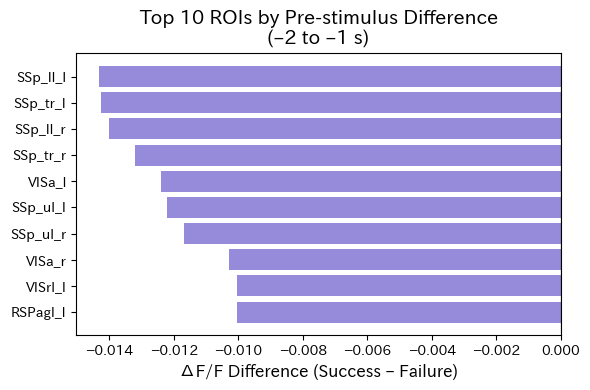

        ROI  mean_diff    t_stat     p_val
0  SSp_ll_l  -0.014322 -3.054596  0.022380
1  SSp_tr_l  -0.014252 -3.001672  0.023956
2  SSp_ll_r  -0.014023 -2.924679  0.026470
3  SSp_tr_r  -0.013197 -3.113534  0.020755
4    VISa_l  -0.012392 -3.158233  0.019609
5  SSp_ul_l  -0.012218 -2.511448  0.045813
6  SSp_ul_r  -0.011690 -2.523908  0.045049
7    VISa_r  -0.010288 -2.752022  0.033203
8   VISrl_l  -0.010051 -2.806791  0.030886
9  RSPagl_l  -0.010033 -3.214694  0.018259


In [ ]:
#差の大きさ順に並べてる

# DataFrame にまとめて差の絶対値でソート
df = pd.DataFrame(results, columns=['ROI','mean_diff','t_stat','p_val'])
df['abs_diff'] = df['mean_diff'].abs()
df = df.sort_values('abs_diff', ascending=False).reset_index(drop=True)

# 上位 10 ROI をプロット
topn = 10
plt.figure(figsize=(6, topn*0.4))
bars = plt.barh(df['ROI'][:topn][::-1],
                df['mean_diff'][:topn][::-1],
                color='slateblue', alpha=0.7)
plt.axvline(0, color='k', linewidth=0.8)
plt.xlabel('ΔF/F Difference (Success – Failure)', fontsize=12)
plt.title(f'Top {topn} ROIs by Pre-stimulus Difference\n(–2 to –1 s)', fontsize=14)
plt.tight_layout()
plt.show()

# 結果テーブルを表示
print(df[['ROI','mean_diff','t_stat','p_val']].head(topn))



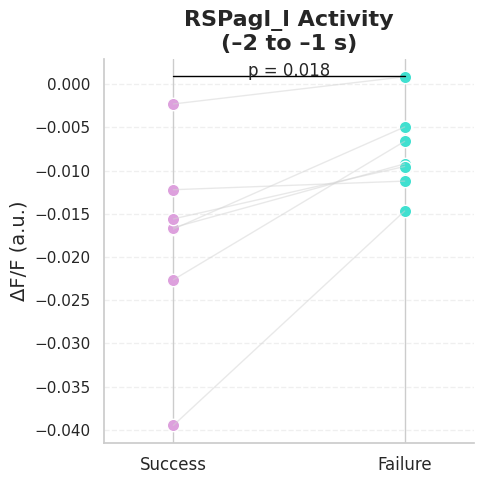

In [ ]:
#RSPの活動の有意差を計算

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import ttest_rel

roi_name = "RSPagl_l"
succ_vals, fail_vals, pairs = [], [], []

for mid in mouse_ids:
    s_list = roi_vals[roi_name]['success'].get(mid, [])
    f_list = roi_vals[roi_name]['fail'].get(mid, [])
    if s_list and f_list:
        s_mean = np.mean(s_list)
        f_mean = np.mean(f_list)
        succ_vals.append(s_mean)
        fail_vals.append(f_mean)
        pairs.append((s_mean, f_mean))

# 対応のある t検定
t_stat, p_val = ttest_rel(succ_vals, fail_vals)

# プロット
fig, ax = plt.subplots(figsize=(5, 5))
for s_mean, f_mean in pairs:
    ax.plot([0, 1], [s_mean, f_mean], color='lightgray', alpha=0.5, linewidth=1)

ax.scatter([0]*len(succ_vals), succ_vals,
           color='plum', edgecolors='white', s=80, label='Success')
ax.scatter([1]*len(fail_vals), fail_vals,
           color='turquoise', edgecolors='white', s=80, label='Failure')

# p値表示
ymax = max(max(succ_vals), max(fail_vals)) * 1.1
ax.plot([0, 1], [ymax, ymax], color='black', linewidth=1)
ax.text(0.5, ymax * 1.02, f'p = {p_val:.3f}', ha='center', fontsize=12)

ax.set_title(f'RSPagl_l Activity\n(–2 to –1 s)', fontsize=16, fontweight='bold')
ax.set_xticks([0, 1])
ax.set_xticklabels(['Success', 'Failure'], fontsize=12)
ax.set_ylabel('ΔF/F (a.u.)', fontsize=14)
ax.set_xlim(-0.3, 1.3)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.grid(axis='y', linestyle='--', alpha=0.3)
plt.tight_layout()
plt.show()


0it [00:00, ?it/s]/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
2it [01:04, 32.03s/it]/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
3it [02:43, 60.20s/it]/usr/local/lib/p

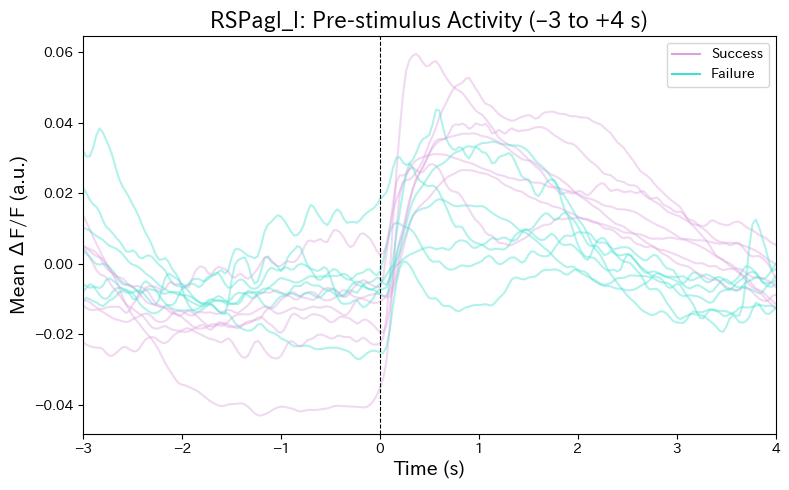

In [ ]:
# 各マウスの試行ごと平均波形を格納
succ_traces, fail_traces = {}, {}
for mid in mouse_ids:
    succ_traces[mid] = []
    fail_traces[mid] = []

# 試行ごとの波形データを再収集
for file in tqdm(root.rglob("*task-day8.nwb")):
    mid = file.parts[-2].split("-")[-1].zfill(3)
    if mid not in mouse_ids:
        continue

    session = nwbx.read_nwb(file)
    rois    = session.imaging.data
    trials  = session.trials.data
    times   = rois.index.to_numpy()

    for _, row in trials.iterrows():
        out = row["trial_outcome"]
        if out not in ("success", "miss", "failure"):
            continue
        idx0 = np.searchsorted(times, row["start_time"])
        s, e = idx0 - pre_samples, idx0 + post_samples
        if s < 0 or e >= len(times):
            continue

        window = rois.iloc[s:e+1]
        trace = window["RSPagl_l"].values
        if out == "success":
            succ_traces[mid].append(trace)
        else:
            fail_traces[mid].append(trace)

# 個体平均計算
mouse_plot_data = {}
for mid in mouse_ids:
    s_arr = np.stack(succ_traces[mid]) if succ_traces[mid] else None
    f_arr = np.stack(fail_traces[mid]) if fail_traces[mid] else None
    s_mean = np.nanmean(s_arr, axis=0) if s_arr is not None else None
    f_mean = np.nanmean(f_arr, axis=0) if f_arr is not None else None
    mouse_plot_data[mid] = (s_mean, f_mean)

# 描画
time_axis = (np.arange(win_len) - pre_samples) / fs
xmin, xmax = -3, 4
mask = (time_axis >= xmin) & (time_axis <= xmax)

plt.figure(figsize=(8, 5))
plt.plot([], [], color='plum', label='Success')
plt.plot([], [], color='turquoise', label='Failure')

for mid in mouse_ids:
    s_mean, f_mean = mouse_plot_data[mid]
    if s_mean is not None:
        plt.plot(time_axis[mask], s_mean[mask], color='plum', alpha=0.4)
    if f_mean is not None:
        plt.plot(time_axis[mask], f_mean[mask], color='turquoise', alpha=0.4)

plt.axvline(0, color='k', linestyle='--', linewidth=0.8)
plt.xlim(xmin, xmax)
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Mean ΔF/F (a.u.)", fontsize=14)
plt.title("RSPagl_l: Pre-stimulus Activity (–3 to +4 s)", fontsize=16)
plt.legend()
plt.tight_layout()
plt.show()


In [ ]:
#FDR補正を用いて44領域に有意差があるか確認（なかった
import numpy as np, pandas as pd

rows = []  # [(roi, mouse_id, mean_success, mean_fail), …]
for roi, cond_dict in roi_vals.items():
    for mid in set(cond_dict['success']) & set(cond_dict['fail']):
        rows.append([roi,
                     mid,
                     np.mean(cond_dict['success'][mid]),
                     np.mean(cond_dict['fail'   ][mid])])

df_mouse = pd.DataFrame(rows,                 # ROI × Mouse の 2 条件テーブル
                        columns=['ROI','mouse','succ','fail'])
from scipy.stats import ttest_rel

stats = []
for roi, sub in df_mouse.groupby('ROI'):
    t, p = ttest_rel(sub['succ'], sub['fail'])
    diff  = sub['succ'] - sub['fail']
    cohen_d = diff.mean() / diff.std(ddof=1)   # paired-d
    stats.append([roi, t, p, cohen_d, diff.mean()])

stats_df = pd.DataFrame(stats,
                        columns=['ROI','t','p_unc','cohen_d','mean_diff'])

from statsmodels.stats.multitest import multipletests
rej, p_fdr, _, _ = multipletests(stats_df['p_unc'],
                                 alpha=0.05,
                                 method='fdr_bh')
stats_df['p_fdr'] = p_fdr
stats_df['sig']   = rej          # True = q<0.05 で有意


In [ ]:
stats_df.head(5)

,ROI,t,p_unc,cohen_d,mean_diff,p_fdr,sig
0,AUDp_l,-3.406012,0.014389,-1.287352,-0.002327,0.066889,False
1,AUDp_r,-2.251144,0.065338,-0.850853,-0.003187,0.073715,False
2,AUDs_l,-3.847801,0.008482,-1.454332,-0.004149,0.066889,False
3,AUDs_r,-2.272625,0.063439,-0.858972,-0.005490,0.073455,False
4,MOp_l,-2.781135,0.031949,-1.051170,-0.008740,0.066889,False


In [ ]:
#有意差なかったから領域を12個にして確認

def classify_roi(roi_name):
    if roi_name.startswith("AUD"):
        group = "AUD"
    elif roi_name.startswith("MO"):
        group = "MO"
    elif roi_name.startswith("OB"):
        group = "OB"
    elif roi_name.startswith("RSP"):
        group = "RSP"
    elif roi_name.startswith("SS"):
        group = "SS"
    elif roi_name.startswith("VIS") or roi_name.startswith("VI"):
        group = "VIS"
    else:
        group = "OTHER"

    if roi_name.endswith("_l"):
        side = "l"
    elif roi_name.endswith("_r"):
        side = "r"
    else:
        side = "unk"

    return f"{group}_{side}"
df_mouse['group'] = df_mouse['ROI'].apply(classify_roi)
group_vals = []
for group, subdf in df_mouse.groupby('group'):
    for mid in subdf['mouse'].unique():
        msub = subdf[subdf['mouse'] == mid]
        group_vals.append([
            group, mid,
            msub['succ'].mean(),
            msub['fail'].mean()
        ])

df_group = pd.DataFrame(group_vals, columns=['group','mouse','succ','fail'])

# t検定
from scipy.stats import ttest_rel

group_stats = []
for group, gsub in df_group.groupby('group'):
    t, p = ttest_rel(gsub['succ'], gsub['fail'])
    diff  = gsub['succ'] - gsub['fail']
    d = diff.mean() / diff.std(ddof=1)
    group_stats.append([group, t, p, d])

df_stat12 = pd.DataFrame(group_stats, columns=['group','t','p','cohen_d'])


In [ ]:
df_stat12

,group,t,p,cohen_d
0,AUD_l,-3.741206,0.009609,-1.414043
1,AUD_r,-2.270629,0.063613,-0.858217
2,MO_l,-2.713480,0.034944,-1.025599
3,MO_r,-2.949125,0.025642,-1.114665
4,OB_l,-3.831190,0.008647,-1.448054
5,OB_r,-3.495185,0.012902,-1.321056
6,RSP_l,-2.863169,0.028682,-1.082176
7,RSP_r,-2.443151,0.050256,-0.923424
8,SS_l,-2.734353,0.033989,-1.033488
9,SS_r,-2.626735,0.039231,-0.992812


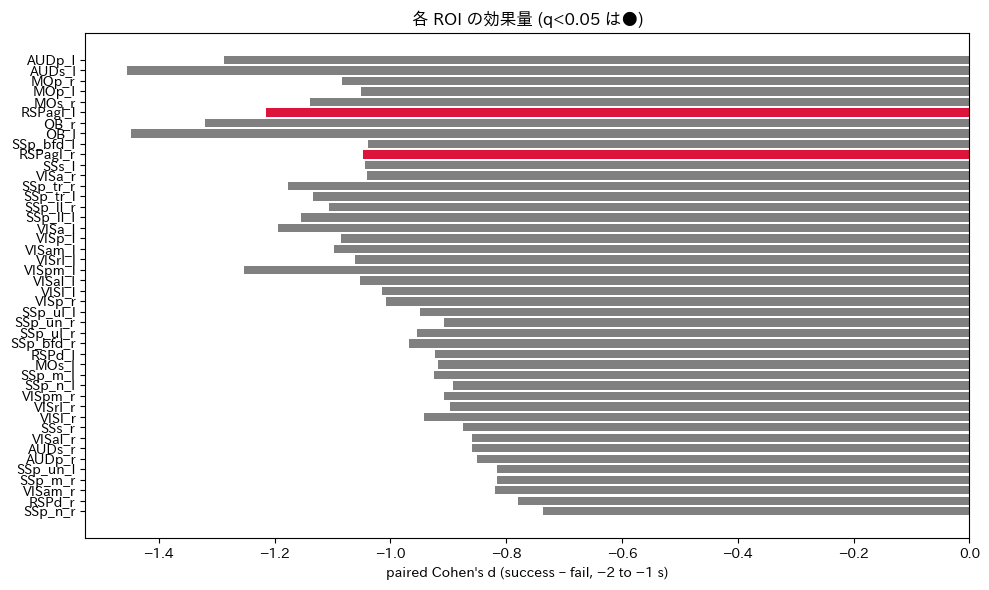

In [ ]:
import numpy as np, pandas as pd
from scipy.stats import ttest_rel
from statsmodels.stats.multitest import fdrcorrection

# ---------- 1) trial→mouse 平均 ----------
roi_mouse = []
for roi, cond in roi_vals.items():
    for mid in mouse_ids:
        if mid in cond['success'] and mid in cond['fail']:
            roi_mouse.append({
                'roi': roi,
                'mid': mid,
                'succ_mean': np.mean(cond['success'][mid]),
                'fail_mean': np.mean(cond['fail'][mid]),
            })
df = pd.DataFrame(roi_mouse)

# ---------- 2) t 検定＋効果量 ----------
rows = []
for roi, sub in df.groupby('roi'):
    succ = sub['succ_mean'].to_numpy()
    fail = sub['fail_mean'].to_numpy()
    if len(succ) < 3:             # マウス数が少なすぎる ROI はスキップ
        continue
    t, p = ttest_rel(succ, fail)
    diff = succ - fail
    d = diff.mean() / diff.std(ddof=1)     # paired Cohen's d
    rows.append((roi, p, d, len(succ)))
res = pd.DataFrame(rows, columns=['roi', 'p', 'd', 'n_mouse'])

# ---------- 3) FDR 補正 ----------
res['q'] = fdrcorrection(res['p'])[1]

# ---------- 4) 並び替え ----------
res = res.sort_values('q')

# ---------- 5) 可視化 ----------
import matplotlib.pyplot as plt
plt.figure(figsize=(10,6))
bars = plt.barh(res['roi'], res['d'], color=[
    'crimson' if r in ('RSPagl_r','RSPagl_l') else 'grey'
    for r in res['roi']])
plt.axvline(0, color='k', lw=0.7)
plt.gca().invert_yaxis()
plt.xlabel("paired Cohen's d (success – fail, −2 to −1 s)")
plt.title("各 ROI の効果量 (q<0.05 は●)")
for bar, q in zip(bars, res['q']):
    if q < 0.05:
        plt.plot(bar.get_width(), bar.get_y()+bar.get_height()/2, 'k.')
plt.tight_layout()
plt.show()


In [ ]:
# 各マウスで全脳 Δ を計算
roi_mouse = []
for roi, cond in roi_vals.items():
    for mid in mouse_ids:
        succ_vals = cond['success'].get(mid)
        fail_vals = cond['fail'].get(mid)
        if succ_vals is not None and fail_vals is not None:
            roi_mouse.append({
                'roi': roi,
                'mid': mid,
                'succ_mean': np.mean(succ_vals),
                'fail_mean': np.mean(fail_vals),
            })
df = pd.DataFrame(roi_mouse)

df['whole_delta'] = df.groupby('mid').apply(
    lambda g: (g['succ_mean'] - g['fail_mean']).mean()
).reset_index(level=0, drop=True)

# ROI Δ と全脳 Δ の相関
corrs = df.groupby('roi').apply(
    lambda g: np.corrcoef(g['succ_mean'] - g['fail_mean'],
                          g['whole_delta'])[0,1]
).rename('corr_with_global').to_frame()


<ipython-input-45-0bf113fb8797>:16: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df['whole_delta'] = df.groupby('mid').apply(
<ipython-input-45-0bf113fb8797>:21: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  corrs = df.groupby('roi').apply(


0it [00:00, ?it/s]/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
2it [01:02, 31.35s/it]/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
3it [01:55, 40.17s/it]/usr/local/lib/p

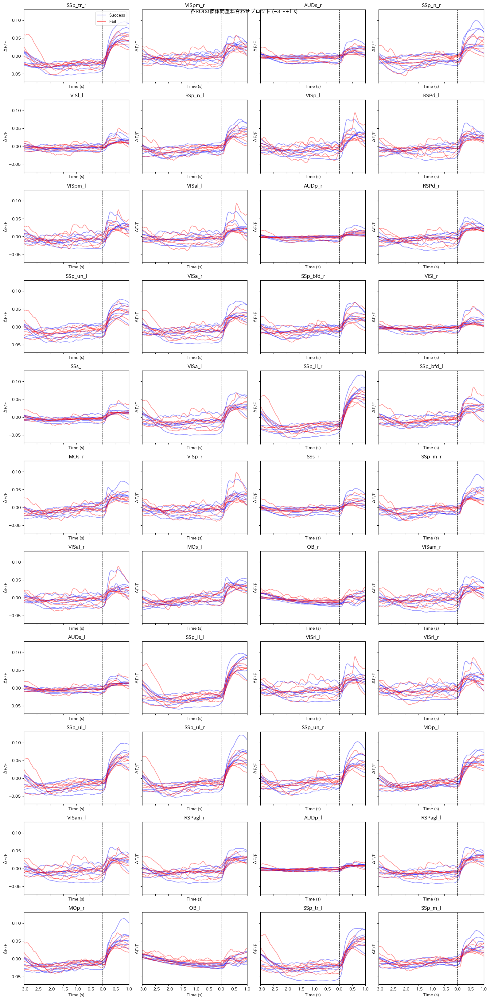

In [ ]:
#各脳領域にたいして、個体間の違いを表示している

import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from tqdm import tqdm


# ---------- 解析パラメータ ----------
fs           = 30         # imaging frame rate [Hz]
pre_time     = 3.0        # 試行開始前に戻る時間 [s]
post_time    = 4.0        # 試行開始後に追跡する時間 [s]
pre_samples  = int(pre_time  * fs)
post_samples = int(post_time * fs)
win_len      = pre_samples + post_samples + 1
time_axis    = (np.arange(win_len) - pre_samples) / fs   # −3 … 0 … +4 s

root      = Path("/content/drive/MyDrive/braidyn-bc/data")
mouse_ids = ["051","053","105","063","061","066","048"]

# ---------- ROIごとの試行トレースを収集 ----------
succ_roi = {}  # succ_roi[roi][mid] = list of (time,) arrays
fail_roi = {}

for file in tqdm(root.rglob("*task-day8.nwb")):
    mid = file.parts[-2].split("-")[-1].zfill(3)
    if mid not in mouse_ids:
        continue
    session   = nwbx.read_nwb(file)
    rois      = session.imaging.data      # DataFrame: index=time, columns=ROIs
    trials    = session.trials.data
    imaging_t = rois.index.to_numpy()

    for _, row in trials.iterrows():
        if row["trial_outcome"] not in ("success","miss"):
            continue
        idx0 = np.searchsorted(imaging_t, row["start_time"])
        s, e = idx0 - pre_samples, idx0 + post_samples
        if s < 0 or e >= len(imaging_t):
            continue

        window = rois.iloc[s:e+1]            # (win_len, n_rois)
        for roi in rois.columns:
            trace = window[roi].values        # (win_len,)
            if row["trial_outcome"] == "success":
                succ_roi.setdefault(roi, {}).setdefault(mid, []).append(trace)
            else:
                fail_roi.setdefault(roi, {}).setdefault(mid, []).append(trace)

# ---------- ROIごとにマウス平均を計算 ----------
roi_plot_data = {}  # roi_plot_data[roi] = (succ_means, fail_means)
for roi in succ_roi.keys() | fail_roi.keys():
    succ_means = {}
    fail_means = {}
    for mid in mouse_ids:
        if mid in succ_roi.get(roi, {}):
            arr = np.stack(succ_roi[roi][mid])
            succ_means[mid] = np.nanmean(arr, axis=0)
        if mid in fail_roi.get(roi, {}):
            arr = np.stack(fail_roi[roi][mid])
            fail_means[mid] = np.nanmean(arr, axis=0)
    roi_plot_data[roi] = (succ_means, fail_means)

# ---------- 全 ROI 重ね合わせプロット（−3～＋1秒） ----------
xmin, xmax = -3, 1
mask = (time_axis >= xmin) & (time_axis <= xmax)

n_rois = len(roi_plot_data)
n_cols = 4
n_rows = int(np.ceil(n_rois / n_cols))
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*4, n_rows*3),
                         sharex=True, sharey=True)
axes = axes.flatten()

for ax, (roi, (succ_means, fail_means)) in zip(axes, roi_plot_data.items()):
    # 凡例ダミー
    if ax == axes[0]:
        ax.plot([], [], color='blue', label='Success')
        ax.plot([], [], color='red',  label='Fail')

    for mid, trace in succ_means.items():
        ax.plot(time_axis[mask], trace[mask],
                color='blue', alpha=0.4)
    for mid, trace in fail_means.items():
        ax.plot(time_axis[mask], trace[mask],
                color='red',  alpha=0.4)

    ax.axvline(0, color='k', linestyle='--', lw=0.8)
    ax.set_title(roi)
    ax.set_xlim(xmin, xmax)
    ax.set_xlabel("Time (s)")
    ax.set_ylabel("ΔF/F")

axes[0].legend(loc='upper right')
for ax in axes[n_rois:]:
    ax.axis('off')

plt.suptitle("各ROIの個体間重ね合わせプロット (−3～+1 s)")
plt.tight_layout()
plt.show()


In [ ]:
trials

,start_time,stop_time,pull_onset,reaction_time,pull_duration_for_success,trial_outcome
0,11.878400,12.678400,12.645200,0.7738,0.3,miss
1,15.845200,16.878599,NaN,NaN,0.3,failure
2,21.545200,24.011801,21.711800,0.1742,0.3,success
3,38.245399,40.712002,38.411999,0.1398,0.3,success
4,52.045399,54.545399,52.245399,0.1918,0.3,success
...,...,...,...,...,...,...
158,1755.091187,1757.724609,1755.291260,0.2102,0.4,success
159,1772.824585,1775.391357,1772.991211,0.1832,0.4,success
160,1783.057983,1785.557983,1783.157959,0.1036,0.4,success
161,1789.157959,1791.824829,1789.424805,0.2582,0.4,success


##DAY8の中での音無しレバー引きの変化を可視化

### Mouse 51 ###


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)


### Mouse 53 ###


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)


  [warn] CSV not found: /content/drive/MyDrive/hackathon_data/VG1GC-53/task-day15/trials_L1L2.csv
### Mouse 105 ###


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)


### Mouse 63 ###


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)


### Mouse 61 ###


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)


### Mouse 66 ###


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)


### Mouse 48 ###
  [warn] CSV not found: /content/drive/MyDrive/hackathon_data/VG1GC-48/task-day1/trials_L1L2.csv
  [warn] CSV not found: /content/drive/MyDrive/hackathon_data/VG1GC-48/task-day15/trials_L1L2.csv


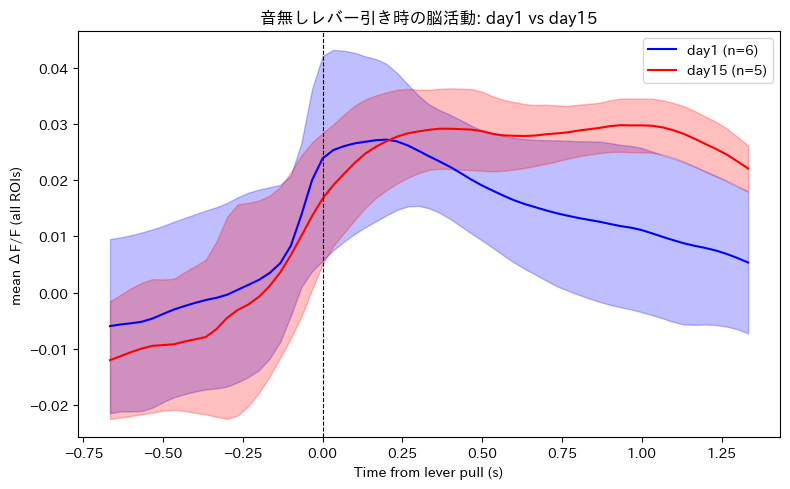

In [ ]:
#DAY1vs15。全脳平均。クラスAを適応。

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
from tqdm import tqdm
   # ← ご使用の nwb 読み込みユーティリティ
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

# -------------------- 設定 --------------------
mice_ids   = ["51", "53", "105", "63", "61", "66", "48"]
days       = [1, 15]                         # 比較したい日
csv_root   = Path("/content/drive/MyDrive/hackathon_data")
nwb_root   = Path("/content/drive/MyDrive/braidyn-bc/data")

fs           = 30           # イメージングサンプリングレート (Hz)
pre_samples  = 20           # pull_onset 前サンプル数
post_samples = 40           # pull_onset 後サンプル数
win_len      = pre_samples + post_samples + 1
time_axis    = (np.arange(win_len) - pre_samples) / fs

# -------------------- データ収集 --------------------
mouse_day_mean = {day: [] for day in days}   # {day: [マウス毎の平均トレース]}

for mid in mice_ids:
    print(f"### Mouse {mid} ###")
    for day in days:
        # ---------- 行動 CSV ----------
        csv_path = csv_root / f"VG1GC-{mid}" / f"task-day{day}" / "trials_L1L2.csv"
        if not csv_path.exists():
            print(f"  [warn] CSV not found: {csv_path}")
            continue

        trials = pd.read_csv(csv_path)
        filt   = (trials['state_lever']==1) & (trials['state_task']==0) & (trials['diff_value']>0.4)
        filtered = trials.loc[filt].copy()
        if filtered.empty:
            print(f"  [warn] no valid trials (mouse {mid}, day{day})")
            continue

        filtered['lever_time_nocue'] = filtered['t'] - filtered['diff_value']

        # ---------- nwb ファイル ----------
        nwb_files = list((nwb_root / f"VG1GC-{mid}").glob(f"*task-day{day}.nwb"))
        if not nwb_files:
            print(f"  [warn] nwb not found (mouse {mid}, day{day})")
            continue
        session   = nwbx.read_nwb(nwb_files[0])
        all_rois  = session.imaging.data          # DataFrame: index=time, columns=ROI
        imaging_t = all_rois.index.to_numpy()
        # ROI を平均して 1 本の時系列に
        mean_trace = all_rois.mean(axis=1).to_numpy()

        # ---------- 試行ごとのウインドウ取り出し ----------
        windows = []
        for ev_t in filtered['lever_time_nocue']:
            idx0  = np.searchsorted(imaging_t, ev_t)
            start, end = idx0 - pre_samples, idx0 + post_samples
            if start < 0 or end >= len(mean_trace):
                continue
            windows.append(mean_trace[start:end+1])
        if len(windows) == 0:
            print(f"  [warn] no windows extracted (mouse {mid}, day{day})")
            continue

        windows = np.stack(windows)               # shape = (trials, win_len)
        mouse_day_mean[day].append(np.nanmean(windows, axis=0))  # (win_len,)

# -------------------- 集計 --------------------
fig, ax = plt.subplots(figsize=(8,5))
colors = {1: "blue", 15: "red"}

for day in days:
    if not mouse_day_mean[day]:
        continue
    arr = np.stack(mouse_day_mean[day])          # shape = (mice, win_len)
    mean = arr.mean(axis=0)
    std  = arr.std(axis=0)

    ax.plot(time_axis, mean, color=colors[day], label=f"day{day} (n={arr.shape[0]})")
    ax.fill_between(time_axis, mean-std, mean+std, color=colors[day], alpha=0.25)

ax.axvline(0, color='k', linestyle='--', lw=0.8)
ax.set_xlabel("Time from lever pull (s)")
ax.set_ylabel("mean ΔF/F (all ROIs)")
ax.set_title("音無しレバー引き時の脳活動: day1 vs day15")
ax.legend()
plt.tight_layout()
plt.show()


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
core - cached version: 2.7.0, loaded version: 2.8.0
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:583: UserWarnin

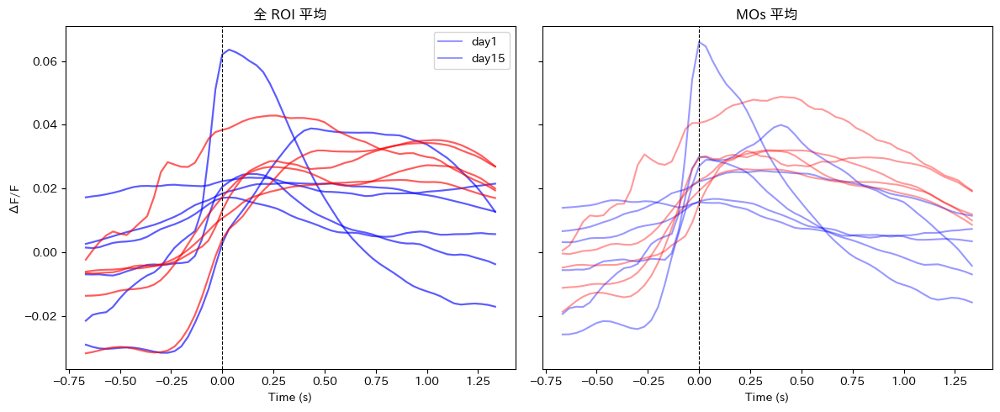

ペア t 検定 (MOs, 0–0.5 s 平均)  p = 0.4316


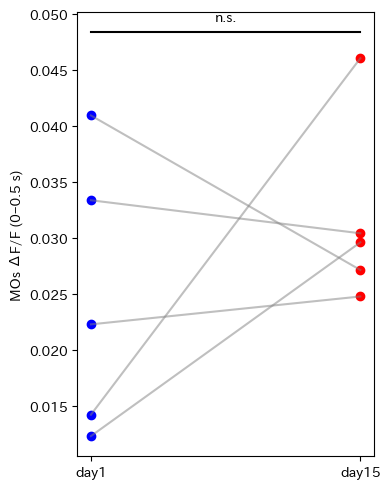

In [ ]:
# ============================================================
# 1. 個体別の平均トレース（全 ROI 平均 & MOs のみ）を保持
# ============================================================
# 作成済み mouse_day_mean には「全 ROI 平均」の day→[mouse trace] が入っている。
# ここでは同じ構造で MOs 版を作る。
mos_mouse_day_mean = {day: [] for day in days}        # day → [mouse trace]
mos_mouse_ids      = {day: [] for day in days}        # day → [mouse id]

for mid in mice_ids:
    for day in days:
        csv_path = csv_root / f"VG1GC-{mid}" / f"task-day{day}" / "trials_L1L2.csv"
        nwb_files = list((nwb_root / f"VG1GC-{mid}").glob(f"*task-day{day}.nwb"))
        if not (csv_path.exists() and nwb_files):
            continue

        # --- 行動 ---
        trials = pd.read_csv(csv_path)
        filt   = (trials['state_lever']==1) & (trials['state_task']==0) & (trials['diff_value']>0.4)
        filtered = trials.loc[filt].copy()
        if filtered.empty:
            continue
        filtered['lever_time_nocue'] = filtered['t'] - filtered['diff_value']

        # --- nwb 読み込み ---
        session   = nwbx.read_nwb(nwb_files[0])
        all_rois  = session.imaging.data           # index=time, columns=ROI
        imaging_t = all_rois.index.to_numpy()

        # --- “MOs” と名前に入る ROI を抽出（大域 Ca だと複数サブ ROI があることが多い）---
        mos_cols = [c for c in all_rois.columns if "MOs" in c]
        if len(mos_cols) == 0:
            continue

        # 平均トレース（全 ROI と MOs）を事前計算
        mean_trace_all = all_rois.mean(axis=1).to_numpy()
        mean_trace_mos = all_rois[mos_cols].mean(axis=1).to_numpy()

        # --- ウインドウ抽出ヘルパ ---
        def collect_windows(trace_1d):
            win_list = []
            for ev_t in filtered['lever_time_nocue']:
                idx0 = np.searchsorted(imaging_t, ev_t)
                st, ed = idx0 - pre_samples, idx0 + post_samples
                if st < 0 or ed >= len(trace_1d):
                    continue
                win_list.append(trace_1d[st:ed+1])
            return np.stack(win_list) if win_list else None

        win_all = collect_windows(mean_trace_all)
        win_mos = collect_windows(mean_trace_mos)

        if win_all is not None and win_mos is not None:
            # 個体平均を保存
            mouse_day_mean[day].append(win_all.mean(axis=0))
            mos_mouse_day_mean[day].append(win_mos.mean(axis=0))
            mos_mouse_ids[day].append(mid)

# ============================================================
# 2. 個体別トレースを重ね描き
# ============================================================
fig, axes = plt.subplots(1, 2, figsize=(12,5), sharey=True)
axes[0].set_title("全 ROI 平均")
axes[1].set_title("MOs 平均")

for day, color in zip(days, ["blue", "red"]):
    for tr in mouse_day_mean[day]:
        axes[0].plot(time_axis, tr, color=color, alpha=0.4)
    for tr in mos_mouse_day_mean[day]:
        axes[1].plot(time_axis, tr, color=color, alpha=0.4)

for ax in axes:
    ax.axvline(0, color='k', ls='--', lw=0.8)
    ax.set_xlabel("Time (s)")
axes[0].set_ylabel("ΔF/F")
axes[0].legend([f"day{d}" for d in days])
plt.tight_layout()
plt.show()

# ============================================================
# 3. MOs の day1 vs day15 有意差検定（ペア t 検定）
#    - 時間窓: 0 ~ 0.5 s の平均振幅
# ============================================================
# 共有マウスだけ取り出す
mice_with_both = sorted(set(mos_mouse_ids[1]).intersection(mos_mouse_ids[15]))
if len(mice_with_both) < 2:
    print("有意差検定に十分なマウスが揃っていません")
else:
    idx_sig = (time_axis >= 0) & (time_axis <= 0.5)

    day1_vals, day15_vals = [], []
    for mid in mice_with_both:
        i1 = mos_mouse_ids[1].index(mid)
        i15 = mos_mouse_ids[15].index(mid)
        day1_vals.append(mos_mouse_day_mean[1][i1][idx_sig].mean())
        day15_vals.append(mos_mouse_day_mean[15][i15][idx_sig].mean())

    day1_vals = np.array(day1_vals)
    day15_vals = np.array(day15_vals)

    from scipy.stats import ttest_rel
    t_stat, p_val = ttest_rel(day1_vals, day15_vals)
    print(f"ペア t 検定 (MOs, 0–0.5 s 平均)  p = {p_val:.4f}")

    # -------- 可視化（ペアラインプロットに ★ で有意差表示） --------
    fig, ax = plt.subplots(figsize=(4,5))
    x1, x2 = 0, 1
    ax.scatter(np.full_like(day1_vals, x1), day1_vals, c="blue")
    ax.scatter(np.full_like(day15_vals, x2), day15_vals, c="red")
    for d1, d15 in zip(day1_vals, day15_vals):
        ax.plot([x1, x2], [d1, d15], c="gray", alpha=0.5)
    ax.set_xticks([0,1])
    ax.set_xticklabels(["day1", "day15"])
    ax.set_ylabel("MOs ΔF/F (0–0.5 s)")
    # 有意差アノテーション
    y_max = max(day1_vals.max(), day15_vals.max()) * 1.05
    ax.plot([x1, x2], [y_max, y_max], c="k")
    sig_str = "*" if p_val < 0.05 else "n.s."
    ax.text(0.5, y_max*1.02, sig_str, ha='center')
    plt.tight_layout()
    plt.show()


ペア t 検定 (MOs, 0–0.5 s 平均)  p = 0.0434


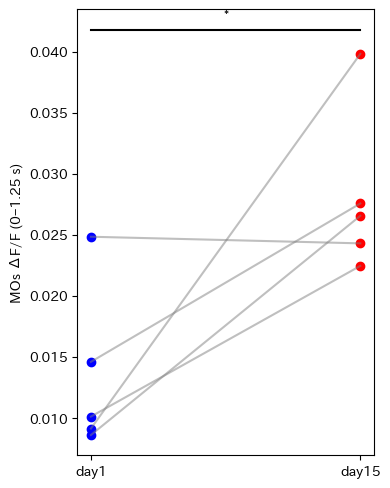

In [ ]:

# ============================================================
# 3. MOs の day1 vs day15 有意差検定（ペア t 検定）
#    - 時間窓: 0 ~ 0.5 s の平均振幅
# ============================================================
# 共有マウスだけ取り出す
mice_with_both = sorted(set(mos_mouse_ids[1]).intersection(mos_mouse_ids[15]))
if len(mice_with_both) < 2:
    print("有意差検定に十分なマウスが揃っていません")
else:
    idx_sig = (time_axis >= 0) & (time_axis <= 1.25)

    day1_vals, day15_vals = [], []
    for mid in mice_with_both:
        i1 = mos_mouse_ids[1].index(mid)
        i15 = mos_mouse_ids[15].index(mid)
        day1_vals.append(mos_mouse_day_mean[1][i1][idx_sig].mean())
        day15_vals.append(mos_mouse_day_mean[15][i15][idx_sig].mean())

    day1_vals = np.array(day1_vals)
    day15_vals = np.array(day15_vals)

    from scipy.stats import ttest_rel
    t_stat, p_val = ttest_rel(day1_vals, day15_vals)
    print(f"ペア t 検定 (MOs, 0–0.5 s 平均)  p = {p_val:.4f}")

    # -------- 可視化（ペアラインプロットに ★ で有意差表示） --------
    fig, ax = plt.subplots(figsize=(4,5))
    x1, x2 = 0, 1
    ax.scatter(np.full_like(day1_vals, x1), day1_vals, c="blue")
    ax.scatter(np.full_like(day15_vals, x2), day15_vals, c="red")
    for d1, d15 in zip(day1_vals, day15_vals):
        ax.plot([x1, x2], [d1, d15], c="gray", alpha=0.5)
    ax.set_xticks([0,1])
    ax.set_xticklabels(["day1", "day15"])
    ax.set_ylabel("MOs ΔF/F (0–1.25 s)")
    # 有意差アノテーション
    y_max = max(day1_vals.max(), day15_vals.max()) * 1.05
    ax.plot([x1, x2], [y_max, y_max], c="k")
    sig_str = "*" if p_val < 0.05 else "n.s."
    ax.text(0.5, y_max*1.02, sig_str, ha='center')
    plt.tight_layout()
    plt.show()


<ipython-input-70-29dd6261a10c>:76: UserWarning: Glyph 38899 (\N{CJK UNIFIED IDEOGRAPH-97F3}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-70-29dd6261a10c>:76: UserWarning: Glyph 28961 (\N{CJK UNIFIED IDEOGRAPH-7121}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-70-29dd6261a10c>:76: UserWarning: Glyph 12375 (\N{HIRAGANA LETTER SI}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-70-29dd6261a10c>:76: UserWarning: Glyph 12524 (\N{KATAKANA LETTER RE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-70-29dd6261a10c>:76: UserWarning: Glyph 12496 (\N{KATAKANA LETTER BA}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-70-29dd6261a10c>:76: UserWarning: Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-70-29dd6261a10c>:76: UserWarning: Glyph 24341 (\N{CJK UNIFIED IDEOGRAPH-5F15}) missing from font(s) Dej

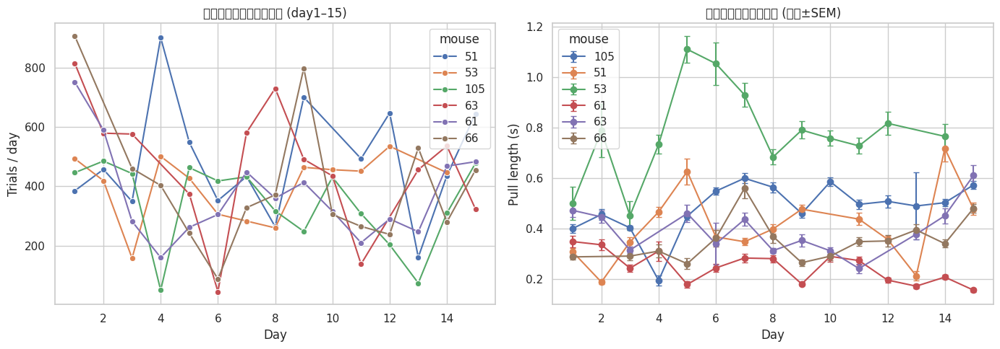


--- day1 vs day15 : pull_len_mean, paired t-test ---
mouse 51: p = 1.0000
mouse 53: data incomplete
mouse 105: p = 1.0000
mouse 63: p = 1.0000
mouse 61: p = 1.0000
mouse 66: p = 1.0000
mouse 48: data incomplete


In [ ]:
"""
DAY ごとの「音無しレバー引き」試行数とレバー引き長さを
  • 7 匹すべてのマウスについて
  • day 1–15 で
可視化するスクリプト
------------------------------------------------------------
* 音無しレバー引き  : (state_task == 0) かつ diff_value > 0.4
* レバー引き長さ    :
                      無ければ diff_value を代用
------------------------------------------------------------
"""

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path

# ---------- 設定 ----------
mice_ids   = ["51", "53", "105", "63", "61", "66", "48"]
days       = range(1, 16)                        # day 1–15
csv_root   = Path("/content/drive/MyDrive/hackathon_data")
sns.set(style="whitegrid")

records = []   # ← 集計結果を入れるリスト

# ---------- データ収集 ----------
for mid in mice_ids:
    for day in days:
        csv_path = csv_root / f"VG1GC-{mid}" / f"task-day{day}" / "trials_L1L2.csv"
        if not csv_path.exists():
            continue

        df = pd.read_csv(csv_path)

        # --- 音無しレバー引き試行を抽出 ---
        mask = (df["state_task"] == 0) & (df["diff_value"] > 0.034)
        df_nosound = df.loc[mask]

        if df_nosound.empty:
            continue

        # --- レバー引きの「長さ」列を決定 ---
        dur_col = "diff_value"

        records.append({
            "mouse": mid,
            "day"  : day,
            "n_trials": len(df_nosound),
            "pull_len_mean": df_nosound[dur_col].mean(),
            "pull_len_sem" : df_nosound[dur_col].std(ddof=1) / (len(df_nosound)**0.5)
        })

# ---------- DataFrame 化 ----------
res = pd.DataFrame(records)

# ---------- 可視化 ----------
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# ① 試行数の推移
sns.lineplot(data=res, x="day", y="n_trials", hue="mouse",
             marker="o", ax=axes[0])
axes[0].set_title("音無しレバー引き試行数 (day1–15)")
axes[0].set_xlabel("Day")
axes[0].set_ylabel("Trials / day")

# ② レバー引き長さの推移（平均±SEM）
for mid, grp in res.groupby("mouse"):
    axes[1].errorbar(grp["day"], grp["pull_len_mean"],
                     yerr=grp["pull_len_sem"],
                     marker="o", label=mid, capsize=3)
axes[1].set_title("音無しレバー引き長さ (平均±SEM)")
axes[1].set_xlabel("Day")
axes[1].set_ylabel("Pull length (s)")
axes[1].legend(title="mouse")

plt.tight_layout()
plt.show()

# ---------- 有意差検定（例：day1 vs day15 のペア t 検定, 各マウスごと） ----------
from scipy.stats import ttest_rel

print("\n--- day1 vs day15 : pull_len_mean, paired t-test ---")
for mid in mice_ids:
    g = res.query("mouse == @mid and day in [1, 15]")
    if len(g) == 2:
        t, p = ttest_rel(g.sort_values("day")["pull_len_mean"].values,
                         g.sort_values("day")["pull_len_mean"].values[::-1])
        print(f"mouse {mid}: p = {p:.4f}")
    else:
        print(f"mouse {mid}: data incomplete")


<ipython-input-88-2905c99d89e9>:76: UserWarning: Glyph 38899 (\N{CJK UNIFIED IDEOGRAPH-97F3}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-88-2905c99d89e9>:76: UserWarning: Glyph 28961 (\N{CJK UNIFIED IDEOGRAPH-7121}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-88-2905c99d89e9>:76: UserWarning: Glyph 12375 (\N{HIRAGANA LETTER SI}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-88-2905c99d89e9>:76: UserWarning: Glyph 12524 (\N{KATAKANA LETTER RE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-88-2905c99d89e9>:76: UserWarning: Glyph 12496 (\N{KATAKANA LETTER BA}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-88-2905c99d89e9>:76: UserWarning: Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-88-2905c99d89e9>:76: UserWarning: Glyph 24341 (\N{CJK UNIFIED IDEOGRAPH-5F15}) missing from font(s) Dej

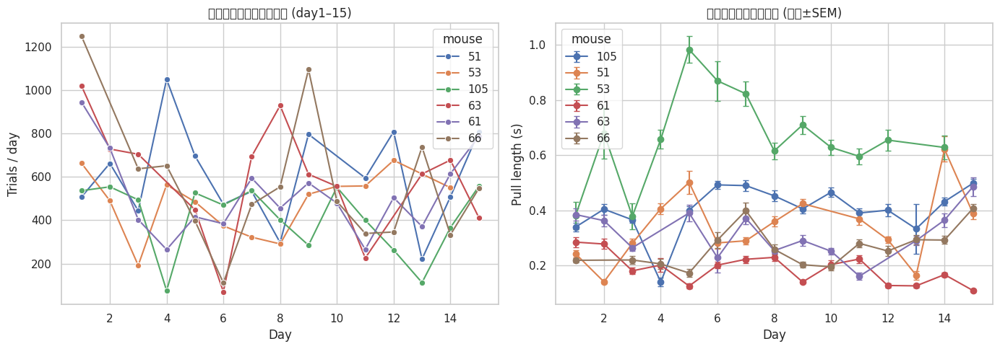


--- day1 vs day15 : pull_len_mean, paired t-test ---
mouse 51: p = 1.0000
mouse 53: data incomplete
mouse 105: p = 1.0000
mouse 63: p = 1.0000
mouse 61: p = 1.0000
mouse 66: p = 1.0000
mouse 48: data incomplete


In [ ]:
"""
DAY ごとの「音無しレバー引き」試行数とレバー引き長さを
  • 7 匹すべてのマウスについて
  • day 1–15 で
可視化するスクリプト
------------------------------------------------------------
* 音無しレバー引き  : (state_task == 0) かつ diff_value > 0.00
* レバー引き長さ    :
                      無ければ diff_value を代用
------------------------------------------------------------
"""

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path

# ---------- 設定 ----------
mice_ids   = ["51", "53", "105", "63", "61", "66", "48"]
days       = range(1, 16)                        # day 1–15
csv_root   = Path("/content/drive/MyDrive/hackathon_data")
sns.set(style="whitegrid")

records = []   # ← 集計結果を入れるリスト

# ---------- データ収集 ----------
for mid in mice_ids:
    for day in days:
        csv_path = csv_root / f"VG1GC-{mid}" / f"task-day{day}" / "trials_L1L2.csv"
        if not csv_path.exists():
            continue

        df = pd.read_csv(csv_path)

        # --- 音無しレバー引き試行を抽出 ---
        mask = (df["state_task"] == 0) & (df["diff_value"] > 0.0)
        df_nosound = df.loc[mask]

        if df_nosound.empty:
            continue

        # --- レバー引きの「長さ」列を決定 ---
        dur_col = "diff_value"

        records.append({
            "mouse": mid,
            "day"  : day,
            "n_trials": len(df_nosound),
            "pull_len_mean": df_nosound[dur_col].mean(),
            "pull_len_sem" : df_nosound[dur_col].std(ddof=1) / (len(df_nosound)**0.5)
        })

# ---------- DataFrame 化 ----------
res = pd.DataFrame(records)

# ---------- 可視化 ----------
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# ① 試行数の推移
sns.lineplot(data=res, x="day", y="n_trials", hue="mouse",
             marker="o", ax=axes[0])
axes[0].set_title("音無しレバー引き試行数 (day1–15)")
axes[0].set_xlabel("Day")
axes[0].set_ylabel("Trials / day")

# ② レバー引き長さの推移（平均±SEM）
for mid, grp in res.groupby("mouse"):
    axes[1].errorbar(grp["day"], grp["pull_len_mean"],
                     yerr=grp["pull_len_sem"],
                     marker="o", label=mid, capsize=3)
axes[1].set_title("音無しレバー引き長さ (平均±SEM)")
axes[1].set_xlabel("Day")
axes[1].set_ylabel("Pull length (s)")
axes[1].legend(title="mouse")

plt.tight_layout()
plt.show()

# ---------- 有意差検定（例：day1 vs day15 のペア t 検定, 各マウスごと） ----------
from scipy.stats import ttest_rel

print("\n--- day1 vs day15 : pull_len_mean, paired t-test ---")
for mid in mice_ids:
    g = res.query("mouse == @mid and day in [1, 15]")
    if len(g) == 2:
        t, p = ttest_rel(g.sort_values("day")["pull_len_mean"].values,
                         g.sort_values("day")["pull_len_mean"].values[::-1])
        print(f"mouse {mid}: p = {p:.4f}")
    else:
        print(f"mouse {mid}: data incomplete")


<ipython-input-71-89dc19aaacf7>:18: UserWarning: Glyph 38899 (\N{CJK UNIFIED IDEOGRAPH-97F3}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-71-89dc19aaacf7>:18: UserWarning: Glyph 28961 (\N{CJK UNIFIED IDEOGRAPH-7121}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-71-89dc19aaacf7>:18: UserWarning: Glyph 12375 (\N{HIRAGANA LETTER SI}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-71-89dc19aaacf7>:18: UserWarning: Glyph 12524 (\N{KATAKANA LETTER RE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-71-89dc19aaacf7>:18: UserWarning: Glyph 12496 (\N{KATAKANA LETTER BA}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-71-89dc19aaacf7>:18: UserWarning: Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-71-89dc19aaacf7>:18: UserWarning: Glyph 24341 (\N{CJK UNIFIED IDEOGRAPH-5F15}) missing from font(s) Dej

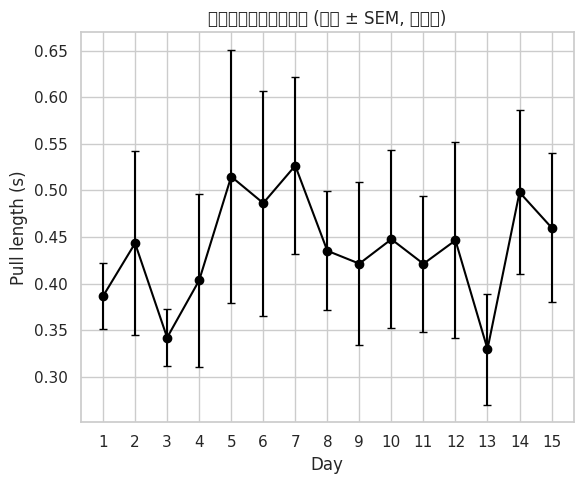

In [ ]:
# ---------- 個体平均 (group by day) ----------
grouped = res.groupby("day").agg(
    mean_pull_len=("pull_len_mean", "mean"),
    sem_pull_len=("pull_len_mean", lambda x: x.std(ddof=1) / (len(x)**0.5))
).reset_index()

# ---------- プロット ----------
plt.figure(figsize=(6, 5))
plt.errorbar(grouped["day"], grouped["mean_pull_len"],
             yerr=grouped["sem_pull_len"],
             marker="o", capsize=3, color="black")

plt.title("音無しレバー引き長さ (平均 ± SEM, 全個体)")
plt.xlabel("Day")
plt.ylabel("Pull length (s)")
plt.xticks(grouped["day"])
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
!pip install japanize_matplotlib

対応のあるt検定: p = 0.2751


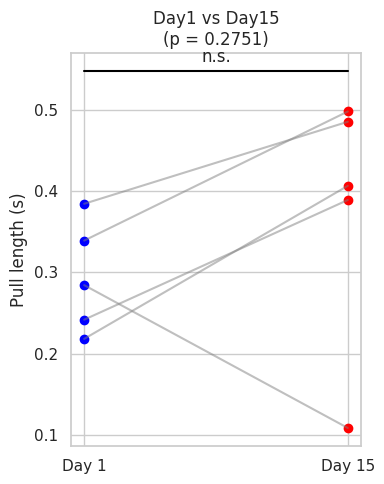

In [ ]:
from scipy.stats import ttest_rel
import matplotlib.pyplot as plt
import japanize_matplotlib

# --- day1 と day15 のデータを抽出 ---
pivot_df = res.query("day in [1, 15]").pivot(index="mouse", columns="day", values="pull_len_mean")
pivot_df.columns = ["day1", "day15"]
pivot_df = pivot_df.dropna()  # day1,15 両方あるマウスのみ

# --- 有意差検定（対応のあるt検定） ---
t_stat, p_val = ttest_rel(pivot_df["day1"], pivot_df["day15"])
print(f"対応のあるt検定: p = {p_val:.4f}")

# --- プロット ---
plt.figure(figsize=(4, 5))
x1, x2 = 0, 1
plt.scatter([x1]*len(pivot_df), pivot_df["day1"], color="blue", label="Day 1")
plt.scatter([x2]*len(pivot_df), pivot_df["day15"], color="red", label="Day 15")

for i in range(len(pivot_df)):
    plt.plot([x1, x2], [pivot_df.iloc[i, 0], pivot_df.iloc[i, 1]], color="gray", alpha=0.5)

plt.xticks([x1, x2], ["Day 1", "Day 15"])
plt.ylabel("Pull length (s)")
plt.title("Day1 vs Day15\n(p = 0.2751)")
plt.grid(True)

# 有意差の表示
y_max = max(pivot_df.max()) * 1.1
plt.plot([x1, x2], [y_max, y_max], color="black")
plt.text(0.5, y_max*1.02, "*" if p_val < 0.05 else "n.s.", ha="center", fontsize=12)

plt.tight_layout()
plt.show()


<ipython-input-93-1e2095c2b758>:38: UserWarning: Glyph 38899 (\N{CJK UNIFIED IDEOGRAPH-97F3}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-93-1e2095c2b758>:38: UserWarning: Glyph 28961 (\N{CJK UNIFIED IDEOGRAPH-7121}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-93-1e2095c2b758>:38: UserWarning: Glyph 12375 (\N{HIRAGANA LETTER SI}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-93-1e2095c2b758>:38: UserWarning: Glyph 12524 (\N{KATAKANA LETTER RE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-93-1e2095c2b758>:38: UserWarning: Glyph 12496 (\N{KATAKANA LETTER BA}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-93-1e2095c2b758>:38: UserWarning: Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-93-1e2095c2b758>:38: UserWarning: Glyph 24341 (\N{CJK UNIFIED IDEOGRAPH-5F15}) missing from font(s) Dej

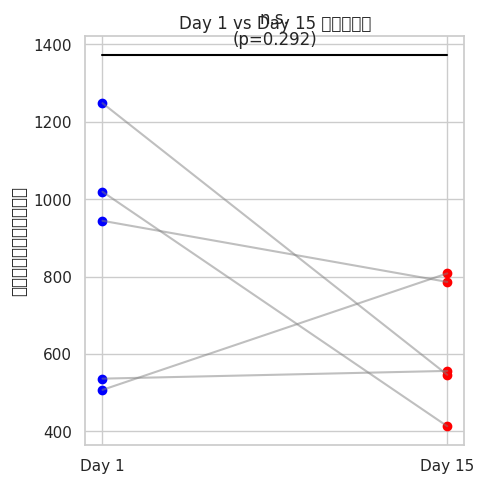

In [ ]:
#レバー引き試行数の変化

import matplotlib.pyplot as plt
from scipy.stats import ttest_rel

# ---------- day1 vs day15 の試行数を個体ごとに抽出 ----------
df_day1 = res.query("day == 1").set_index("mouse")["n_trials"]
df_day15 = res.query("day == 15").set_index("mouse")["n_trials"]

# 共通のマウスだけ抽出（両日データが揃っているもの）
common_mice = df_day1.index.intersection(df_day15.index)
vals_day1 = df_day1.loc[common_mice].values
vals_day15 = df_day15.loc[common_mice].values

# ---------- 統計検定 ----------
t_stat, p_val = ttest_rel(vals_day1, vals_day15)

# ---------- 図の描画 ----------
plt.figure(figsize=(5,5))
x1, x2 = 0, 1
plt.scatter([x1]*len(vals_day1), vals_day1, color="blue", label="Day 1")
plt.scatter([x2]*len(vals_day15), vals_day15, color="red", label="Day 15")

# 個体ごとの線
for v1, v15 in zip(vals_day1, vals_day15):
    plt.plot([x1, x2], [v1, v15], color="gray", alpha=0.5)

plt.xticks([x1, x2], ["Day 1", "Day 15"])
plt.ylabel("音無しレバー引き試行数")
plt.title("Day 1 vs Day 15 試行数変化")

# 有意差表示
ymax = max(vals_day1.max(), vals_day15.max()) * 1.1
plt.plot([x1, x2], [ymax, ymax], color="black")
sig_label = "*" if p_val < 0.05 else "n.s."
plt.text((x1 + x2)/2, ymax * 1.02, f"{sig_label}\n(p={p_val:.3f})", ha='center')

plt.tight_layout()
plt.show()


In [ ]:
#音無しレバー引き課題

import pandas as pd
# CSVファイルの読み込み
csv_path = Path('/content/drive/MyDrive/VG1GC-105/VG1GC-105/task-day8/trials_L1L2.csv')
trials = pd.read_csv(csv_path)
print("全試行数:", len(trials))

# 条件に合致する行のフィルタリング
filtered_trials = trials[(trials['state_lever']==1) &
                         (trials['state_task'] == 0) &
                         (trials['diff_value'] > 0.4)].copy()
print("フィルタリング後の試行数:", len(filtered_trials))

# lever_time_nocueの算出：tからdiff_valueを引いた時刻
filtered_trials['lever_time_nocue'] = filtered_trials['t'] - filtered_trials['diff_value']
print("lever_time_nocueの先頭5行:\n", filtered_trials[['t', 'diff_value', 'lever_time_nocue']].head())

# 脳活動データ（各ROIの時系列データ）の取得
all_rois = session.imaging.data  # DataFrame形式と仮定

# --- 時間軸生成 ---
imaging_t = all_rois.index.to_numpy()


全試行数: 54000
フィルタリング後の試行数: 200
lever_time_nocueの先頭5行:
              t  diff_value  lever_time_nocue
101   8.578400    0.733200          7.845200
377  17.778601    0.666801         17.111799
649  26.845200    0.799999         26.045200
745  30.045200    0.666601         29.378599
895  35.045399    1.033398         34.012001


In [ ]:
# imagingから全データをpandasデータフレームとして取り出す
all_rois = session.imaging.data

In [ ]:
#有意差を検証
from scipy.stats import ttest_ind
from math import ceil

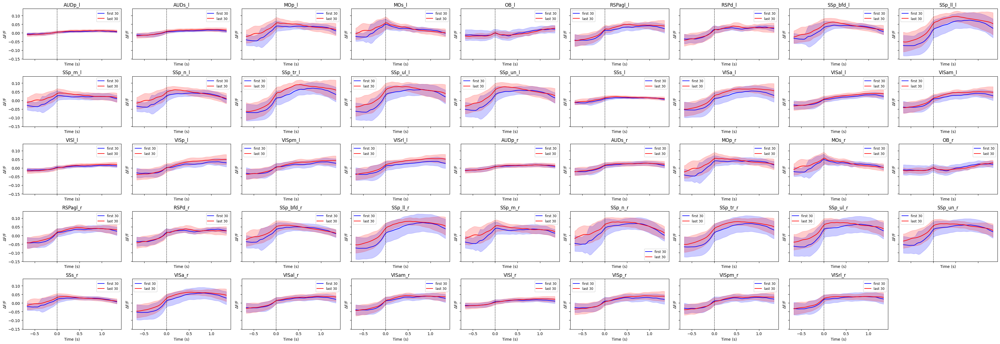

In [ ]:
#音無しレバー引き課題

# import pandas as pd
# # CSVファイルの読み込み
# csv_path = Path('/content/drive/MyDrive/VG1GC-105/VG1GC-105/task-day8/trials_L1L2.csv')
# csv_path = Path('/content/drive/MyDrive/hackathon_data/VG1GC-105/task-day8/trials_L1L2.csv')
# trials = pd.read_csv(csv_path)
# print("全試行数:", len(trials))

# # 条件に合致する行のフィルタリング
# filtered_trials = trials[(trials['state_lever']==1) &
#                          (trials['state_task'] == 0) &
#                          (trials['diff_value'] > 0.4)].copy()
# print("フィルタリング後の試行数:", len(filtered_trials))

# # lever_time_nocueの算出：tからdiff_valueを引いた時刻
# filtered_trials['lever_time_nocue'] = filtered_trials['t'] - filtered_trials['diff_value']
# print("lever_time_nocueの先頭5行:\n", filtered_trials[['t', 'diff_value', 'lever_time_nocue']].head())

# dataroot = Path('/content/drive/MyDrive/braidyn-bc/data')
# testfile = dataroot / "VG1GC-105" / "VG1GC-105_2024-02-02_task-day8.nwb"
# session = nwbx.read_nwb(testfile)
# # 脳活動データ（各ROIの時系列データ）の取得
# all_rois = session.imaging.data  # DataFrame形式と仮定

# # --- 時間軸生成 ---
# imaging_t = all_rois.index.to_numpy()


# --- 試行の先頭30件と末尾30件を取得 ---
early_trials = filtered_trials.iloc[:30]
late_trials  = filtered_trials.iloc[-30:]


# --- プロット用パラメータ ---
pre_samples  = 20   # pull_onset の前何サンプル
post_samples = 40   # pull_onset の後何サンプル
window_len   = pre_samples + post_samples + 1
fs           = 30   # サンプリングレート (Hz)
time_axis    = (np.arange(window_len) - pre_samples) / fs  # 秒

def extract_roi_trials(trials_subset):
    roi_trials = {roi: [] for roi in all_rois.columns}
    for event_time in trials_subset['lever_time_nocue']:
        idx0 = np.searchsorted(imaging_t, event_time)
        start, end = idx0 - pre_samples, idx0 + post_samples
        if start < 0 or end >= len(imaging_t):
            continue
        window = all_rois.iloc[start:end+1]
        for roi in all_rois.columns:
            roi_trials[roi].append(window[roi].values)
    return roi_trials

# ROIごとの時系列抽出
roi_trials_early = extract_roi_trials(early_trials)
roi_trials_late  = extract_roi_trials(late_trials)

# 平均と標準偏差を計算
roi_mean_early, roi_std_early = {}, {}
roi_mean_late, roi_std_late = {}, {}
for roi in all_rois.columns:
    if roi_trials_early[roi] and roi_trials_late[roi]:
        arr_early = np.stack(roi_trials_early[roi])
        arr_late  = np.stack(roi_trials_late[roi])
        roi_mean_early[roi] = np.nanmean(arr_early, axis=0)
        roi_std_early[roi]  = np.nanstd(arr_early, axis=0)
        roi_mean_late[roi]  = np.nanmean(arr_late, axis=0)
        roi_std_late[roi]   = np.nanstd(arr_late, axis=0)

# プロット設定
n_rois = len(roi_mean_early)
n_cols = 9
n_rows = ceil(n_rois / n_cols)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*4, n_rows*2.5), sharex=True, sharey=True)
axes = axes.flatten()

for ax, roi in zip(axes, roi_mean_early.keys()):
    ax.plot(time_axis, roi_mean_early[roi], label='first 30', color='blue')
    ax.fill_between(time_axis, roi_mean_early[roi] - roi_std_early[roi],
                    roi_mean_early[roi] + roi_std_early[roi], alpha=0.2, color='blue')

    ax.plot(time_axis, roi_mean_late[roi], label='last 30', color='red')
    ax.fill_between(time_axis, roi_mean_late[roi] - roi_std_late[roi],
                    roi_mean_late[roi] + roi_std_late[roi], alpha=0.2, color='red')

    ax.axvline(0, color='k', linestyle='--', linewidth=0.8)
    ax.set_title(roi)
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('ΔF/F')
    ax.legend(fontsize='small')

for ax in axes[n_rois:]:
    ax.axis('off')

plt.tight_layout()
plt.show()



===== Mouse 51  Day8 =====
総有効試行数 : 375
クラスタ中心値   : [0.1256 0.7187]
KMeans しきい値 : 0.4221
フィルタ後試行数 : 100
前半  diff_value  0.713 ± 0.228 reaction_time 0.315 ± 0.024
後半  diff_value  0.724 ± 0.315 reaction_time 0.288 ± 0.049


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


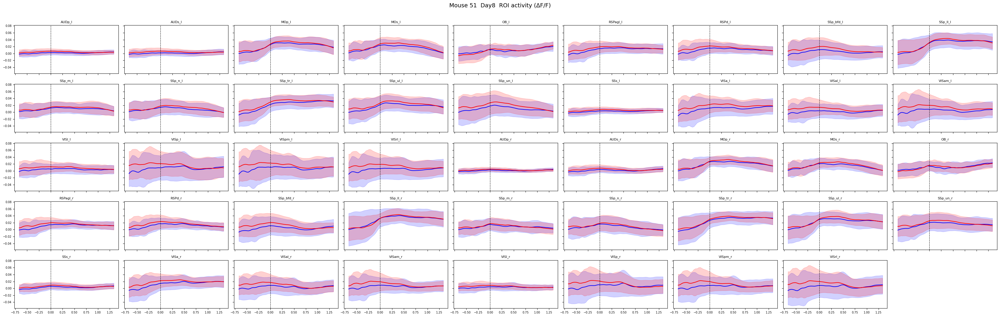


===== Mouse 53  Day8 =====
総有効試行数 : 351
クラスタ中心値   : [0.1665 1.0213]
KMeans しきい値 : 0.5939
フィルタ後試行数 : 141
前半  diff_value  1.043 ± 0.362 reaction_time nan ± nan
後半  diff_value  1.004 ± 0.436 reaction_time nan ± nan


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


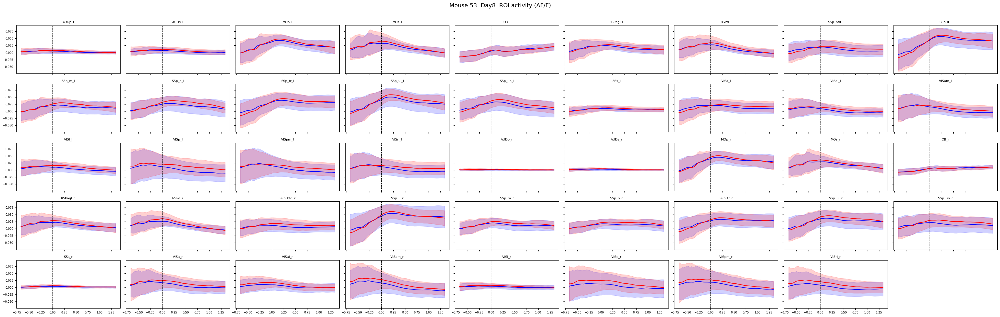


===== Mouse 105  Day8 =====
総有効試行数 : 608
クラスタ中心値   : [0.055  0.8042]
KMeans しきい値 : 0.4296
フィルタ後試行数 : 198
前半  diff_value  0.828 ± 0.218 reaction_time nan ± nan
後半  diff_value  0.781 ± 0.172 reaction_time nan ± nan


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


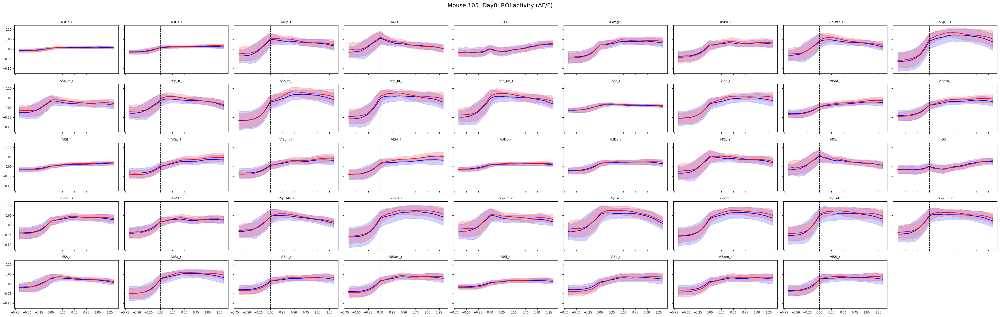


===== Mouse 63  Day8 =====
総有効試行数 : 1309
クラスタ中心値   : [0.1041 0.6996]
KMeans しきい値 : 0.4019
フィルタ後試行数 : 166
前半  diff_value  0.743 ± 0.484 reaction_time 0.119 ± nan
後半  diff_value  0.656 ± 0.281 reaction_time nan ± nan


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


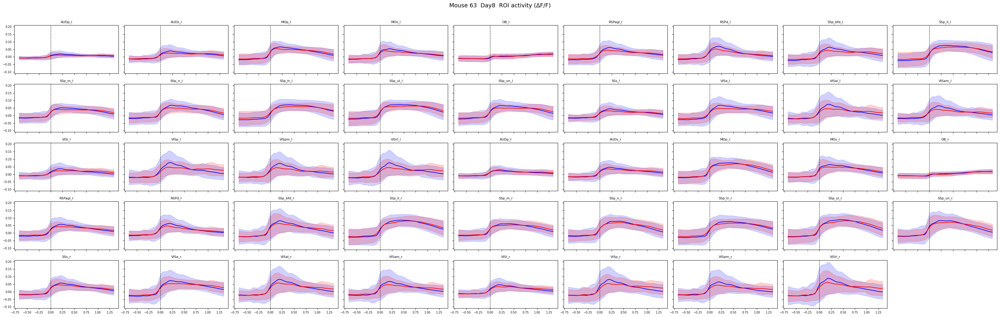


===== Mouse 61  Day8 =====
総有効試行数 : 622
クラスタ中心値   : [0.0855 0.7601]
KMeans しきい値 : 0.4228
フィルタ後試行数 : 76
前半  diff_value  0.764 ± 0.205 reaction_time nan ± nan
後半  diff_value  0.756 ± 0.218 reaction_time nan ± nan


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


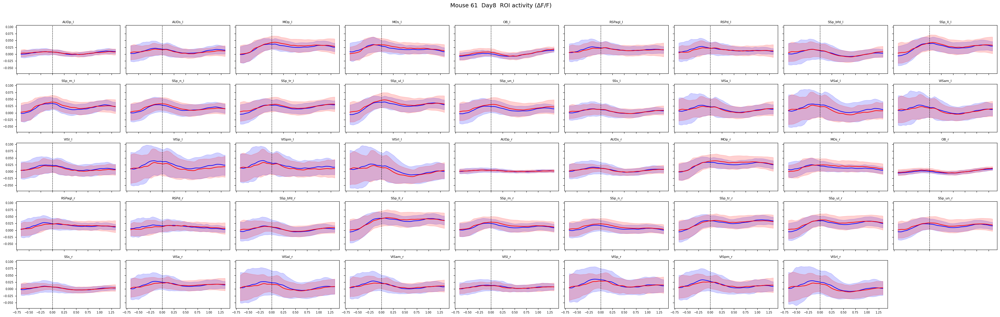


===== Mouse 66  Day8 =====
総有効試行数 : 924
クラスタ中心値   : [0.0765 1.2811]
KMeans しきい値 : 0.6788
フィルタ後試行数 : 60
前半  diff_value  1.401 ± 0.737 reaction_time nan ± nan
後半  diff_value  1.161 ± 0.498 reaction_time nan ± nan


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


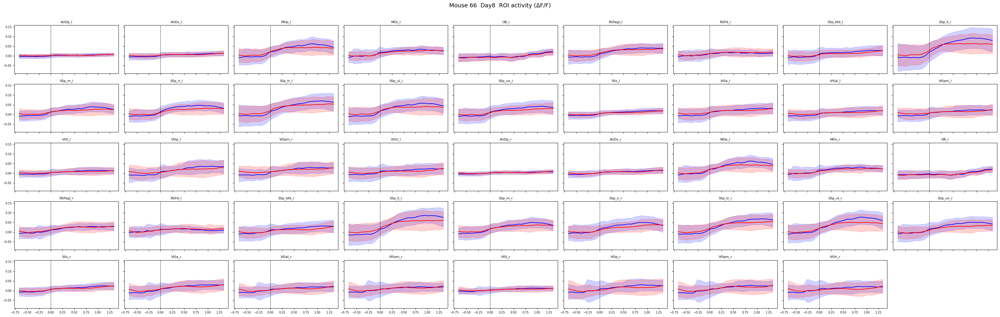


===== Mouse 48  Day8 =====
CSV が見つかりません → スキップ


In [ ]:
#閾値を動的にしてA個体を可視化。前後半50％
import os, warnings
from pathlib import Path
from math import ceil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
warnings.filterwarnings("ignore", category=FutureWarning)

# ---------- 共通設定 ----------
mice_ids   = ["51", "53", "105", "63", "61", "66", "48"]
csv_root   = Path("/content/drive/MyDrive/hackathon_data")
nwb_root   = Path("/content/drive/MyDrive/braidyn-bc/data")
early_N    = 30                      # 前半に使う試行数
pre_s, post_s, fs = 20, 40, 30       # ±サンプル, サンプリングレート
win_len    = pre_s + post_s + 1
time_axis  = (np.arange(win_len) - pre_s) / fs

def summarize_trials(df):
    """平均±SD を辞書で返す"""
    return {k: (df[k].mean(), df[k].std()) for k in ["diff_value", "reaction_time"] if k in df.columns}

for mid in mice_ids:
    print(f"\n===== Mouse {mid}  Day8 =====")
    # ---------- パス探索 ----------
    csv_path = csv_root / f"VG1GC-{mid}" / "task-day8" / "trials_L1L2.csv"
    if not csv_path.exists():
        print("CSV が見つかりません → スキップ")
        continue
    nwb_files = list((nwb_root / f"VG1GC-{mid}").glob("*_task-day8.nwb"))
    if not nwb_files:
        print("NWB が見つかりません → スキップ")
        continue
    nwb_file  = nwb_files[0]

    # ---------- データ読み込み ----------
    trials = pd.read_csv(csv_path)
    valid  = trials[(trials.state_lever == 1) & (trials.state_task == 0)].dropna(subset=["diff_value"])
    print(f"総有効試行数 : {len(valid)}")

    # ---------- 動的閾値推定 ----------
    diff_arr = valid.diff_value.to_numpy().reshape(-1, 1)
    km       = KMeans(n_clusters=2, random_state=42, n_init="auto").fit(diff_arr)
    centers  = np.sort(km.cluster_centers_.flatten())
    thresh   = centers.mean()
    print(f"クラスタ中心値   : {centers.round(4)}")
    print(f"KMeans しきい値 : {thresh:.4f}")

    filt = valid[valid.diff_value > thresh].copy()
    filt["lever_time_nocue"] = filt["t"] - filt["diff_value"]
    print(f"フィルタ後試行数 : {len(filt)}")

    # ---------- 前半 / 後半区分 ----------
    if len(filt) < 2:
        print("試行が少なすぎるため解析スキップ")
        continue
    half = len(filt) // 2
    early = filt.iloc[:half]
    late  = filt.iloc[-half:]

    # ---------- 統計出力 ----------
    for label, dfsub in zip(["前半", "後半"], [early, late]):
        stats = summarize_trials(dfsub)
        dv_mu, dv_sd = stats.get("diff_value", (np.nan, np.nan))
        rt_mu, rt_sd = stats.get("reaction_time", (np.nan, np.nan))
        print(f"{label:<3} diff_value  {dv_mu:.3f} ± {dv_sd:.3f} "
              f"reaction_time {rt_mu:.3f} ± {rt_sd:.3f}")

    # ---------- 脳活動データ ----------
    session  = nwbx.read_nwb(nwb_file)
    rois_df  = session.imaging.data          # index=time, columns=ROI
    times    = rois_df.index.to_numpy()

    def extract(sub):
        roi_trials = {roi: [] for roi in rois_df.columns}
        for t_event in sub.lever_time_nocue:
            idx0 = np.searchsorted(times, t_event)
            start, end = idx0 - pre_s, idx0 + post_s
            if start < 0 or end >= len(times):   # 範囲外は捨てる
                continue
            win = rois_df.iloc[start:end+1]
            for roi in roi_trials:
                roi_trials[roi].append(win[roi].values)
        return roi_trials

    roi_e = extract(early)
    roi_l = extract(late)

    # ---------- 可視化 ----------
    n_rois = len(rois_df.columns)
    n_col  = 9
    n_row  = ceil(n_rois / n_col)
    fig, axes = plt.subplots(n_row, n_col,
                             figsize=(n_col*3.8, n_row*2.2),
                             sharex=True, sharey=True)
    axes = axes.flatten()

    for ax, roi in zip(axes, rois_df.columns):
        if roi_e[roi] and roi_l[roi]:
            arr_e = np.stack(roi_e[roi])
            arr_l = np.stack(roi_l[roi])
            mu_e, sd_e = arr_e.mean(0), arr_e.std(0)
            mu_l, sd_l = arr_l.mean(0), arr_l.std(0)

            ax.plot(time_axis, mu_e, label="early", color="blue")
            ax.fill_between(time_axis, mu_e-sd_e, mu_e+sd_e, alpha=.18, color="blue")

            ax.plot(time_axis, mu_l, label="late",  color="red")
            ax.fill_between(time_axis, mu_l-sd_l, mu_l+sd_l, alpha=.18, color="red")
            ax.set_title(roi, fontsize=8)
            ax.axvline(0, color="k", ls="--", lw=.8)
            ax.tick_params(labelsize=7)

    # 空白パネルを非表示
    for ax in axes[n_rois:]:
        ax.axis("off")

    fig.suptitle(f"Mouse {mid}  Day8  ROI activity (ΔF/F)", fontsize=14)
    fig.tight_layout(rect=[0, 0, 1, 0.97])
    plt.show()   # Colab 環境なら自動表示
    # plt.savefig(f"mouse{mid}_day8_roi_waveforms.png", dpi=300)  # 保存したい場合



===== Mouse 51  Day8 =====
総有効試行数 : 375
フィルタ後試行数 : 104
前半  diff_value  0.729 ± 0.232 reaction_time 0.332 ± nan
後半  diff_value  0.639 ± 0.201 reaction_time 0.295 ± 0.058


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


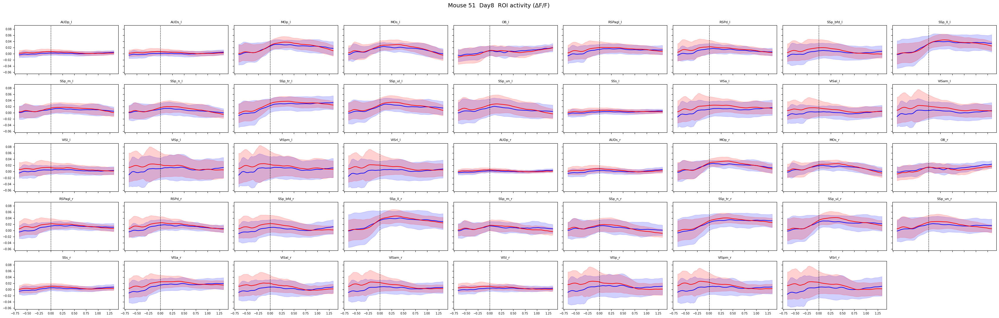


===== Mouse 53  Day8 =====
総有効試行数 : 351
フィルタ後試行数 : 186
前半  diff_value  0.927 ± 0.384 reaction_time nan ± nan
後半  diff_value  0.879 ± 0.470 reaction_time nan ± nan


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


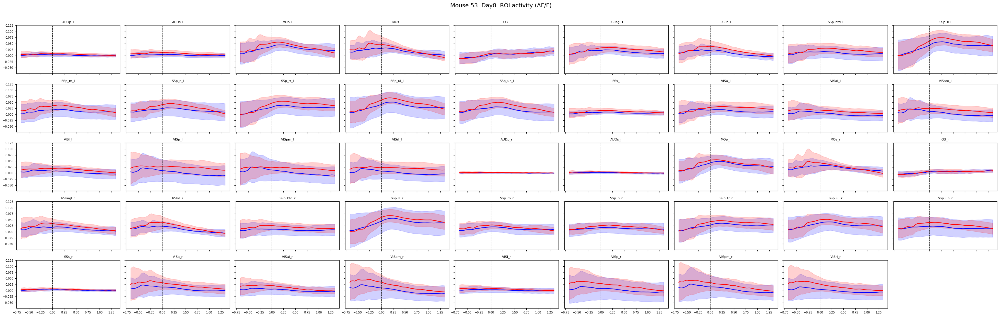


===== Mouse 105  Day8 =====
総有効試行数 : 608
フィルタ後試行数 : 200
前半  diff_value  0.800 ± 0.164 reaction_time nan ± nan
後半  diff_value  0.763 ± 0.199 reaction_time nan ± nan


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


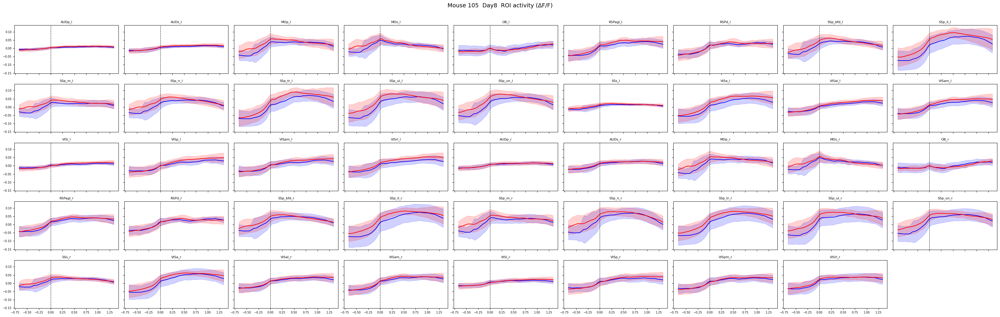


===== Mouse 63  Day8 =====
総有効試行数 : 1309
フィルタ後試行数 : 182
前半  diff_value  0.781 ± 0.479 reaction_time nan ± nan
後半  diff_value  0.642 ± 0.255 reaction_time nan ± nan


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


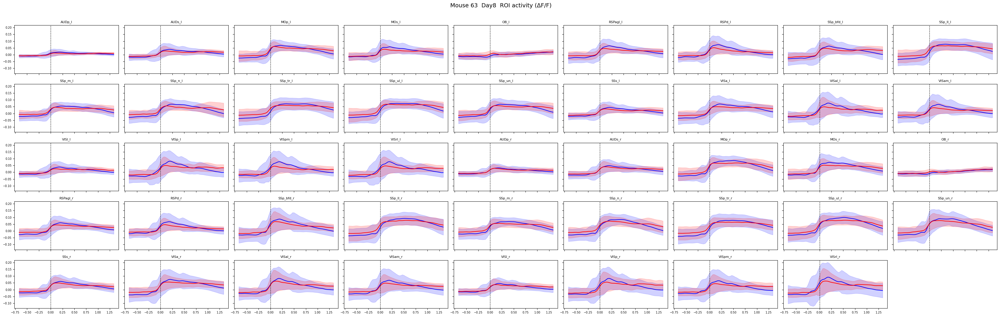


===== Mouse 61  Day8 =====
総有効試行数 : 622
フィルタ後試行数 : 79
前半  diff_value  0.753 ± 0.216 reaction_time nan ± nan
後半  diff_value  0.691 ± 0.220 reaction_time nan ± nan


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


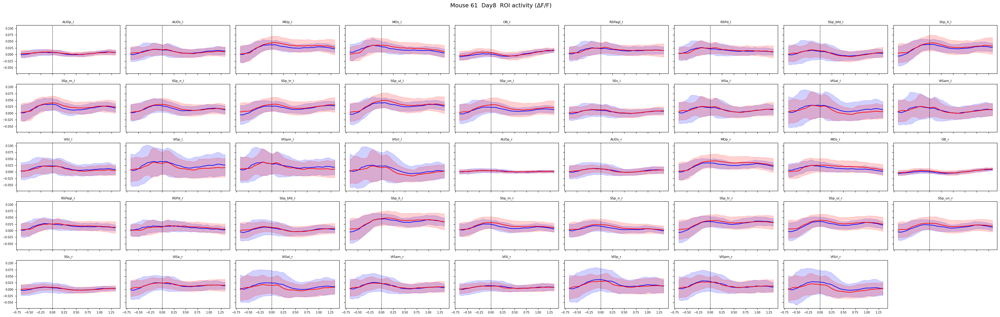


===== Mouse 66  Day8 =====
総有効試行数 : 924
フィルタ後試行数 : 101
前半  diff_value  1.142 ± 0.658 reaction_time nan ± nan
後半  diff_value  0.861 ± 0.573 reaction_time nan ± nan


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


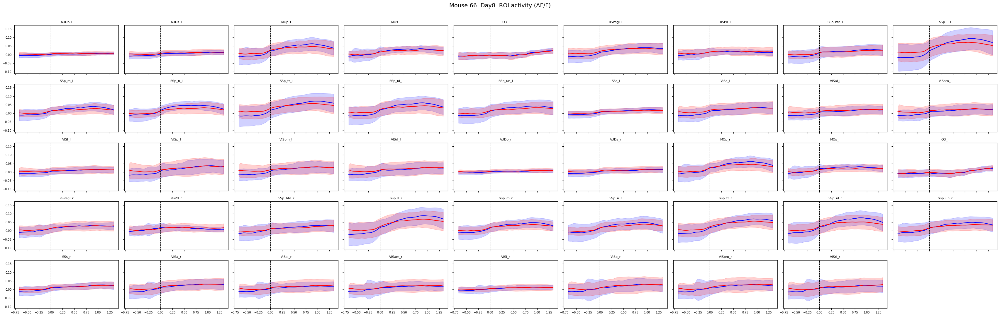


===== Mouse 48  Day8 =====
CSV が見つかりません → スキップ


In [ ]:
#閾値を0.4にしてA個体を可視化、前半後半30ずつ。
import os, warnings
from pathlib import Path
from math import ceil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
warnings.filterwarnings("ignore", category=FutureWarning)

# ---------- 共通設定 ----------
mice_ids   = ["51", "53", "105", "63", "61", "66", "48"]
csv_root   = Path("/content/drive/MyDrive/hackathon_data")
nwb_root   = Path("/content/drive/MyDrive/braidyn-bc/data")
early_N    = 30                      # 前半に使う試行数
pre_s, post_s, fs = 20, 40, 30       # ±サンプル, サンプリングレート
win_len    = pre_s + post_s + 1
time_axis  = (np.arange(win_len) - pre_s) / fs
thresh=0.4

def summarize_trials(df):
    """平均±SD を辞書で返す"""
    return {k: (df[k].mean(), df[k].std()) for k in ["diff_value", "reaction_time"] if k in df.columns}

for mid in mice_ids:
    print(f"\n===== Mouse {mid}  Day8 =====")
    # ---------- パス探索 ----------
    csv_path = csv_root / f"VG1GC-{mid}" / "task-day8" / "trials_L1L2.csv"
    if not csv_path.exists():
        print("CSV が見つかりません → スキップ")
        continue
    nwb_files = list((nwb_root / f"VG1GC-{mid}").glob("*_task-day8.nwb"))
    if not nwb_files:
        print("NWB が見つかりません → スキップ")
        continue
    nwb_file  = nwb_files[0]

    # ---------- データ読み込み ----------
    trials = pd.read_csv(csv_path)
    valid  = trials[(trials.state_lever == 1) & (trials.state_task == 0)].dropna(subset=["diff_value"])
    print(f"総有効試行数 : {len(valid)}")

    filt = valid[valid.diff_value > thresh].copy()
    filt["lever_time_nocue"] = filt["t"] - filt["diff_value"]
    print(f"フィルタ後試行数 : {len(filt)}")

    # ---------- 前半 / 後半区分 ----------
    if len(filt) < 2:
        print("試行が少なすぎるため解析スキップ")
        continue
    half = len(filt) // 2 if len(filt) < 2*early_N else early_N
    early = filt.iloc[:half]
    late  = filt.iloc[-half:]

    # ---------- 統計出力 ----------
    for label, dfsub in zip(["前半", "後半"], [early, late]):
        stats = summarize_trials(dfsub)
        dv_mu, dv_sd = stats.get("diff_value", (np.nan, np.nan))
        rt_mu, rt_sd = stats.get("reaction_time", (np.nan, np.nan))
        print(f"{label:<3} diff_value  {dv_mu:.3f} ± {dv_sd:.3f} "
              f"reaction_time {rt_mu:.3f} ± {rt_sd:.3f}")

    # ---------- 脳活動データ ----------
    session  = nwbx.read_nwb(nwb_file)
    rois_df  = session.imaging.data          # index=time, columns=ROI
    times    = rois_df.index.to_numpy()

    def extract(sub):
        roi_trials = {roi: [] for roi in rois_df.columns}
        for t_event in sub.lever_time_nocue:
            idx0 = np.searchsorted(times, t_event)
            start, end = idx0 - pre_s, idx0 + post_s
            if start < 0 or end >= len(times):   # 範囲外は捨てる
                continue
            win = rois_df.iloc[start:end+1]
            for roi in roi_trials:
                roi_trials[roi].append(win[roi].values)
        return roi_trials

    roi_e = extract(early)
    roi_l = extract(late)

    # ---------- 可視化 ----------
    n_rois = len(rois_df.columns)
    n_col  = 9
    n_row  = ceil(n_rois / n_col)
    fig, axes = plt.subplots(n_row, n_col,
                             figsize=(n_col*3.8, n_row*2.2),
                             sharex=True, sharey=True)
    axes = axes.flatten()

    for ax, roi in zip(axes, rois_df.columns):
        if roi_e[roi] and roi_l[roi]:
            arr_e = np.stack(roi_e[roi])
            arr_l = np.stack(roi_l[roi])
            mu_e, sd_e = arr_e.mean(0), arr_e.std(0)
            mu_l, sd_l = arr_l.mean(0), arr_l.std(0)

            ax.plot(time_axis, mu_e, label="early", color="blue")
            ax.fill_between(time_axis, mu_e-sd_e, mu_e+sd_e, alpha=.18, color="blue")

            ax.plot(time_axis, mu_l, label="late",  color="red")
            ax.fill_between(time_axis, mu_l-sd_l, mu_l+sd_l, alpha=.18, color="red")
            ax.set_title(roi, fontsize=8)
            ax.axvline(0, color="k", ls="--", lw=.8)
            ax.tick_params(labelsize=7)

    # 空白パネルを非表示
    for ax in axes[n_rois:]:
        ax.axis("off")

    fig.suptitle(f"Mouse {mid}  Day8  ROI activity (ΔF/F)", fontsize=14)
    fig.tight_layout(rect=[0, 0, 1, 0.97])
    plt.show()   # Colab 環境なら自動表示
    # plt.savefig(f"mouse{mid}_day8_roi_waveforms.png", dpi=300)  # 保存したい場合



===== Mouse 51  Day8 =====


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."



===== Mouse 53  Day8 =====


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."



===== Mouse 105  Day8 =====


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."



===== Mouse 63  Day8 =====


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."



===== Mouse 61  Day8 =====


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."



===== Mouse 66  Day8 =====


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."



===== Mouse 48  Day8 =====
CSV が見つかりません → スキップ


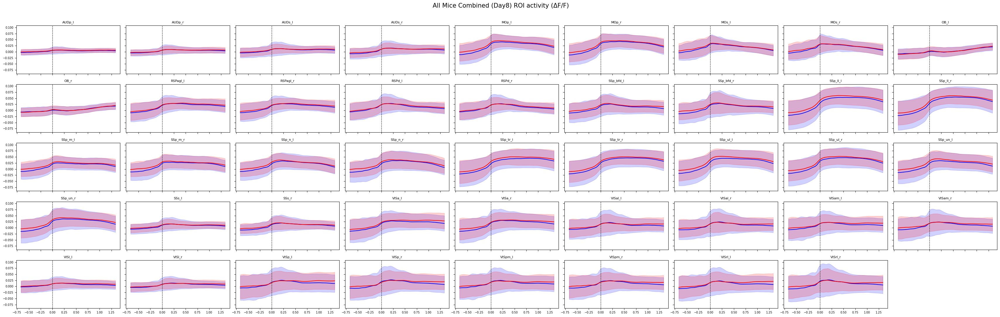

In [ ]:
#閾値を0.4にしてA個体を可視化、前半後半50ずつ。。全個体をまとめて表示

import os, warnings
from pathlib import Path
from math import ceil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
warnings.filterwarnings("ignore", category=FutureWarning)

# ---------- 共通設定 ----------
mice_ids   = ["51", "53", "105", "63", "61", "66", "48"]
csv_root   = Path("/content/drive/MyDrive/hackathon_data")
nwb_root   = Path("/content/drive/MyDrive/braidyn-bc/data")
early_N    = 50                      # 前半に使う試行数
pre_s, post_s, fs = 20, 40, 30       # ±サンプル, サンプリングレート
win_len    = pre_s + post_s + 1
time_axis  = (np.arange(win_len) - pre_s) / fs
thresh=0.4

# --- 集約用データ ---
all_early = {}  # {roi: [np.array, np.array, ...]}
all_late  = {}

# --- 全個体をループ ---
for mid in mice_ids:
    print(f"\n===== Mouse {mid}  Day8 =====")
    csv_path = csv_root / f"VG1GC-{mid}" / "task-day8" / "trials_L1L2.csv"
    if not csv_path.exists():
        print("CSV が見つかりません → スキップ")
        continue
    nwb_files = list((nwb_root / f"VG1GC-{mid}").glob("*_task-day8.nwb"))
    if not nwb_files:
        print("NWB が見つかりません → スキップ")
        continue
    nwb_file = nwb_files[0]

    trials = pd.read_csv(csv_path)
    valid = trials[(trials.state_lever == 1) & (trials.state_task == 0)].dropna(subset=["diff_value"])
    filt = valid[valid.diff_value > thresh].copy()
    filt["lever_time_nocue"] = filt["t"] - filt["diff_value"]

    if len(filt) < 2:
        print("試行が少なすぎるため解析スキップ")
        continue
    half = len(filt) // 2 if len(filt) < 2 * early_N else early_N
    early = filt.iloc[:half]
    late = filt.iloc[-half:]

    session = nwbx.read_nwb(nwb_file)
    rois_df = session.imaging.data
    times = rois_df.index.to_numpy()

    def extract(sub):
        roi_trials = {roi: [] for roi in rois_df.columns}
        for t_event in sub.lever_time_nocue:
            idx0 = np.searchsorted(times, t_event)
            start, end = idx0 - pre_s, idx0 + post_s
            if start < 0 or end >= len(times):
                continue
            win = rois_df.iloc[start:end+1]
            for roi in roi_trials:
                roi_trials[roi].append(win[roi].values)
        return roi_trials

    roi_e = extract(early)
    roi_l = extract(late)

    for roi in rois_df.columns:
        if roi_e[roi] and roi_l[roi]:
            arr_e = np.stack(roi_e[roi])
            arr_l = np.stack(roi_l[roi])
            all_early.setdefault(roi, []).append(arr_e)
            all_late.setdefault(roi, []).append(arr_l)

# --- 個体全体の平均・SDを可視化 ---
n_rois = len(all_early)
n_col = 9
n_row = ceil(n_rois / n_col)
fig, axes = plt.subplots(n_row, n_col,
                         figsize=(n_col*3.8, n_row*2.2),
                         sharex=True, sharey=True)
axes = axes.flatten()

for ax, roi in zip(axes, sorted(all_early.keys())):
    try:
        arr_e = np.concatenate(all_early[roi], axis=0)
        arr_l = np.concatenate(all_late[roi], axis=0)
    except:
        continue

    mu_e, sd_e = arr_e.mean(0), arr_e.std(0)
    mu_l, sd_l = arr_l.mean(0), arr_l.std(0)

    ax.plot(time_axis, mu_e, label="early", color="blue")
    ax.fill_between(time_axis, mu_e - sd_e, mu_e + sd_e, alpha=0.18, color="blue")

    ax.plot(time_axis, mu_l, label="late", color="red")
    ax.fill_between(time_axis, mu_l - sd_l, mu_l + sd_l, alpha=0.18, color="red")

    ax.set_title(roi, fontsize=8)
    ax.axvline(0, color="k", ls="--", lw=0.8)
    ax.tick_params(labelsize=7)

# 空白パネルを非表示
for ax in axes[n_rois:]:
    ax.axis("off")

fig.suptitle("All Mice Combined (Day8) ROI activity (ΔF/F)", fontsize=15)
fig.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()

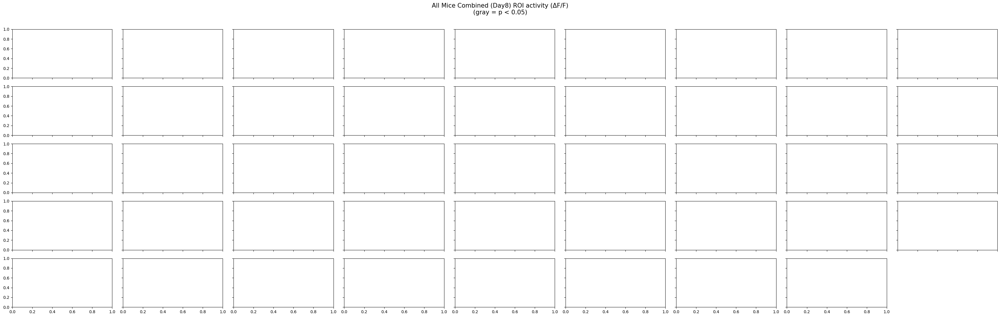

In [ ]:
from scipy.stats import ttest_ind

alpha = 0.05
n_rois = len(all_early)
n_col = 9
n_row = ceil(n_rois / n_col)

fig, axes = plt.subplots(n_row, n_col,
                         figsize=(n_col*3.8, n_row*2.2),
                         sharex=True, sharey=True)
axes = axes.flatten()

for ax, roi in zip(axes, sorted(all_early.keys())):
    try:
        early_trials = np.stack(all_early[roi])  # shape: (n_trials, n_timepoints)
        late_trials  = np.stack(all_late[roi])
    except:
        continue

    mu_e, sd_e = early_trials.mean(0), early_trials.std(0)
    mu_l, sd_l = late_trials.mean(0), late_trials.std(0)

    # 有意差検定
    t_vals, p_vals = ttest_ind(early_trials, late_trials, axis=0, equal_var=False, nan_policy='omit')
    sig_mask = p_vals < alpha

    # まず線を描画
    ax.plot(time_axis, mu_e, label="early", color="blue")
    ax.fill_between(time_axis, mu_e - sd_e, mu_e + sd_e, alpha=0.18, color="blue")

    ax.plot(time_axis, mu_l, label="late", color="red")
    ax.fill_between(time_axis, mu_l - sd_l, mu_l + sd_l, alpha=0.18, color="red")

    # y範囲を取得（描画後に）
    y_min, y_max = ax.get_ylim()

    # 有意差帯の塗りつぶし（各点を個別に処理して表示されるようにする）
    ax.fill_between(time_axis, y_min, y_max, where=sig_mask, color='gray', alpha=0.25)

    ax.set_title(roi, fontsize=8)
    ax.axvline(0, color="k", ls="--", lw=0.8)
    ax.tick_params(labelsize=7)

for ax in axes[n_rois:]:
    ax.axis("off")

fig.suptitle("All Mice Combined (Day8) ROI activity (ΔF/F)\n(gray = p < 0.05)", fontsize=15)
fig.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()



In [ ]:
df=pd.read_csv(pd.items(all_early))

AttributeError: module 'pandas' has no attribute 'items'

In [ ]:
# t検定の結果だけを一旦確認
from scipy.stats import ttest_ind

for roi in sorted(all_early.keys()):
    try:
        early_trials = np.stack(all_early[roi])
        late_trials  = np.stack(all_late[roi])
    except:
        continue

    _, p_vals = ttest_ind(early_trials, late_trials, axis=0, equal_var=False, nan_policy='omit')
print(f"{roi}: min(p) = {p_vals.min():.5f}, num(p < 0.05) = {(p_vals < 0.05).sum()}")


VISrl_r: min(p) = 0.00037, num(p < 0.05) = 14


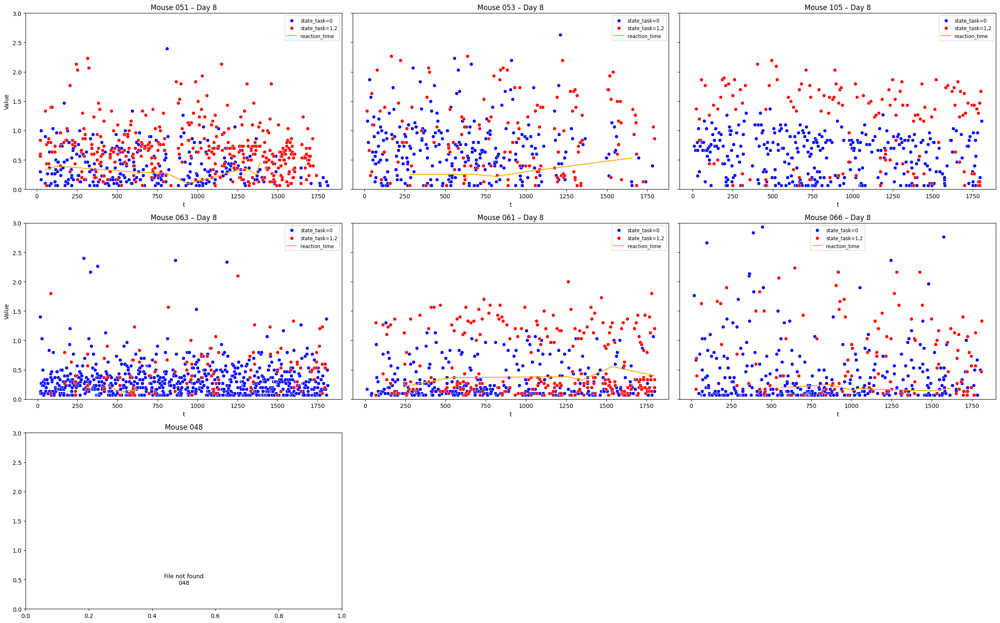

In [ ]:
#クラスタAのDAY８のレバー引き時間を可視化。pull?durationも消えてるし、reaction_timeの点もなくなっている

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os, math

# 対象個体とパスのひな形
subjects = ["051", "053", "105", "063", "061", "066", "048"]
path_tpl  = "/content/drive/MyDrive/hackathon_data/VG1GC-{}/task-day8/trials_L1L2.csv"

# プロット設定
th_low, th_high = 0.04, 3.0       # diff_value の範囲
y_min, y_max    = 0, 3            # y 軸共通スケール
n_cols          = 3               # 列数（好みで変更可）
n_rows          = math.ceil(len(subjects) / n_cols)

fig, axes = plt.subplots(n_rows, n_cols,
                         figsize=(8 * n_cols, 5 * n_rows),
                         sharey=True)
axes = axes.flatten()

for i, sid in enumerate(subjects):
    ax = axes[i]

    # 先頭ゼロあり／なしの両方を試す
    candidate_paths = [
        path_tpl.format(sid.lstrip("0")),   # 例: 051 → 51
        path_tpl.format(sid)                # 例: 051
    ]
    file_path = next((p for p in candidate_paths if os.path.exists(p)), None)

    if file_path is None:
        ax.text(0.5, 0.5, f"File not found\n{sid}", ha="center", va="center")
        ax.set_title(f"Mouse {sid}")
        continue

    df = pd.read_csv(file_path)

    # 条件フィルタ
    mask = (df["diff_value"] > th_low) & (df["diff_value"] < th_high)
    df = df[mask]

    # state_task 別に描画
    df0  = df[df["state_task"] == 0]
    df12 = df[df["state_task"].isin([1, 2])]

    sns.scatterplot(data=df0,  x="t", y="diff_value",
                    color="blue",  label="state_task=0",  ax=ax)
    sns.scatterplot(data=df12, x="t", y="diff_value",
                    color="red",   label="state_task=1,2", ax=ax)

    # reaction_time がある場合
    if "reaction_time" in df.columns:
        sns.lineplot(data=df, x="t", y="reaction_time",
                     color="orange", label="reaction_time", ax=ax)

    ax.set_title(f"Mouse {sid} – Day 8")
    ax.set_xlabel("t")
    ax.set_ylabel("Value")
    ax.set_ylim(y_min, y_max)
    ax.legend(fontsize="small")

# 余った sub-axes を消す（7匹→9枠中2枠空き）
for j in range(len(subjects), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


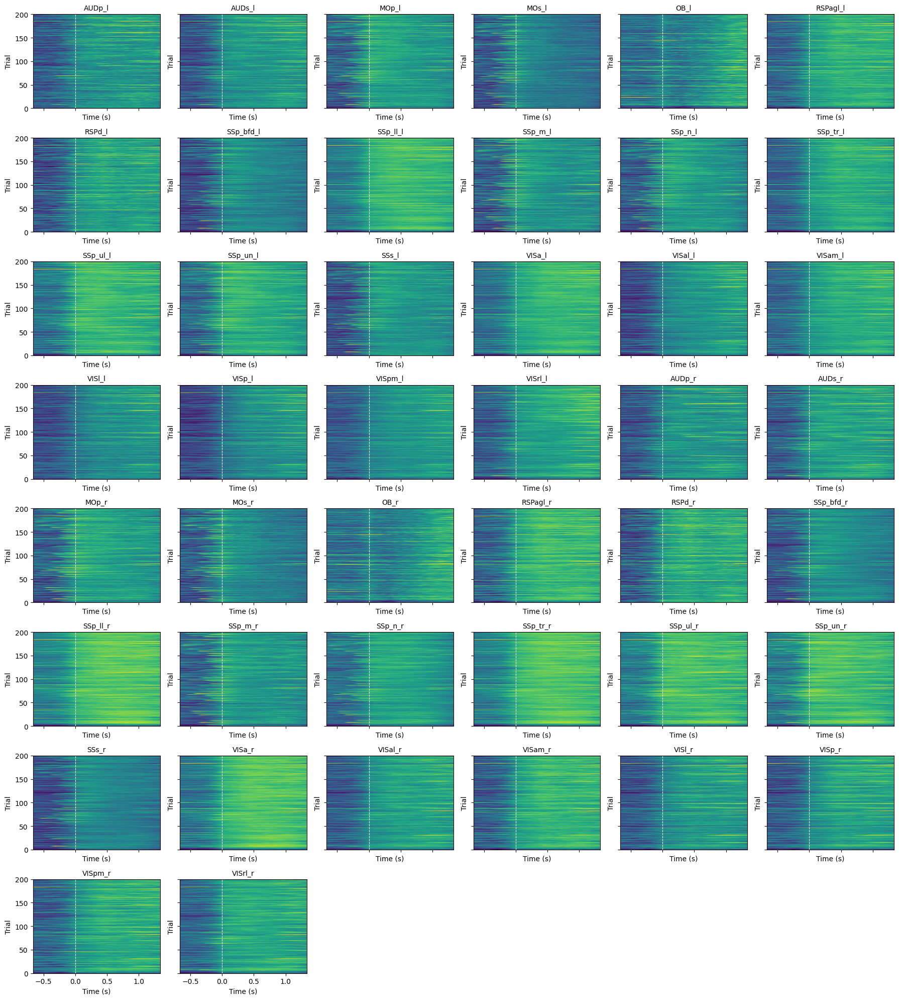

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from math import ceil

# --- ヒートマップ描画用関数 ---
def plot_roi_heatmaps(roi_trials_dict, time_axis, title_prefix=""):
    n_rois = len(roi_trials_dict)
    n_cols = 6
    n_rows = ceil(n_rois / n_cols)

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*3, n_rows*2.5), sharex=True, sharey=True)
    axes = axes.flatten()

    for ax, (roi, trials) in zip(axes, roi_trials_dict.items()):
        if len(trials) == 0:
            ax.axis('off')
            continue
        data = np.stack(trials)  # shape: (n_trials, n_timepoints)
        im = ax.imshow(data, aspect='auto', cmap='viridis',
                       extent=[time_axis[0], time_axis[-1], 0, data.shape[0]],
                       origin='lower')
        ax.axvline(0, color='white', linestyle='--', linewidth=0.8)
        ax.set_title(f"{title_prefix}{roi}", fontsize=10)
        ax.set_xlabel('Time (s)')
        ax.set_ylabel('Trial')

    for ax in axes[n_rois:]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# --- 試行抽出（音なしレバー引きすべて） ---
roi_trials_all = extract_roi_trials(filtered_trials)

# --- ヒートマップ描画 ---
plot_roi_heatmaps(roi_trials_all, time_axis)


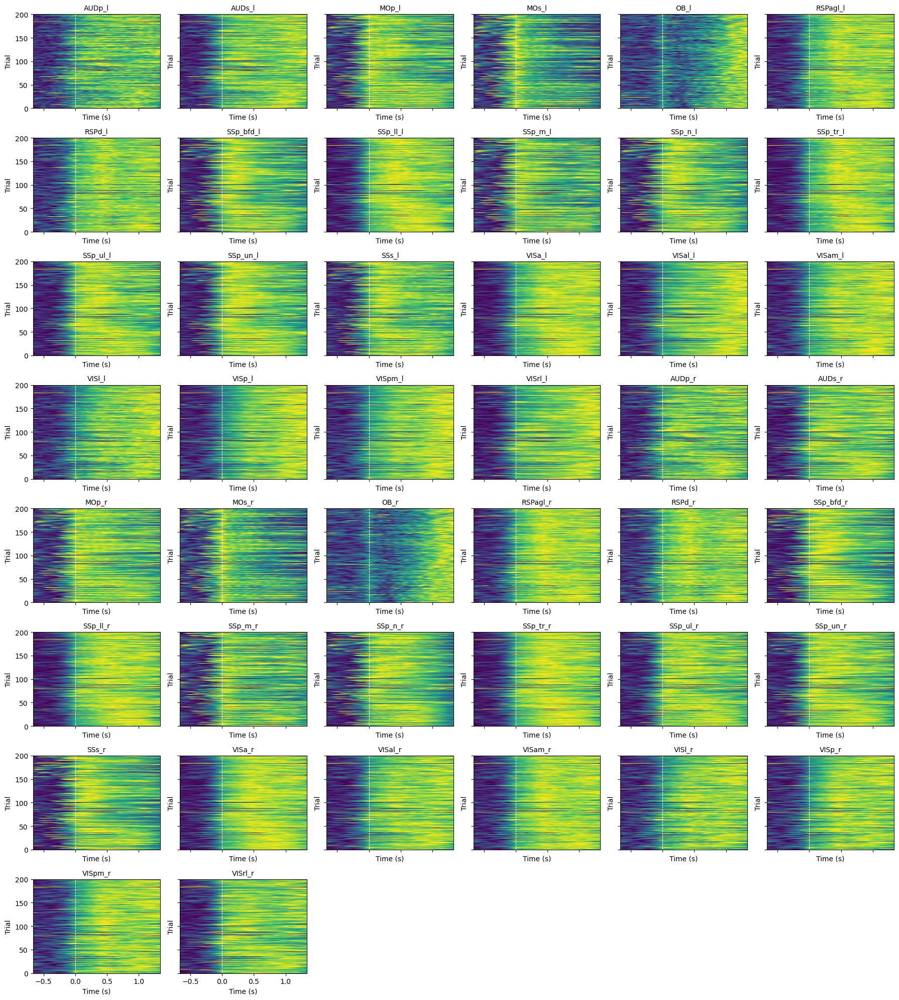

In [ ]:
#正規化して見やすくした（コード未確認
import numpy as np
import matplotlib.pyplot as plt
from math import ceil

# --- ヒートマップ描画用関数 ---
def plot_roi_heatmaps(roi_trials_dict, time_axis, title_prefix=""):
    n_rois = len(roi_trials_dict)
    n_cols = 6
    n_rows = ceil(n_rois / n_cols)

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*3, n_rows*2.5), sharex=True, sharey=True)
    axes = axes.flatten()

    for ax, (roi, trials) in zip(axes, roi_trials_dict.items()):
        if len(trials) == 0:
            ax.axis('off')
            continue
        data = np.stack(trials)  # shape: (n_trials, n_timepoints)
        normalized_data = (data.T - data.min(axis=1)) / (data.max(axis=1) - data.min(axis=1) + 1e-8)
        data = normalized_data.T
        im = ax.imshow(data, aspect='auto', cmap='viridis',
                       extent=[time_axis[0], time_axis[-1], 0, data.shape[0]],
                       origin='lower')
        ax.axvline(0, color='white', linestyle='--', linewidth=0.8)
        ax.set_title(f"{title_prefix}{roi}", fontsize=10)
        ax.set_xlabel('Time (s)')
        ax.set_ylabel('Trial')

    for ax in axes[n_rois:]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# --- 試行抽出（音なしレバー引きすべて） ---
roi_trials_all = extract_roi_trials(filtered_trials)

# --- ヒートマップ描画 ---
plot_roi_heatmaps(roi_trials_all, time_axis)


##セッション内のいつ試行が起きているか

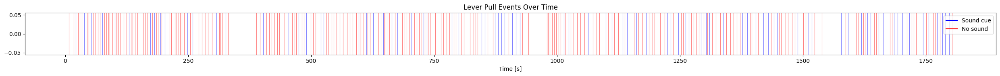

In [ ]:
import matplotlib.pyplot as plt

# import pandas as pd
# # CSVファイルの読み込み
# csv_path = Path('/content/drive/MyDrive/VG1GC-105/VG1GC-105/task-day8/trials_L1L2.csv')
# trials = pd.read_csv(csv_path)
# print("全試行数:", len(trials))

# # 条件に合致する行のフィルタリング
# filtered_trials = trials[(trials['state_lever']==1) &
#                          (trials['state_task'] == 0) &
#                          (trials['diff_value'] > 0.4)].copy()
# print("フィルタリング後の試行数:", len(filtered_trials))

# # lever_time_nocueの算出：tからdiff_valueを引いた時刻
# filtered_trials['lever_time_nocue'] = filtered_trials['t'] - filtered_trials['diff_value']

#====
# filtered = trials.dropna(subset=['trial_outcome'])
# filtered = filtered[
#     (filtered['first_diff'] > 1.0) &
#     (filtered['reaction_time'] > 0.091) &
#     (filtered['reaction_time'] < 0.361)
# ].copy()

# --- 時間データ ---
sound_onsets = filtered['pull_onset']
no_sound_onsets = filtered_trials['lever_time_nocue']

# --- プロット ---
plt.figure(figsize=(25, 2))

# 音あり：縦線（青）
for t in sound_onsets:
    plt.axvline(t, color='blue', alpha=0.5, linewidth=0.8)

# 音なし：縦線（赤）
for t in no_sound_onsets:
    plt.axvline(t, color='red', alpha=0.5, linewidth=0.8)

# 凡例用のダミー線
plt.plot([], [], color='blue', label='Sound cue')
plt.plot([], [], color='red', label='No sound')

# 軸とラベル
plt.xlabel('Time [s]')
plt.title('Lever Pull Events Over Time')
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()


フィルタリング後の試行数: 186


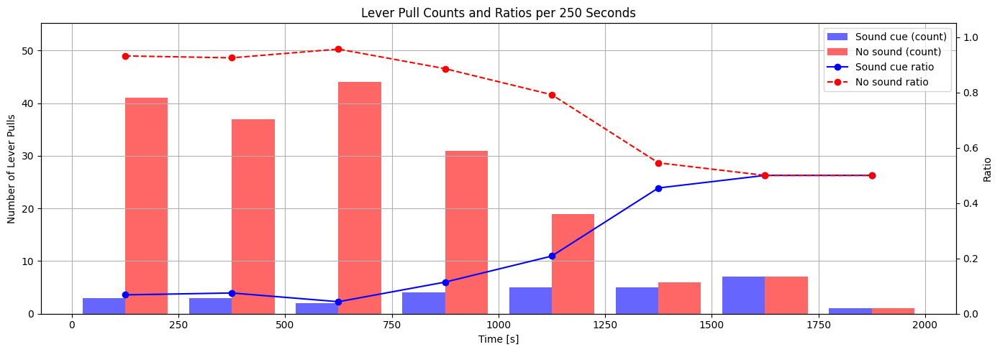

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

csv_path = Path('/content/drive/MyDrive/hackathon_data/VG1GC-53/task-day8/trials_L1L2.csv')
trials = pd.read_csv(csv_path)
filtered_trials = trials[(trials['state_lever']==1) &
                         (trials['state_task'] == 0) &
                         (trials['diff_value'] > 0.4)].copy()
print("フィルタリング後の試行数:", len(filtered_trials))

# lever_time_nocueの算出：tからdiff_valueを引いた時刻
filtered_trials['lever_time_nocue'] = filtered_trials['t'] - filtered_trials['diff_value']


filtered = trials.dropna(subset=['trial_outcome'])
filtered = filtered[
    (filtered['first_diff'] > 1.0) &
    (filtered['reaction_time'] > 0.091) &
    (filtered['reaction_time'] < 0.361)
].copy()

# --- 時間データ ---
sound_onsets = filtered['pull_onset']
no_sound_onsets = filtered_trials['lever_time_nocue']

# --- パラメータ ---
bin_width = 250  # 秒
max_time = max(sound_onsets.max(), no_sound_onsets.max())
bins = np.arange(0, max_time + bin_width, bin_width)
bin_centers = (bins[:-1] + bins[1:]) / 2
width = bin_width * 0.4

# --- カウント ---
hist_sound, _ = np.histogram(sound_onsets, bins=bins)
hist_nosound, _ = np.histogram(no_sound_onsets, bins=bins)
total = hist_sound + hist_nosound

# --- 比率（割合） ---
ratio_sound = np.divide(hist_sound, total, out=np.zeros_like(hist_sound, dtype=float), where=total!=0)
ratio_nosound = np.divide(hist_nosound, total, out=np.zeros_like(hist_nosound, dtype=float), where=total!=0)

# --- プロット作成 ---
fig, ax1 = plt.subplots(figsize=(14, 5))

# --- 棒グラフ（回数） ---
ax1.bar(bin_centers - width/2, hist_sound, width=width, color='blue', alpha=0.6, label='Sound cue (count)')
ax1.bar(bin_centers + width/2, hist_nosound, width=width, color='red', alpha=0.6, label='No sound (count)')
ax1.set_ylabel('Number of Lever Pulls')
ax1.set_xlabel('Time [s]')
ax1.set_ylim(0, max(total)*1.2)

# --- 折れ線グラフ（割合） ---
ax2 = ax1.twinx()
ax2.plot(bin_centers, ratio_sound, marker='o', color='blue', linestyle='-', label='Sound cue ratio')
ax2.plot(bin_centers, ratio_nosound, marker='o', color='red', linestyle='--', label='No sound ratio')
ax2.set_ylabel('Ratio')
ax2.set_ylim(0, 1.05)

# --- 凡例とグリッド ---
lines_1, labels_1 = ax1.get_legend_handles_labels()
lines_2, labels_2 = ax2.get_legend_handles_labels()
ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='upper right')

ax1.grid(True)
plt.title('Lever Pull Counts and Ratios per 250 Seconds')
plt.tight_layout()
plt.show()


FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/hackathon_data/VG1GC-48/task-day3/trials_L1L2.csv'

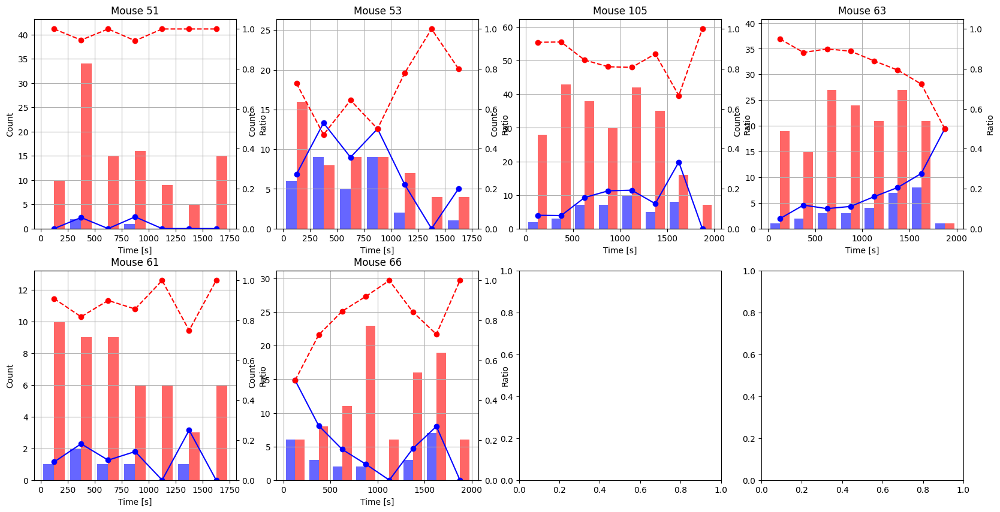

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

# === パラメータ設定 ===
mouse_ids = ["51", "53", "105", "63", "61", "66", "48"]
csv_root = Path('/content/drive/MyDrive/hackathon_data')
bin_width = 250  # 秒
width_ratio = 0.4

# === 図の設定 ===
fig, axes = plt.subplots(2, 4, figsize=(20, 10))
axes = axes.flatten()

for i, mouse_id in enumerate(mouse_ids):
    # === データ読み込み ===
    csv_path = csv_root / f"VG1GC-{mouse_id}/task-day3/trials_L1L2.csv"
    trials = pd.read_csv(csv_path)

    # === 音なしレバー引き（diff_value > 0.4）===
    filtered_trials = trials[(trials['state_lever'] == 1) &
                             (trials['state_task'] == 0) &
                             (trials['diff_value'] > 0.4)].copy()
    filtered_trials['lever_time_nocue'] = filtered_trials['t'] - filtered_trials['diff_value']

    # === 音ありレバー引き（反応時間フィルタ）===
    filtered = trials.dropna(subset=['trial_outcome']).copy()
    filtered = filtered[
        (filtered['first_diff'] > 1.0) &
        (filtered['reaction_time'] > 0.091) &
        (filtered['reaction_time'] < 0.361)
    ].copy()

    sound_onsets = filtered['pull_onset']
    no_sound_onsets = filtered_trials['lever_time_nocue']

    # === ヒストグラム用のビン ===
    max_time = max(sound_onsets.max(), no_sound_onsets.max())
    bins = np.arange(0, max_time + bin_width, bin_width)
    bin_centers = (bins[:-1] + bins[1:]) / 2
    width = bin_width * width_ratio

    # === カウントと比率計算 ===
    hist_sound, _ = np.histogram(sound_onsets, bins=bins)
    hist_nosound, _ = np.histogram(no_sound_onsets, bins=bins)
    total = hist_sound + hist_nosound
    ratio_sound = np.divide(hist_sound, total, out=np.zeros_like(hist_sound, dtype=float), where=total != 0)
    ratio_nosound = np.divide(hist_nosound, total, out=np.zeros_like(hist_nosound, dtype=float), where=total != 0)

    # === プロット ===
    ax1 = axes[i]
    ax2 = ax1.twinx()

    ax1.bar(bin_centers - width/2, hist_sound, width=width, color='blue', alpha=0.6)
    ax1.bar(bin_centers + width/2, hist_nosound, width=width, color='red', alpha=0.6)
    ax2.plot(bin_centers, ratio_sound, marker='o', color='blue', linestyle='-')
    ax2.plot(bin_centers, ratio_nosound, marker='o', color='red', linestyle='--')

    ax1.set_title(f"Mouse {mouse_id}")
    ax1.set_ylim(0, max(total) * 1.2)
    ax2.set_ylim(0, 1.05)
    ax1.set_xlabel('Time [s]')
    ax1.set_ylabel('Count')
    ax2.set_ylabel('Ratio')
    ax1.grid(True)

# 不要なプロット枠を非表示
for j in range(len(mouse_ids), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.suptitle('Lever Pulls: Count and Ratio per 250s (Sound vs No-sound)', fontsize=16, y=1.02)
plt.show()


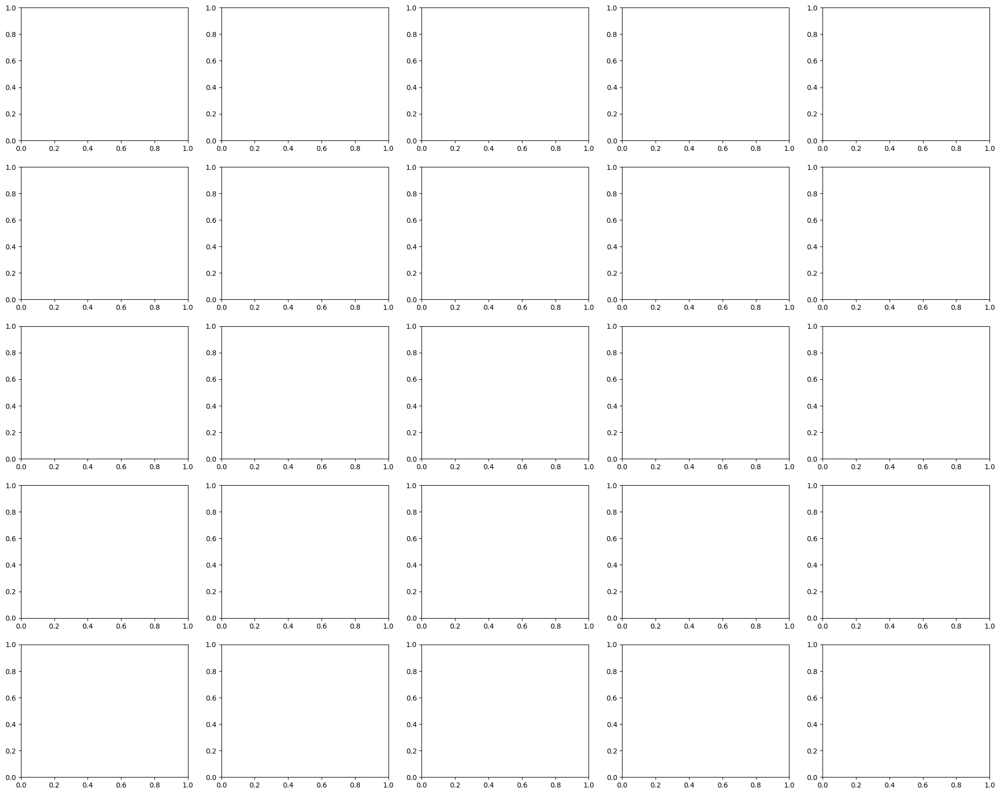

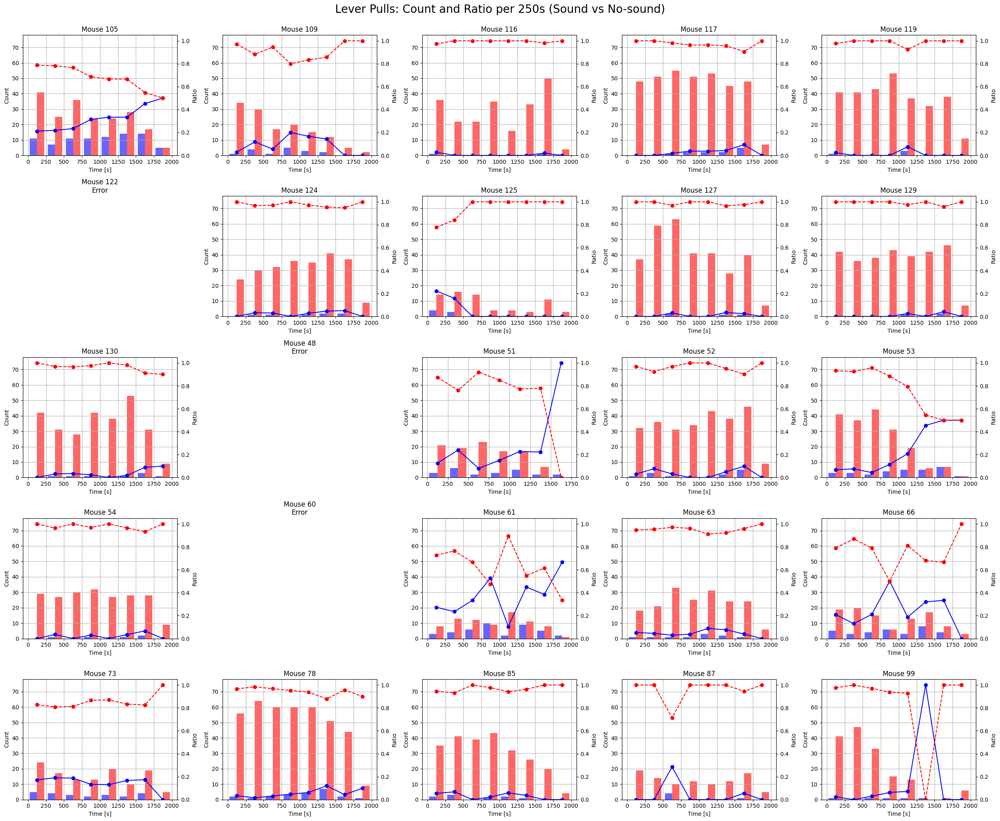

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

csv_path = Path('/content/drive/MyDrive/hackathon_data/VG1GC-53/task-day8/trials_L1L2.csv')
trials = pd.read_csv(csv_path)
filtered_trials = trials[(trials['state_lever']==1) &
                         (trials['state_task'] == 0) &
                         (trials['diff_value'] > 0.4)].copy()
print("フィルタリング後の試行数:", len(filtered_trials))

# lever_time_nocueの算出：tからdiff_valueを引いた時刻
filtered_trials['lever_time_nocue'] = filtered_trials['t'] - filtered_trials['diff_value']


filtered = trials.dropna(subset=['trial_outcome'])
filtered = filtered[
    (filtered['first_diff'] > 1.0) &
    (filtered['reaction_time'] > 0.091) &
    (filtered['reaction_time'] < 0.361)
].copy()

# --- 時間データ ---
sound_onsets = filtered['pull_onset']
no_sound_onsets = filtered_trials['lever_time_nocue']

# --- パラメータ ---
bin_width = 250  # 秒
max_time = max(sound_onsets.max(), no_sound_onsets.max())
bins = np.arange(0, max_time + bin_width, bin_width)
bin_centers = (bins[:-1] + bins[1:]) / 2
width = bin_width * 0.4

# --- カウント ---
hist_sound, _ = np.histogram(sound_onsets, bins=bins)
hist_nosound, _ = np.histogram(no_sound_onsets, bins=bins)
total = hist_sound + hist_nosound

# --- 比率（割合） ---
ratio_sound = np.divide(hist_sound, total, out=np.zeros_like(hist_sound, dtype=float), where=total!=0)
ratio_nosound = np.divide(hist_nosound, total, out=np.zeros_like(hist_nosound, dtype=float), where=total!=0)

# --- プロット作成 ---
fig, ax1 = plt.subplots(figsize=(14, 5))

# --- 棒グラフ（回数） ---
ax1.bar(bin_centers - width/2, hist_sound, width=width, color='blue', alpha=0.6, label='Sound cue (count)')
ax1.bar(bin_centers + width/2, hist_nosound, width=width, color='red', alpha=0.6, label='No sound (count)')
ax1.set_ylabel('Number of Lever Pulls')
ax1.set_xlabel('Time [s]')
ax1.set_ylim(0, max(total)*1.2)

# --- 折れ線グラフ（割合） ---
ax2 = ax1.twinx()
ax2.plot(bin_centers, ratio_sound, marker='o', color='blue', linestyle='-', label='Sound cue ratio')
ax2.plot(bin_centers, ratio_nosound, marker='o', color='red', linestyle='--', label='No sound ratio')
ax2.set_ylabel('Ratio')
ax2.set_ylim(0, 1.05)

# --- 凡例とグリッド ---
lines_1, labels_1 = ax1.get_legend_handles_labels()
lines_2, labels_2 = ax2.get_legend_handles_labels()
ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='upper right')

ax1.grid(True)
plt.title('Lever Pull Counts and Ratios per 250 Seconds')
plt.tight_layout()
plt.show()

In [ ]:
lever_times

array([   7.84520006,   17.11179924,   26.04520035,   29.37859917,
         34.01200104,   44.17879868,   47.24539948,   57.31219864,
         61.74539948,   66.04560089,   70.27880096,   79.44560242,
         83.8789978 ,   87.57900238,   90.14579773,   95.97899628,
        103.11239624,  106.34580231,  108.54579926,  112.3792038 ,
        118.84600067,  124.34600067,  133.71260071,  137.17939758,
        141.47940063,  146.77940369,  158.17959595,  162.44619751,
        167.5796051 ,  176.77960205,  185.41299438,  188.67979431,
        195.64639282,  211.94659424,  215.74659729,  223.27999878,
        226.4467926 ,  230.21339417,  233.71339417,  237.24679565,
        241.5802002 ,  254.31359863,  271.54699707,  277.94699097,
        285.04721069,  289.81381226,  297.98059082,  312.78060913,
        315.38061523,  319.21398926,  331.11419678,  388.14779663,
        396.08120728,  408.88140869,  414.58139038,  419.61480713,
        425.18139648,  430.94821167,  435.581604  ,  446.14840

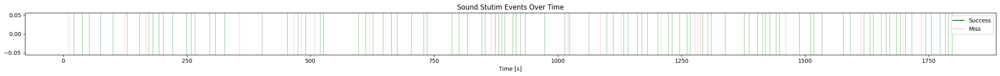

In [ ]:
import matplotlib.pyplot as plt

# --- データフレームの参照（仮） ---
# 適当にテストNWBファイルを選択
#dataroot = Path('/content/drive/MyDrive/braidyn-bc/data')
#testfile = dataroot / "VG1GC-105" / "VG1GC-105_2024-02-02_task-day8.nwb"
#session = nwbx.read_nwb(testfile)
df = session.trials.data

# --- 時間データ ---
trials_success = df[df['trial_outcome']=='success']['start_time']
trials_miss = df[df['trial_outcome']=='miss']['start_time']

# --- プロット ---
plt.figure(figsize=(25, 2))

# 音あり：縦線（青）
for t in trials_success:
    plt.axvline(t, color='green', alpha=0.5, linewidth=0.8)

# 音なし：縦線（赤）
for t in trials_miss:
    plt.axvline(t, color='pink', alpha=1, linewidth=0.8)

# 凡例用のダミー線
plt.plot([], [], color='green', label='Success')
plt.plot([], [], color='pink', label='Miss')

# 軸とラベル
plt.xlabel('Time [s]')
plt.title('Sound Stutim Events Over Time')
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()


/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.7.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


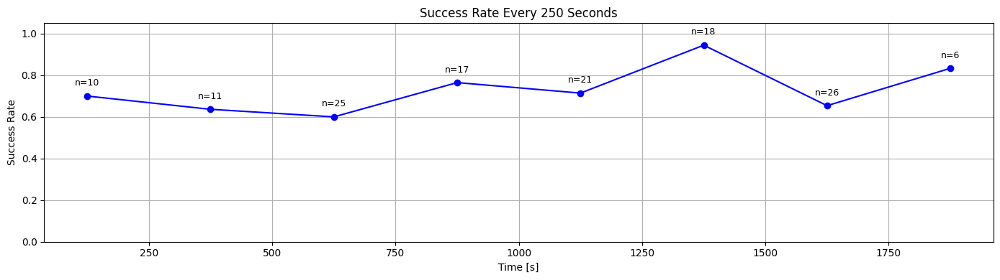

In [ ]:
import numpy as np
import matplotlib.pyplot as plt


# 適当にテストNWBファイルを選択
#dataroot = Path('/content/drive/MyDrive/braidyn-bc/data')
#testfile = dataroot / "VG1GC-105" / "VG1GC-105_2024-02-02_task-day8.nwb"
#session = nwbx.read_nwb(testfile)
session=nwbx.read_nwb('/content/drive/MyDrive/braidyn-bc/data/VG1GC-61/VG1GC-61_2023-06-26_task-day8.nwb')
df = session.trials.data
# --- データ準備 ---
bin_width = 250  # 秒
start_times = df['start_time'].values
max_time = start_times.max()

# --- 時間ビンの定義 ---
bins = np.arange(0, max_time + bin_width, bin_width)

# --- 成功率と試行数の計算 ---
success_rate = []
total_trials = []
bin_centers = []

for i in range(len(bins)-1):
    bin_start = bins[i]
    bin_end = bins[i+1]
    bin_center = (bin_start + bin_end) / 2
    bin_centers.append(bin_center)

    in_bin = df[(df['start_time'] >= bin_start) & (df['start_time'] < bin_end)]
    n_success = (in_bin['trial_outcome'] == 'success').sum()
    n_miss = (in_bin['trial_outcome'] == 'miss').sum()

    total = n_success + n_miss
    total_trials.append(total)

    rate = n_success / total if total > 0 else np.nan
    success_rate.append(rate)

# --- プロット ---
plt.figure(figsize=(14, 4))
plt.plot(bin_centers, success_rate, marker='o', color='blue')
plt.ylim(0, 1.05)
plt.xlabel('Time [s]')
plt.ylabel('Success Rate')
plt.title('Success Rate Every 250 Seconds')

# --- 試行数の数値を表示 ---
for x, y, total in zip(bin_centers, success_rate, total_trials):
    if not np.isnan(y):
        plt.text(x, y + 0.05, f'n={total}', ha='center', fontsize=9, color='black')

plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
trials_success

,start_time,stop_time,pull_onset,reaction_time,pull_duration_for_success,trial_outcome
2,21.545200,24.011801,21.711800,0.1742,0.3,success
3,38.245399,40.712002,38.411999,0.1398,0.3,success
4,52.045399,54.545399,52.245399,0.1918,0.3,success
5,74.778999,77.378998,75.079002,0.3104,0.3,success
6,100.612396,103.179199,100.879204,0.2522,0.3,success
...,...,...,...,...,...,...
158,1755.091187,1757.724609,1755.291260,0.2102,0.4,success
159,1772.824585,1775.391357,1772.991211,0.1832,0.4,success
160,1783.057983,1785.557983,1783.157959,0.1036,0.4,success
161,1789.157959,1791.824829,1789.424805,0.2582,0.4,success


In [ ]:
df

,start_time,stop_time,pull_onset,reaction_time,pull_duration_for_success,trial_outcome
0,11.878400,12.678400,12.645200,0.7738,0.3,miss
1,15.845200,16.878599,NaN,NaN,0.3,failure
2,21.545200,24.011801,21.711800,0.1742,0.3,success
3,38.245399,40.712002,38.411999,0.1398,0.3,success
4,52.045399,54.545399,52.245399,0.1918,0.3,success
...,...,...,...,...,...,...
158,1755.091187,1757.724609,1755.291260,0.2102,0.4,success
159,1772.824585,1775.391357,1772.991211,0.1832,0.4,success
160,1783.057983,1785.557983,1783.157959,0.1036,0.4,success
161,1789.157959,1791.824829,1789.424805,0.2582,0.4,success


##レバー引き時間とかの可視化

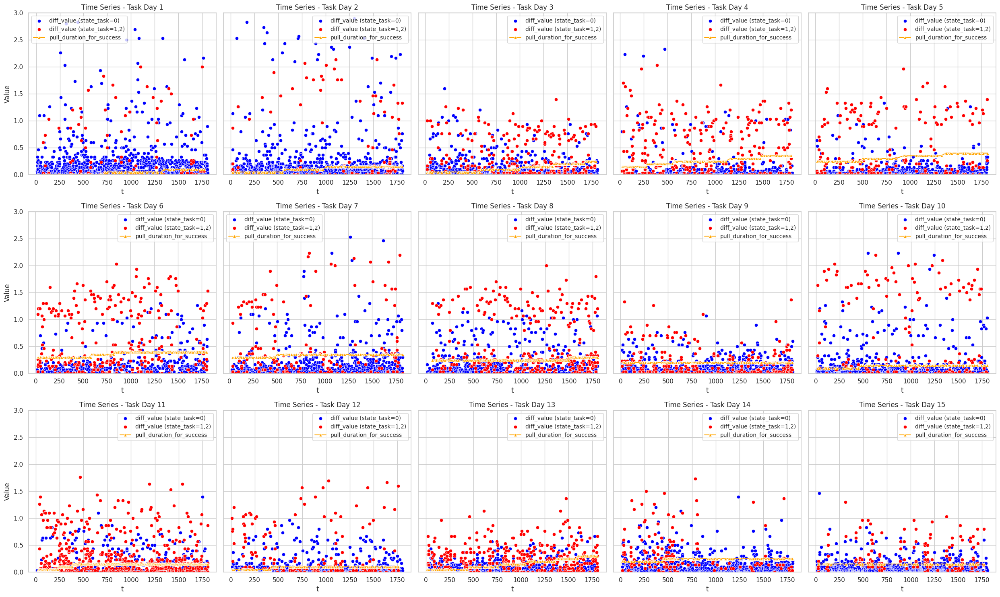

In [ ]:
#diff_valueの下限なし

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

# 閾値の設定
threshold_lower = 0.04
threshold_upper = 3.0


y_min, y_max = 0, 3

# 3行×5列のサブプロット作成（sharey=Trueで縦軸を揃える）
fig, axes = plt.subplots(3, 5, figsize=(25, 15), sharey=True)
axes = axes.flatten()

for day in range(1, 16):
    ax = axes[day-1]
    file_path = f'/content/drive/MyDrive/hackathon_data/VG1GC-61/task-day{day}/trials_L1L2.csv'

    # ファイルが存在しなければサブプロットにメッセージを表示
    if not os.path.exists(file_path):
        ax.text(0.5, 0.5, f"File not found:\nTask Day {day}", ha='center', va='center')
        ax.set_title(f"Task Day {day}")
        ax.set_xlabel("t")
        ax.set_ylabel("Value")
        continue

    df = pd.read_csv(file_path)

    if 't' in df.columns:
        # diff_value: 閾値内 (0.04 < diff_value < 3.0) のデータを抽出
        df_diff = df[ (df['diff_value'] < threshold_upper)]

        # state_task==0 のデータ
        df_state0 = df_diff[df_diff['state_task'] == 0]
        # state_task==1,2 のデータ
        df_state12 = df_diff[df_diff['state_task'].isin([1, 2])]

        # state_task==0 は青色の散布図
        sns.scatterplot(x='t', y='diff_value', data=df_state0, marker='o',
                        label='diff_value (state_task=0)', color='blue', ax=ax)
        # state_task==1,2 は赤色の散布図
        sns.scatterplot(x='t', y='diff_value', data=df_state12, marker='o',
                        label='diff_value (state_task=1,2)', color='red', ax=ax)

        # pull_duration_for_successが存在する場合は緑色の線グラフ
        if 'pull_duration_for_success' in df.columns:
            sns.lineplot(x='t', y='pull_duration_for_success', data=df, marker='^',
                         label='pull_duration_for_success',color='orange' , ax=ax)

        ax.set_xlabel("t")
        ax.set_ylabel("Value")
        ax.set_title(f"Time Series - Task Day {day}")
        ax.set_ylim(y_min, y_max)
        # サブプロット毎の凡例が重なる場合は、表示位置を調整することも可能です
        ax.legend(fontsize='small')
    else:
        ax.text(0.5, 0.5, "No 't' column", ha='center', va='center')
        ax.set_title(f"Task Day {day}")

plt.tight_layout()
plt.show()


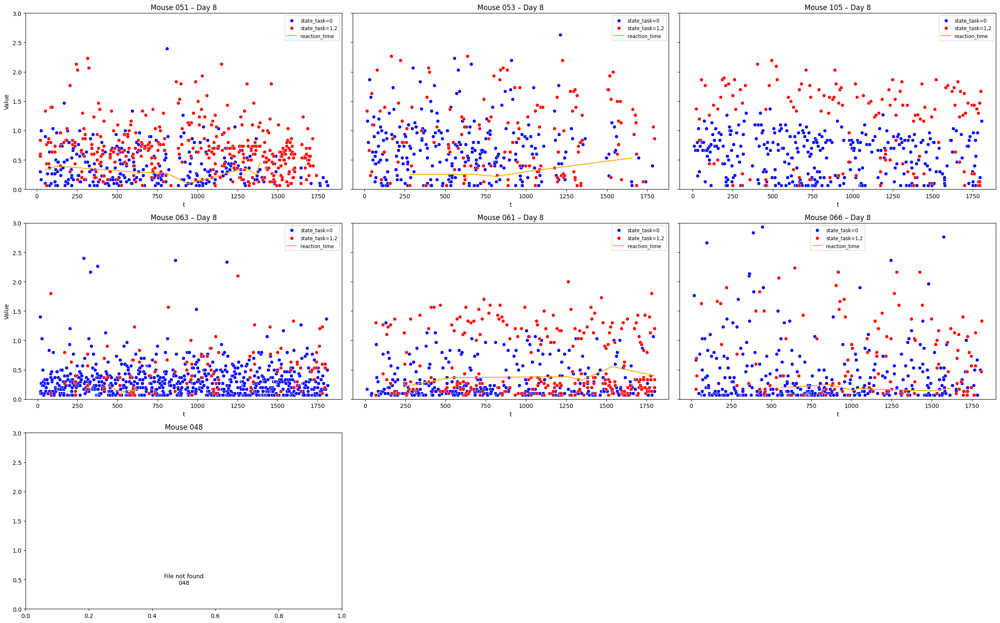

In [ ]:
#クラスタAのDAY８のレバー引き時間を可視化。pull?durationも消えてるし、reaction_timeの点もなくなっている

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os, math

# 対象個体とパスのひな形
subjects = ["051", "053", "105", "063", "061", "066", "048"]
path_tpl  = "/content/drive/MyDrive/hackathon_data/VG1GC-{}/task-day8/trials_L1L2.csv"

# プロット設定
th_low, th_high = 0.04, 3.0       # diff_value の範囲
y_min, y_max    = 0, 3            # y 軸共通スケール
n_cols          = 3               # 列数（好みで変更可）
n_rows          = math.ceil(len(subjects) / n_cols)

fig, axes = plt.subplots(n_rows, n_cols,
                         figsize=(8 * n_cols, 5 * n_rows),
                         sharey=True)
axes = axes.flatten()

for i, sid in enumerate(subjects):
    ax = axes[i]

    # 先頭ゼロあり／なしの両方を試す
    candidate_paths = [
        path_tpl.format(sid.lstrip("0")),   # 例: 051 → 51
        path_tpl.format(sid)                # 例: 051
    ]
    file_path = next((p for p in candidate_paths if os.path.exists(p)), None)

    if file_path is None:
        ax.text(0.5, 0.5, f"File not found\n{sid}", ha="center", va="center")
        ax.set_title(f"Mouse {sid}")
        continue

    df = pd.read_csv(file_path)

    # 条件フィルタ
    mask = (df["diff_value"] > th_low) & (df["diff_value"] < th_high)
    df = df[mask]

    # state_task 別に描画
    df0  = df[df["state_task"] == 0]
    df12 = df[df["state_task"].isin([1, 2])]

    sns.scatterplot(data=df0,  x="t", y="diff_value",
                    color="blue",  label="state_task=0",  ax=ax)
    sns.scatterplot(data=df12, x="t", y="diff_value",
                    color="red",   label="state_task=1,2", ax=ax)

    # reaction_time がある場合
    if "reaction_time" in df.columns:
        sns.lineplot(data=df, x="t", y="reaction_time",
                     color="orange", label="reaction_time", ax=ax)

    ax.set_title(f"Mouse {sid} – Day 8")
    ax.set_xlabel("t")
    ax.set_ylabel("Value")
    ax.set_ylim(y_min, y_max)
    ax.legend(fontsize="small")

# 余った sub-axes を消す（7匹→9枠中2枠空き）
for j in range(len(subjects), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


##数理モデル_missとfailureの違いを含めて導入

全試行数: 54000
フィルタリング後の試行数: 200


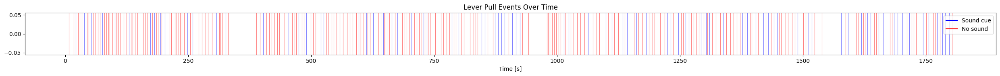

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd


# CSVファイルの読み込み
csv_path = Path('/content/drive/MyDrive/hackathon_data/VG1GC-105/task-day8/trials_L1L2.csv')
trials = pd.read_csv(csv_path)
print("全試行数:", len(trials))

# 条件に合致する行のフィルタリング
filtered_trials = trials[(trials['state_lever']==1) &
                         (trials['state_task'] == 0) &
                         (trials['diff_value'] > 0.4)].copy()
print("フィルタリング後の試行数:", len(filtered_trials))


filtered_trials['lever_time_nocue'] = filtered_trials['t'] - filtered_trials['diff_value']

# --- trials フィルタリング ---
filtered = trials.dropna(subset=['trial_outcome'])
filtered = filtered[
    (filtered['first_diff'] > 1.0) &
    (filtered['reaction_time'] > 0.091) &
    (filtered['reaction_time'] < 0.361)
].copy()


# --- 時間データ ---
sound_onsets = filtered['pull_onset']
no_sound_onsets = filtered_trials['lever_time_nocue']

# --- プロット ---
plt.figure(figsize=(25, 2))

# 音あり：縦線（青）
for t in sound_onsets:
    plt.axvline(t, color='blue', alpha=0.5, linewidth=0.8)

# 音なし：縦線（赤）
for t in no_sound_onsets:
    plt.axvline(t, color='red', alpha=0.5, linewidth=0.8)

# 凡例用のダミー線
plt.plot([], [], color='blue', label='Sound cue')
plt.plot([], [], color='red', label='No sound')

# 軸とラベル
plt.xlabel('Time [s]')
plt.title('Lever Pull Events Over Time')
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()


In [ ]:
# trial_outcome が NaN でないもののうち、条件を満たさないが failer でもない行を抽出
rest = trials.dropna(subset=['trial_outcome'])
rest = rest[
    ~((rest['first_diff'] > 1.0) &
      (rest['reaction_time'] > 0.091) &
      (rest['reaction_time'] < 0.361))
].copy()

In [ ]:
rest

,t,state_lever,state_task,start_time,stop_time,pull_onset,reaction_time,pull_duration_for_success,trial_outcome,diff_value,first_diff,lose
224,12.678400,0,0,11.878400,12.678400,12.645200,0.7738,0.3,miss,NaN,0.000000,L1
350,16.878599,0,0,15.845200,16.878599,NaN,NaN,0.3,failure,NaN,0.000000,L1
3578,124.479202,1,0,123.479202,124.479202,124.346001,0.8654,0.3,miss,NaN,0.933403,L2
4540,156.546204,0,0,154.079605,156.546204,154.246201,0.1656,0.3,success,NaN,0.500000,L2
4871,167.579605,1,0,167.379593,167.579605,167.513000,0.1364,0.3,miss,NaN,0.000000,L1
...,...,...,...,...,...,...,...,...,...,...,...,...
50046,1673.423950,0,0,1670.890625,1673.423950,1670.957153,0.0500,0.4,success,NaN,1.666626,L2
50813,1698.990845,0,0,1698.024048,1698.990845,1698.890747,0.8790,0.4,miss,NaN,0.066650,L1
51126,1709.424194,0,0,1708.424194,1709.424194,NaN,NaN,0.4,failure,NaN,0.000000,L1
51887,1734.791016,0,0,1734.490967,1734.791016,1734.757568,0.2426,0.4,miss,NaN,0.000000,L1


In [ ]:
rest

,t,state_lever,state_task,start_time,stop_time,pull_onset,reaction_time,pull_duration_for_success,trial_outcome,diff_value,first_diff,lose
224,12.678400,0,0,11.878400,12.678400,12.645200,0.7738,0.3,miss,NaN,0.000000,L1
350,16.878599,0,0,15.845200,16.878599,NaN,NaN,0.3,failure,NaN,0.000000,L1
3578,124.479202,1,0,123.479202,124.479202,124.346001,0.8654,0.3,miss,NaN,0.933403,L2
4540,156.546204,0,0,154.079605,156.546204,154.246201,0.1656,0.3,success,NaN,0.500000,L2
4871,167.579605,1,0,167.379593,167.579605,167.513000,0.1364,0.3,miss,NaN,0.000000,L1
...,...,...,...,...,...,...,...,...,...,...,...,...
50046,1673.423950,0,0,1670.890625,1673.423950,1670.957153,0.0500,0.4,success,NaN,1.666626,L2
50813,1698.990845,0,0,1698.024048,1698.990845,1698.890747,0.8790,0.4,miss,NaN,0.066650,L1
51126,1709.424194,0,0,1708.424194,1709.424194,NaN,NaN,0.4,failure,NaN,0.000000,L1
51887,1734.791016,0,0,1734.490967,1734.791016,1734.757568,0.2426,0.4,miss,NaN,0.000000,L1


<ipython-input-5-e74e424721ab>:37: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  rate = (events.groupby(["bin", "state"]).size()


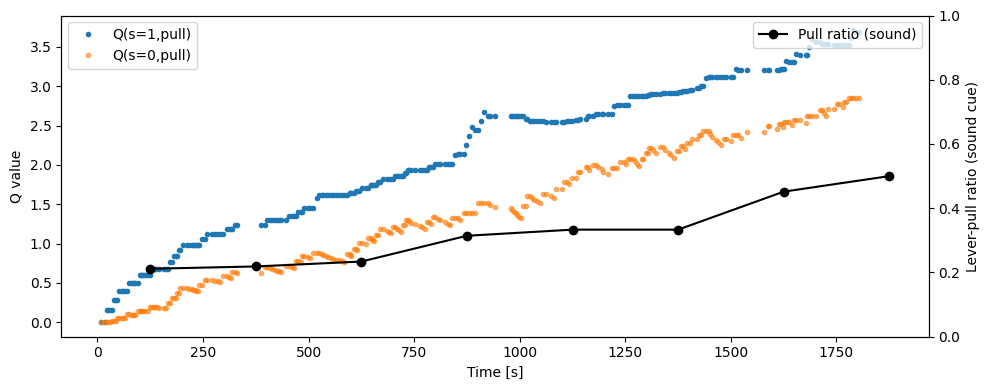

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ========= 1. イベント列 =========
ev_sound = pd.DataFrame({"t": sound_onsets,     "state": 1})
ev_nosnd = pd.DataFrame({"t": no_sound_onsets,  "state": 0})
events   = (pd.concat([ev_sound, ev_nosnd], ignore_index=True)
              .sort_values("t")
              .reset_index(drop=True))
events["r"] = events["state"]          # 水が出たら1、出なければ0

# ========= 2. SARSA =========
alpha, gamma = 0.15, 0.9               # 学習率と割引率は後でフィット
Q = np.zeros((2, 2))                   # Q[state, action]  (a=1のみ使う)

Q_log = []                             # 推移を保存して後で描画
for i in range(len(events) - 1):
    s  = events.loc[i,   "state"]
    sp = events.loc[i+1, "state"]
    r  = events.loc[i,   "r"]

    td = r + gamma * Q[sp, 1] - Q[s, 1]
    Q[s, 1] += alpha * td              # SARSA 更新
    Q_log.append(Q.copy())

# 最終行も合わせておく
Q_log.append(Q.copy())
events["Q_s1"] = [q[1,1] for q in Q_log]     # 音あり pull
events["Q_s0"] = [q[0,1] for q in Q_log]     # 音なし pull

# ========= 3. 可視化 =========
# 250 s ビンで実際のレバー率を出す
bin_edges  = np.arange(0, events["t"].max()+250, 250)
events["bin"] = pd.cut(events["t"], bins=bin_edges, labels=bin_edges[:-1]+125)

rate = (events.groupby(["bin", "state"]).size()
              .unstack(fill_value=0)        # col=state 0/1
              .assign(ratio = lambda df: df[1] / df.sum(axis=1)))

fig, ax1 = plt.subplots(figsize=(10,4))
# --- Q 曲線 ---
ax1.plot(events["t"], events["Q_s1"], '.', label="Q(s=1,pull)")
ax1.plot(events["t"], events["Q_s0"], '.', label="Q(s=0,pull)", alpha=0.6)
ax1.set_xlabel("Time [s]");  ax1.set_ylabel("Q value")
ax1.legend(loc="upper left")

# --- レバー率 ---
ax2 = ax1.twinx()
ax2.plot(rate.index.astype(float), rate["ratio"], "k-o", label="Pull ratio (sound)")
ax2.set_ylabel("Lever-pull ratio (sound cue)")
ax2.set_ylim(0,1)
ax2.legend(loc="upper right")

plt.tight_layout();  plt.show()


In [ ]:
# 最後の Q 値
final_Q = Q[1, 1]
print(f"マウスが音ありでレバーを引いたときに期待している報酬: {final_Q:.3f}")


マウスが音ありでレバーを引いたときに期待している報酬: 3.101


全試行数: 54000
フィルタリング後の試行数: 200


<ipython-input-6-b78b234cdabe>:85: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  rate = (events.groupby(["bin", "state"])["action"]


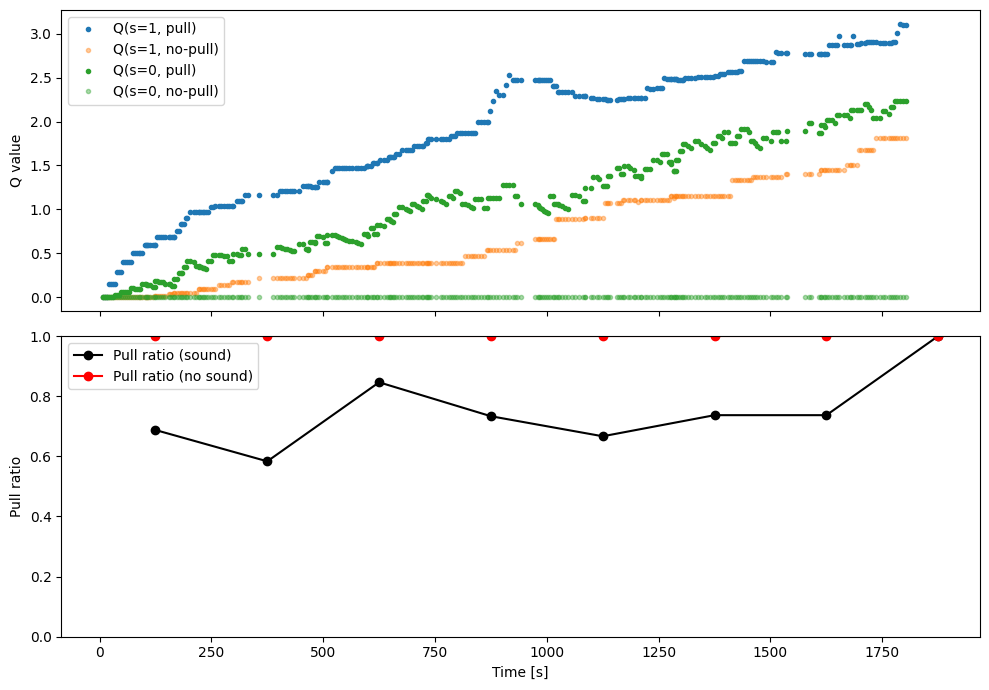

In [ ]:
#SARSAで音あり引かない試行も追加

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# CSVファイルの読み込み
csv_path = Path('/content/drive/MyDrive/hackathon_data/VG1GC-105/task-day8/trials_L1L2.csv')
trials = pd.read_csv(csv_path)
print("全試行数:", len(trials))

# 条件に合致する行のフィルタリング
filtered_trials = trials[(trials['state_lever']==1) &
                         (trials['state_task'] == 0) &
                         (trials['diff_value'] > 0.4)].copy()
print("フィルタリング後の試行数:", len(filtered_trials))
filtered_trials['lever_time_nocue'] = filtered_trials['t'] - filtered_trials['diff_value']

# --- trials フィルタリング ---
filtered = trials.dropna(subset=['trial_outcome'])
filtered = filtered[
    (filtered['first_diff'] > 1.0) &
    (filtered['reaction_time'] > 0.091) &
    (filtered['reaction_time'] < 0.361)
].copy()

# trial_outcome が NaN でないもののうち、条件を満たさないが failer でもない行を抽出
rest = trials.dropna(subset=['trial_outcome'])
rest = rest[
    ~((rest['first_diff'] > 1.0) &
      (rest['reaction_time'] > 0.091) &
      (rest['reaction_time'] < 0.361)) &
    (rest['trial_outcome'] != 'failure')
].copy()


# --- 時間データ ---
sound_onsets = filtered['pull_onset']
no_sound_onsets = filtered_trials['lever_time_nocue']


# ---------- 1. イベント列作成 ----------
def mk_df(times, state, action, reward):
    return pd.DataFrame({"t": times, "state": state,
                         "action": action, "reward": reward})

ev_sound_pull    = mk_df(sound_onsets,        1, 1, 1)  # r=1 only here
ev_sound_nopull  = mk_df(rest['pull_onset'],  1, 0, 0)
ev_nosound_pull  = mk_df(no_sound_onsets,     0, 1, 0)

events = (pd.concat([ev_sound_pull, ev_sound_nopull, ev_nosound_pull],
                    ignore_index=True)
            .sort_values("t")
            .reset_index(drop=True))

# ---------- 2. SARSA ----------
alpha, gamma = 0.15, 0.9
Q = np.zeros((2, 2))                 # Q[state, action]  (a=0/1)
log = []

for i in range(len(events) - 1):


    s  = int(events.at[i, "state"])
    a  = int(events.at[i, "action"])
    r  = float(events.at[i, "reward"])  # Qの更新に float が安全

    sp = int(events.at[i+1, "state"])
    ap = int(events.at[i+1, "action"])

    td = r + gamma * Q[sp, ap] - Q[s, a]
    Q[s, a] += alpha * td
    log.append(Q.copy())

# 最終行も合わせる
log.append(Q.copy())
events["Q_s1_pull"] = [q[1,1] for q in log]
events["Q_s1_nop"]  = [q[1,0] for q in log]
events["Q_s0_pull"] = [q[0,1] for q in log]
events["Q_s0_nop"]  = [q[0,0] for q in log]

# ---------- 3. ビンごとの行動確率 ----------
bin_edges = np.arange(0, events["t"].max()+250, 250)
events["bin"] = pd.cut(events["t"], bins=bin_edges,
                       labels=bin_edges[:-1]+125)

rate = (events.groupby(["bin", "state"])["action"]
              .mean()                              # pull 率
              .unstack())                          # col = state 0/1

# ---------- 4. 可視化 ----------
fig, axes = plt.subplots(2, 1, figsize=(10,7), sharex=True)

# --- Q 曲線 ---
axes[0].plot(events["t"], events["Q_s1_pull"], '.', label="Q(s=1, pull)")
axes[0].plot(events["t"], events["Q_s1_nop"],  '.', label="Q(s=1, no-pull)", alpha=0.4)
axes[0].plot(events["t"], events["Q_s0_pull"], '.', label="Q(s=0, pull)",  c='C2')
axes[0].plot(events["t"], events["Q_s0_nop"],  '.', label="Q(s=0, no-pull)", c='C2', alpha=0.4)
axes[0].set_ylabel("Q value");  axes[0].legend()

# --- 行動確率 ---
axes[1].plot(rate.index.astype(float), rate[1], 'k-o', label="Pull ratio (sound)")
axes[1].plot(rate.index.astype(float), rate[0], 'r-o', label="Pull ratio (no sound)")
axes[1].set_ylabel("Pull ratio"); axes[1].set_ylim(0,1)
axes[1].set_xlabel("Time [s]"); axes[1].legend()

plt.tight_layout(); plt.show()


FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/hackathon_data/VG1GC-48/task-day8/trials_L1L2.csv'

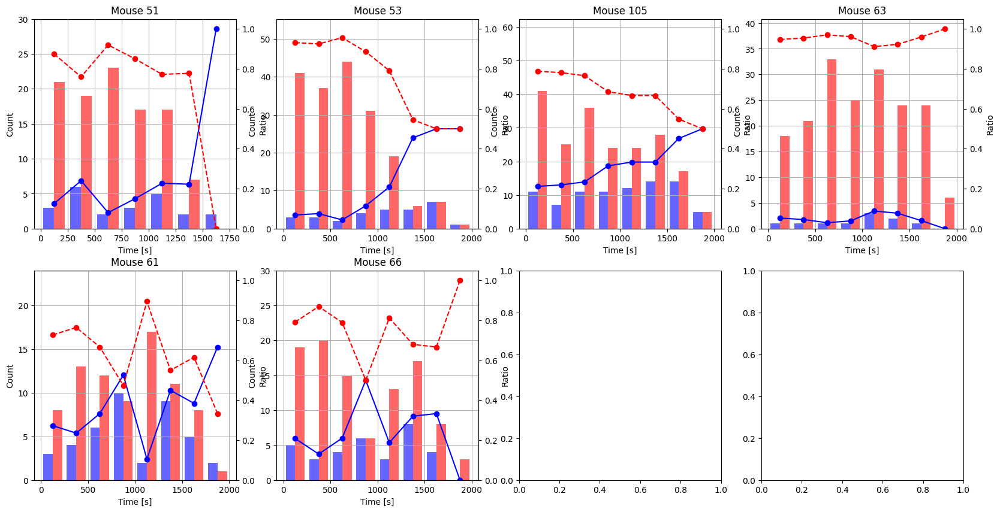

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

# === パラメータ設定 ===
mouse_ids = ["51", "53", "105", "63", "61", "66", "48"]
csv_root = Path('/content/drive/MyDrive/hackathon_data')
bin_width = 250  # 秒
width_ratio = 0.4

# === 図の設定 ===
fig, axes = plt.subplots(2, 4, figsize=(20, 10))
axes = axes.flatten()

for i, mouse_id in enumerate(mouse_ids):
    # === データ読み込み ===
    csv_path = csv_root / f"VG1GC-{mouse_id}/task-day8/trials_L1L2.csv"
    trials = pd.read_csv(csv_path)

    # === 音なしレバー引き（diff_value > 0.4）===
    filtered_trials = trials[(trials['state_lever'] == 1) &
                             (trials['state_task'] == 0) &
                             (trials['diff_value'] > 0.4)].copy()
    filtered_trials['lever_time_nocue'] = filtered_trials['t'] - filtered_trials['diff_value']

    # === 音ありレバー引き（反応時間フィルタ）===
    filtered = trials.dropna(subset=['trial_outcome']).copy()
    filtered = filtered[
        (filtered['first_diff'] > 1.0) &
        (filtered['reaction_time'] > 0.091) &
        (filtered['reaction_time'] < 0.361)
    ].copy()

    sound_onsets = filtered['pull_onset']
    no_sound_onsets = filtered_trials['lever_time_nocue']

    # === ヒストグラム用のビン ===
    max_time = max(sound_onsets.max(), no_sound_onsets.max())
    bins = np.arange(0, max_time + bin_width, bin_width)
    bin_centers = (bins[:-1] + bins[1:]) / 2
    width = bin_width * width_ratio

    # === カウントと比率計算 ===
    hist_sound, _ = np.histogram(sound_onsets, bins=bins)
    hist_nosound, _ = np.histogram(no_sound_onsets, bins=bins)
    total = hist_sound + hist_nosound
    ratio_sound = np.divide(hist_sound, total, out=np.zeros_like(hist_sound, dtype=float), where=total != 0)
    ratio_nosound = np.divide(hist_nosound, total, out=np.zeros_like(hist_nosound, dtype=float), where=total != 0)

    # === プロット ===
    ax1 = axes[i]
    ax2 = ax1.twinx()

    ax1.bar(bin_centers - width/2, hist_sound, width=width, color='blue', alpha=0.6)
    ax1.bar(bin_centers + width/2, hist_nosound, width=width, color='red', alpha=0.6)
    ax2.plot(bin_centers, ratio_sound, marker='o', color='blue', linestyle='-')
    ax2.plot(bin_centers, ratio_nosound, marker='o', color='red', linestyle='--')

    ax1.set_title(f"Mouse {mouse_id}")
    ax1.set_ylim(0, max(total) * 1.2)
    ax2.set_ylim(0, 1.05)
    ax1.set_xlabel('Time [s]')
    ax1.set_ylabel('Count')
    ax2.set_ylabel('Ratio')
    ax1.grid(True)

# 不要なプロット枠を非表示
for j in range(len(mouse_ids), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.suptitle('Lever Pulls: Count and Ratio per 250s (Sound vs No-sound)', fontsize=16, y=1.02)
plt.show()


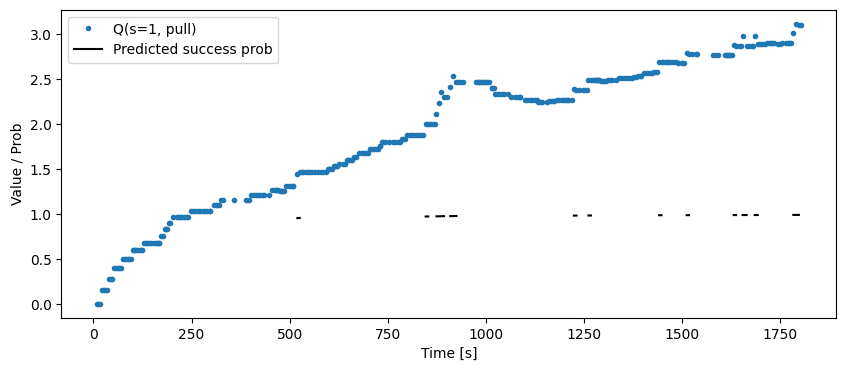

In [ ]:
#レバーで報酬が出る確率の予測を表している（0-1

success_count = 0
trial_count = 0
estimated_success_prob = []

for _, row in events.iterrows():
    if row["state"] == 1 and row["action"] == 1:  # 音あり + 引いた
        trial_count += 1
        if row["reward"] == 1:
            success_count += 1
        p_hat = success_count / trial_count
        estimated_success_prob.append(p_hat)
    else:
        estimated_success_prob.append(np.nan)  # 音なしなどは除外
alpha_p, beta_p = 1, 1  # 非情報的事前分布：Beta(1,1) = 一様分布
estimated_p = []

for _, row in events.iterrows():
    if row["state"] == 1 and row["action"] == 1:
        if row["reward"] == 1:
            alpha_p += 1
        else:
            beta_p += 1
        estimated_p.append(alpha_p / (alpha_p + beta_p))
    else:
        estimated_p.append(np.nan)
events["p_success"] = estimated_p

plt.figure(figsize=(10,4))
plt.plot(events["t"], events["Q_s1_pull"], '.', label="Q(s=1, pull)")
plt.plot(events["t"], events["p_success"], 'k-', label="Predicted success prob")
plt.ylabel("Value / Prob")
plt.xlabel("Time [s]")
plt.legend()
plt.show()


Text(0, 0.5, 'Probability')

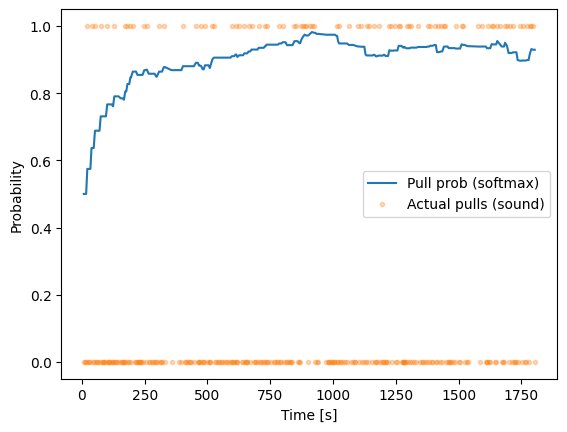

In [ ]:
beta = 2.0  # 仮の値、後でfit可能
softmax_p = 1 / (1 + np.exp(beta * (events["Q_s1_nop"] - events["Q_s1_pull"])))
events["policy_pull_prob"] = softmax_p
plt.plot(events["t"], events["policy_pull_prob"], label="Pull prob (softmax)")
plt.plot(events["t"], events["action"] * (events["state"]==1), '.', alpha=0.3, label="Actual pulls (sound)")
plt.legend(); plt.xlabel("Time [s]"); plt.ylabel("Probability")


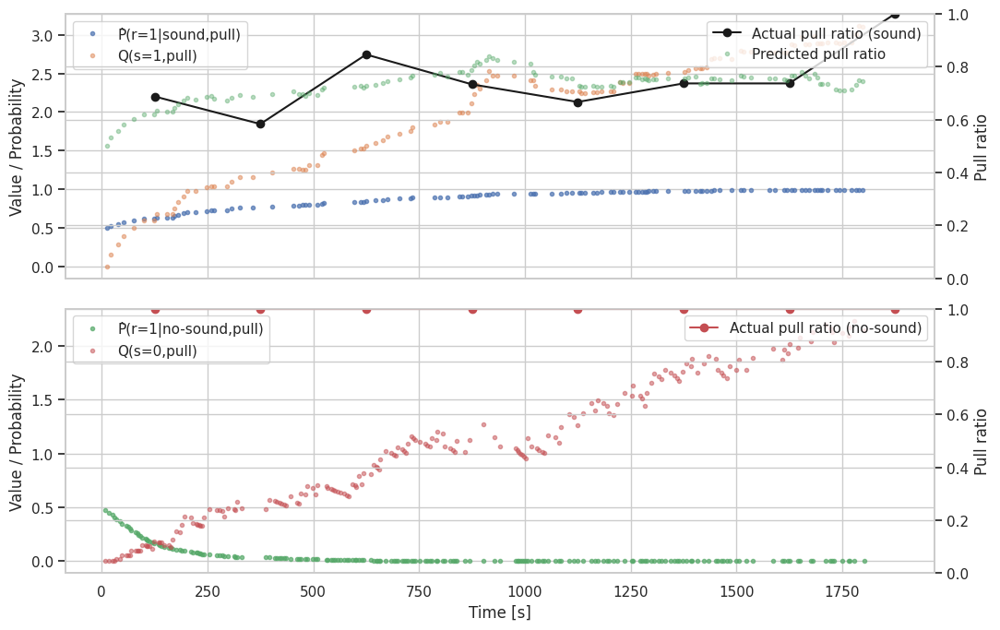

In [ ]:
# SARSA。音ありレバー無も加えた。可視化の方法が異なってる
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ========= 0. 事前に用意された時系列 =========
# sound_onsets, no_sound_onsets, rest['pull_onset'] が既にあるとする

# ---------- 1. イベント列を作る ----------
def mk_df(times, state, action, reward):
    return pd.DataFrame({"t": times,
                         "state": state,    # 1 = sound, 0 = no-sound
                         "action": action,  # 1 = pull, 0 = no-pull
                         "reward": reward}) # 1 = water, 0 = none

ev_sound_pull   = mk_df(sound_onsets,       1, 1, 1)
ev_sound_nopull = mk_df(rest['pull_onset'], 1, 0, 0)
ev_nosnd_pull   = mk_df(no_sound_onsets,    0, 1, 0)

events = (pd.concat([ev_sound_pull, ev_sound_nopull, ev_nosnd_pull],
                    ignore_index=True)
            .sort_values("t")
            .reset_index(drop=True))

# ---------- 2. 学習パラメータ ----------
alpha_Q  = 0.15      # Q の学習率
alpha_R  = 0.05      # 即時報酬確率（成功率）の学習率
gamma    = 0.9       # 割引率
tau      = 1.2   # ソフトマックス温度（小さいほど鋭い）

# ---------- 3. テーブル初期化 ----------
Q  = np.zeros((2,2))     # Q[state, action]
R  = np.full((2,2), 0.5) # P̂(r=1|s,a) を 0.5 からスタート
log = []                 # 途中で保存

for i in range(len(events)-1):
    # 現在
    s  = int(events.at[i,   "state"])
    a  = int(events.at[i,   "action"])
    r  = int(events.at[i,   "reward"])
    # 次状態・行動（on-policy）
    sp = int(events.at[i+1, "state"])
    ap = int(events.at[i+1, "action"])

    # ----- 即時報酬確率の更新（逐次平均） -----
    R[s,a] += alpha_R * (r - R[s,a])

    # ----- SARSA で Q 更新 -----
    td = r + gamma * Q[sp, ap] - Q[s, a]
    Q[s, a] += alpha_Q * td

    # ----- ポリシーから引く確率を計算 -----
    softmax = np.exp(Q[s] / tau)
    p_pull  = softmax[1] / softmax.sum()

    log.append({"t": events.at[i,"t"],
                "state": s,
                "p_pull_pred": p_pull,
                "R_pred": R[s,1].copy(),
                "Q_pull": Q[s,1].copy(),
                "Q_nop" : Q[s,0].copy()})

df_log = pd.DataFrame(log)

# ---------- 4. 実データ側の pull 割合（250 s ビン） ----------
bin_edges = np.arange(0, events["t"].max() + 250, 250)
events["bin"] = pd.cut(events["t"], bins=bin_edges,
                       labels=bin_edges[:-1] + 125)

pull_rate = (events.groupby(["bin", "state"])["action"]
                   .mean()               # pull=1 の平均 = 割合
                   .unstack())           # col = state 0/1

# ---------- 5. 可視化 ----------
fig, axes = plt.subplots(2, 1, figsize=(11,7), sharex=True)

# (a) 音あり (state=1) での結果
mask1 = df_log["state"]==1
axes[0].plot(df_log.loc[mask1,"t"], df_log.loc[mask1,"R_pred"],
             '.', label="P̂(r=1|sound,pull)", alpha=0.7)
axes[0].plot(df_log.loc[mask1,"t"], df_log.loc[mask1,"Q_pull"],
             '.', label="Q(s=1,pull)", alpha=0.5)
axes[0].set_ylabel("Value / Probability")
axes[0].legend(loc="upper left")

ax2 = axes[0].twinx()
ax2.plot(pull_rate.index.astype(float), pull_rate[1],
         'k-o', label="Actual pull ratio (sound)")
ax2.plot(df_log.loc[mask1,"t"], df_log.loc[mask1,"p_pull_pred"],
         'g.', label="Predicted pull ratio", alpha=0.4)
ax2.set_ylim(0,1); ax2.set_ylabel("Pull ratio")
ax2.legend(loc="upper right")

# (b) 音なし (state=0)
mask0 = df_log["state"]==0
axes[1].plot(df_log.loc[mask0,"t"], df_log.loc[mask0,"R_pred"],
             '.', label="P̂(r=1|no-sound,pull)", alpha=0.7, c='C2')
axes[1].plot(df_log.loc[mask0,"t"], df_log.loc[mask0,"Q_pull"],
             '.', label="Q(s=0,pull)", alpha=0.5, c='C3')
axes[1].set_ylabel("Value / Probability")
axes[1].legend(loc="upper left")

ax3 = axes[1].twinx()
ax3.plot(pull_rate.index.astype(float), pull_rate[0],
         'r-o', label="Actual pull ratio (no-sound)")
ax3.set_ylim(0,1); ax3.set_ylabel("Pull ratio")
ax3.legend(loc="upper right")

axes[1].set_xlabel("Time [s]")
plt.tight_layout(); plt.show()


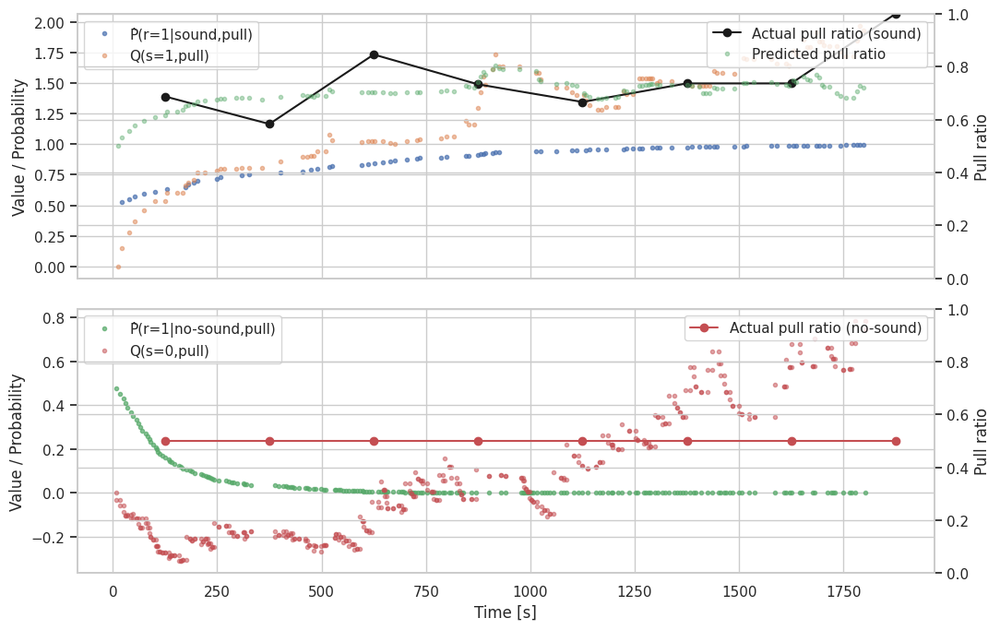

In [ ]:
# 労力を追加。

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ========= 0. 事前に用意された時系列 =========
# sound_onsets, no_sound_onsets, rest['pull_onset'] が既にあるとする

# ---------- 1. イベント列を作る ----------
def mk_df(times, state, action, reward):
    return pd.DataFrame({"t": times,
                         "state": state,    # 1 = sound, 0 = no-sound
                         "action": action,  # 1 = pull, 0 = no-pull
                         "reward": reward}) # 1 = water, 0 = none

ev_sound_pull   = mk_df(sound_onsets,       1, 1, 1)
ev_sound_nopull = mk_df(rest['pull_onset'], 1, 0, 0)
ev_nosnd_pull   = mk_df(no_sound_onsets,    0, 1, 0)

events = (pd.concat([ev_sound_pull, ev_sound_nopull, ev_nosnd_pull],
                    ignore_index=True)
            .sort_values("t")
            .reset_index(drop=True))

# ----------------- パラメータ -----------------
alpha_Q, alpha_R = 0.15, 0.05
gamma            = 0.9
tau              = 1.2
cost             = 0.2      # 無報酬 pull のマイナス報酬

# --------- 報酬列を作り替える ---------
def mk_df(times, state, action, reward):
    return pd.DataFrame({"t": times,
                         "state": state,
                         "action": action,
                         "reward": reward})

ev_sound_pull   = mk_df(sound_onsets,       1, 1, 1)          # 成功
ev_sound_nopull = mk_df(rest['pull_onset'], 1, 0, 0)          # 何もしない
ev_nosnd_pull   = mk_df(no_sound_onsets,    0, 1, -cost)      # 労力コスト
ev_nosnd_nopull = mk_df(no_sound_onsets,    0, 0, 0)   # ☆pull しなかった行を追加

events = (pd.concat([ev_sound_pull, ev_sound_nopull,
                     ev_nosnd_pull, ev_nosnd_nopull],
                    ignore_index=True)
            .sort_values("t")
            .reset_index(drop=True))

# --------- 学習ループ ---------
Q  = np.zeros((2,2))
R  = np.full((2,2), 0.5)
log = []

for i in range(len(events)-1):
    s  = int(events.at[i,   "state"])
    a  = int(events.at[i,   "action"])
    r  = events.at[i,       "reward"]
    sp = int(events.at[i+1, "state"])
    ap = int(events.at[i+1, "action"])

    # 即時確率更新
    if a==1:                     # pull のときだけ水が出る確率を更新
        R[s,a] += alpha_R * ((r==1) - R[s,a])

    # Q 更新
    td = r + gamma * Q[sp, ap] - Q[s, a]
    Q[s, a] += alpha_Q * td

    # soft-max 方策
    p_pull = np.exp(Q[s,1]/tau) / np.exp(Q[s]/tau).sum()

    log.append({
        "t": events.at[i, "t"],
        "state": s,
        "Q_pull": Q[s,1],
        "Q_nop": Q[s,0],
        "p_pull_pred": p_pull,
        "R_pred": R[s,1] if a == 1 else np.nan  # pull の時だけ記録、その他はNaN
    })


df_log = pd.DataFrame(log)

# ---------- 4. 実データ側の pull 割合（250 s ビン） ----------
bin_edges = np.arange(0, events["t"].max() + 250, 250)
events["bin"] = pd.cut(events["t"], bins=bin_edges,
                       labels=bin_edges[:-1] + 125)

pull_rate = (events.groupby(["bin", "state"])["action"]
                   .mean()               # pull=1 の平均 = 割合
                   .unstack())           # col = state 0/1

# ---------- 5. 可視化 ----------
fig, axes = plt.subplots(2, 1, figsize=(11,7), sharex=True)

# (a) 音あり (state=1) での結果
mask1 = df_log["state"]==1
axes[0].plot(df_log.loc[mask1,"t"], df_log.loc[mask1,"R_pred"],
             '.', label="P̂(r=1|sound,pull)", alpha=0.7)
axes[0].plot(df_log.loc[mask1,"t"], df_log.loc[mask1,"Q_pull"],
             '.', label="Q(s=1,pull)", alpha=0.5)
axes[0].set_ylabel("Value / Probability")
axes[0].legend(loc="upper left")

ax2 = axes[0].twinx()
ax2.plot(pull_rate.index.astype(float), pull_rate[1],
         'k-o', label="Actual pull ratio (sound)")
ax2.plot(df_log.loc[mask1,"t"], df_log.loc[mask1,"p_pull_pred"],
         'g.', label="Predicted pull ratio", alpha=0.4)
ax2.set_ylim(0,1); ax2.set_ylabel("Pull ratio")
ax2.legend(loc="upper right")

# (b) 音なし (state=0)
mask0 = df_log["state"]==0
axes[1].plot(df_log.loc[mask0,"t"], df_log.loc[mask0,"R_pred"],
             '.', label="P̂(r=1|no-sound,pull)", alpha=0.7, c='C2')
axes[1].plot(df_log.loc[mask0,"t"], df_log.loc[mask0,"Q_pull"],
             '.', label="Q(s=0,pull)", alpha=0.5, c='C3')
axes[1].set_ylabel("Value / Probability")
axes[1].legend(loc="upper left")

ax3 = axes[1].twinx()
ax3.plot(pull_rate.index.astype(float), pull_rate[0],
         'r-o', label="Actual pull ratio (no-sound)")
ax3.set_ylim(0,1); ax3.set_ylabel("Pull ratio")
ax3.legend(loc="upper right")

axes[1].set_xlabel("Time [s]")
plt.tight_layout(); plt.show()


In [ ]:
events

,t,state,action,reward,bin
0,7.845200,0,0,0.0,125.0
1,7.845200,0,1,-0.2,125.0
2,12.645200,1,0,0.0,125.0
3,17.111799,0,0,0.0,125.0
4,17.111799,0,1,-0.2,125.0
...,...,...,...,...,...
512,1783.157959,1,1,1.0,1875.0
513,1789.424805,1,1,1.0,1875.0
514,1797.258179,1,1,1.0,1875.0
515,1802.824829,0,0,0.0,1875.0


In [ ]:
events

,t,state,action,reward,bin
0,7.845200,0,0,0.0,125.0
1,7.845200,0,1,-0.2,125.0
2,12.645200,1,0,0.0,125.0
3,17.111799,0,0,0.0,125.0
4,17.111799,0,1,-0.2,125.0
...,...,...,...,...,...
558,NaN,1,0,0.0,NaN
559,NaN,1,0,0.0,NaN
560,NaN,1,0,0.0,NaN
561,NaN,1,0,0.0,NaN


<ipython-input-34-05ac79ee9c15>:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  pull_counts = df_nosound.groupby("bin")["action"].sum()
<ipython-input-34-05ac79ee9c15>:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  total_counts = df_nosound.groupby("bin")["action"].count()


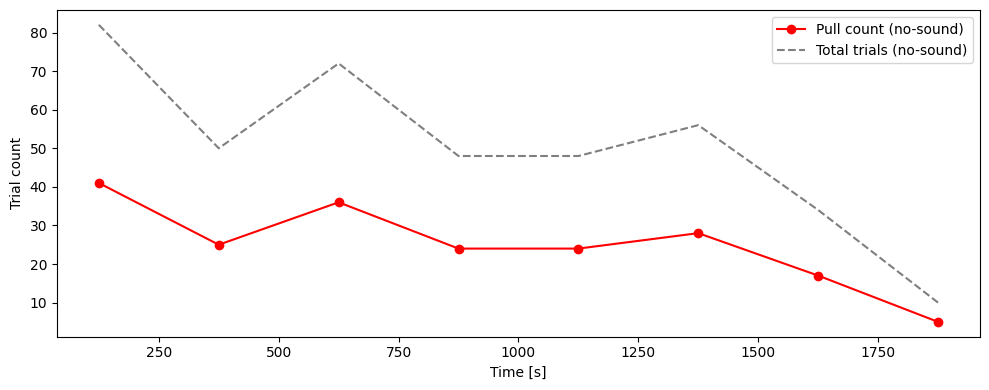

In [ ]:
# --- bin列がevents["bin"]に既にあることを前提（250s単位の時間帯） ---
# 音なし状態だけを抽出
mask_nosound = (events["state"] == 0)
df_nosound = events[mask_nosound].copy()

# 各binごとに pull の回数を集計
pull_counts = df_nosound.groupby("bin")["action"].sum()
total_counts = df_nosound.groupby("bin")["action"].count()

# 軸ラベルをfloatに変換
x = pull_counts.index.astype(float)

# --- プロット ---
import matplotlib.pyplot as plt
plt.figure(figsize=(10,4))
plt.plot(x, pull_counts.values, 'r-o', label="Pull count (no-sound)")
plt.plot(x, total_counts.values, 'k--', label="Total trials (no-sound)", alpha=0.5)
plt.xlabel("Time [s]"); plt.ylabel("Trial count")
plt.legend(); plt.tight_layout(); plt.show()


In [ ]:
alpha, gamma = 0.15, 0.0     # γ=0: 音なし pull 後に伝搬させない
cost = 0.1                   # pull コスト
epsilon = 0.15               # 常時 15 % 探索
T_bin  = 250                 # ビン幅 [s]

# --- イベント列 (state, reward) は前と同じ ---
Q = np.zeros((2,2))
log = []

for i in range(len(events)-1):
    s  = int(events.at[i,"state"])
    r  = events.at[i,"reward"]         # 音あり+pull=1, 音なし+pull=-cost, else 0

    # ---------- 行動選択 ε-greedy ----------
    if np.random.rand() < epsilon:
        a = np.random.randint(2)       # 探索
    else:
        a = np.argmax(Q[s])            # 活用

    # ------ 次の状態・行動（on-policy） -------
    sp  = int(events.at[i+1,"state"])
    ap  = np.argmax(Q[sp]) if np.random.rand()>epsilon else np.random.randint(2)

    # -------------- SARSA 更新 ---------------
    td = r + gamma*Q[sp, ap] - Q[s, a]
    Q[s, a] += alpha * td

    # --------- ログ保存 (解析用) -------------
    log.append([events.at[i,"t"], s, a, Q[s,1], Q[s,0]])

df_log = pd.DataFrame(log, columns=["t","state","action","Q_pull","Q_nop"])

# ---------- ビンごとの pull 割合 ----------
events["bin"] = (events["t"]//T_bin)*T_bin + T_bin/2
pull_rate_no = (events[events.state==0]
                .groupby("bin")["action"].mean())  # ≤ 0.2 程度を再現



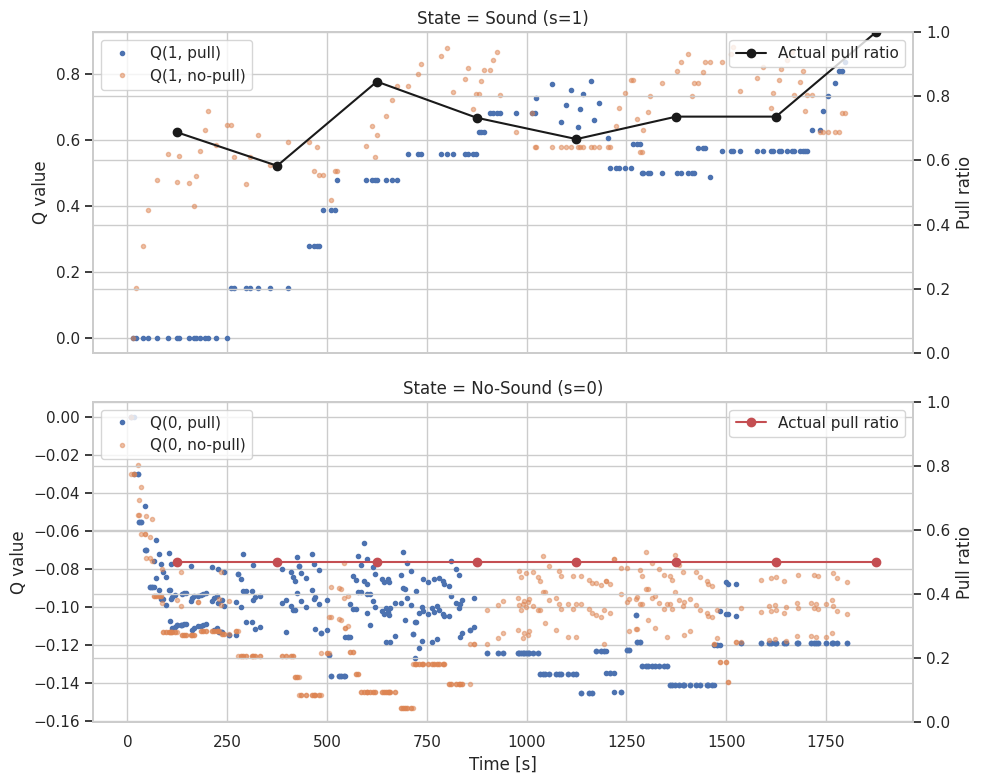

In [ ]:
# --- 修正版の可視化コード ---
import matplotlib.pyplot as plt

# pull_rate, df_log, events は事前に定義済みとします。

# 1. ビンごとの実測 pull 率を計算
pull_rate = events.groupby(['bin', 'state'])['action'] \
                  .mean() \
                  .unstack(fill_value=0)

# 2. プロット用データ
times_sound      = df_log[df_log['state'] == 1]['t']
Q_pull_sound    = df_log[df_log['state'] == 1]['Q_pull']
Q_nop_sound     = df_log[df_log['state'] == 1]['Q_nop']

times_nosound    = df_log[df_log['state'] == 0]['t']
Q_pull_nosound  = df_log[df_log['state'] == 0]['Q_pull']
Q_nop_nosound   = df_log[df_log['state'] == 0]['Q_nop']

# 3. プロット
fig, axes = plt.subplots(2, 1, figsize=(10, 8), sharex=True)

# 上：音あり
ax1 = axes[0]
ax1.plot(times_sound, Q_pull_sound, '.', label='Q(1, pull)')
ax1.plot(times_sound, Q_nop_sound,  '.', label='Q(1, no-pull)', alpha=0.5)
ax1.set_ylabel('Q value')
ax1.set_title('State = Sound (s=1)')
ax1.legend(loc='upper left')
ax1_twin = ax1.twinx()
ax1_twin.plot(pull_rate.index, pull_rate[1], 'k-o', label='Actual pull ratio')
ax1_twin.set_ylabel('Pull ratio')
ax1_twin.set_ylim(0, 1)
ax1_twin.legend(loc='upper right')

# 下：音なし
ax2 = axes[1]
ax2.plot(times_nosound, Q_pull_nosound, '.', label='Q(0, pull)')
ax2.plot(times_nosound, Q_nop_nosound, '.', label='Q(0, no-pull)', alpha=0.5)
ax2.set_ylabel('Q value')
ax2.set_title('State = No-Sound (s=0)')
ax2.legend(loc='upper left')
ax2_twin = ax2.twinx()
ax2_twin.plot(pull_rate.index, pull_rate[0], 'r-o', label='Actual pull ratio')
ax2_twin.set_ylabel('Pull ratio')
ax2_twin.set_ylim(0, 1)
ax2_twin.legend(loc='upper right')

ax2.set_xlabel('Time [s]')
plt.tight_layout()
plt.show()


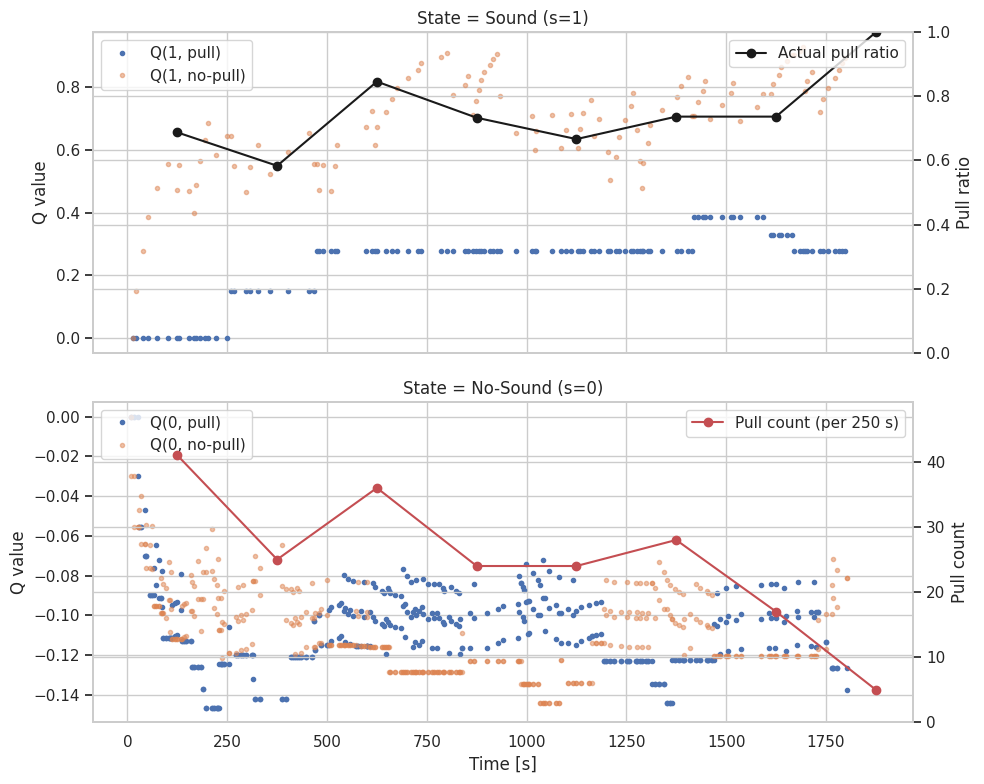

In [ ]:
import matplotlib.pyplot as plt

# 1) ビンごとの pull 率（音あり）と pull 回数（音なし）を作る
T_BIN = 250            # ビン幅 [s]（既に events['bin'] に中央値を入れている前提）

# --- 音あり (state==1) では pull 率 ---
pull_ratio_sound = (events[events.state == 1]
                    .groupby('bin')['action']
                    .mean())                # mean ⇒ ratio 0–1

# --- 音なし (state==0) では pull 回数 ---
pull_count_nosound = (events[(events.state == 0) & (events.action == 1)]
                      .groupby('bin')
                      .size())              # size ⇒ カウント 0,1,2...

# 2) Q 値系列を抽出
t_sound    = df_log[df_log.state == 1]['t']
Qpull_s    = df_log[df_log.state == 1]['Q_pull']
Qnop_s     = df_log[df_log.state == 1]['Q_nop']

t_nosound  = df_log[df_log.state == 0]['t']
Qpull_ns   = df_log[df_log.state == 0]['Q_pull']
Qnop_ns    = df_log[df_log.state == 0]['Q_nop']

# 3) プロット
fig, axes = plt.subplots(2, 1, figsize=(10, 8), sharex=True)

# ── 上段：音あり ──
ax1 = axes[0]
ax1.plot(t_sound, Qpull_s, '.', label='Q(1, pull)')
ax1.plot(t_sound, Qnop_s,  '.', label='Q(1, no-pull)', alpha=0.5)
ax1.set_ylabel('Q value'); ax1.set_title('State = Sound (s=1)')
ax1.legend(loc='upper left')

ax1r = ax1.twinx()
ax1r.plot(pull_ratio_sound.index, pull_ratio_sound.values,
          'k-o', label='Actual pull ratio')
ax1r.set_ylabel('Pull ratio'); ax1r.set_ylim(0, 1)
ax1r.legend(loc='upper right')

# ── 下段：音なし ──
ax2 = axes[1]
ax2.plot(t_nosound, Qpull_ns, '.', label='Q(0, pull)')
ax2.plot(t_nosound, Qnop_ns, '.', label='Q(0, no-pull)', alpha=0.5)
ax2.set_ylabel('Q value'); ax2.set_title('State = No-Sound (s=0)')
ax2.legend(loc='upper left')

ax2r = ax2.twinx()
ax2r.plot(pull_count_nosound.index, pull_count_nosound.values,
          'r-o', label='Pull count (per {} s)'.format(T_BIN))
ax2r.set_ylabel('Pull count')
ax2r.set_ylim(0, pull_count_nosound.max() * 1.2)
ax2r.legend(loc='upper right')

ax2.set_xlabel('Time [s]')
plt.tight_layout()
plt.show()


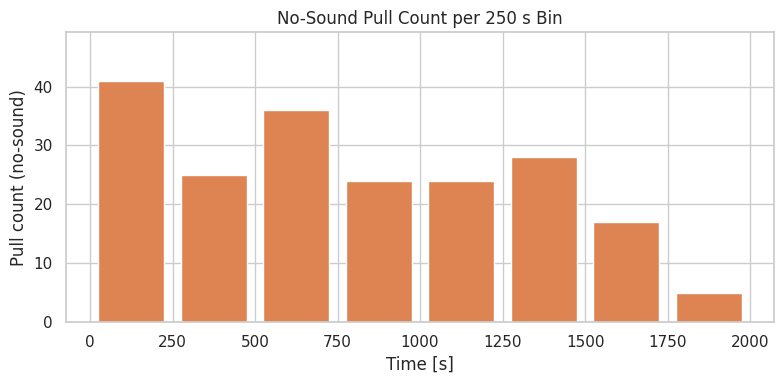

In [ ]:
import matplotlib.pyplot as plt

# 前提：events に計算済みで以下の列がある
#   t, state (0=no-sound/1=sound), action (1=pull/0=no-pull)

# 1. ビン定義（250 s ごと）
bin_width = 250
events['bin'] = (events['t'] // bin_width) * bin_width + bin_width/2

# 2. 音なし state=0 の pull count を集計
pull_counts = (events[events.state == 0]
               .groupby('bin')['action']
               .sum())   # mean() → sum() に変えれば回数

# 3. 可視化
plt.figure(figsize=(8,4))
plt.bar(pull_counts.index, pull_counts.values, width=bin_width*0.8, color='C1')
plt.xlabel('Time [s]')
plt.ylabel('Pull count (no-sound)')
plt.title('No-Sound Pull Count per 250 s Bin')
plt.ylim(0, max(pull_counts.values)*1.2)
plt.tight_layout()
plt.show()


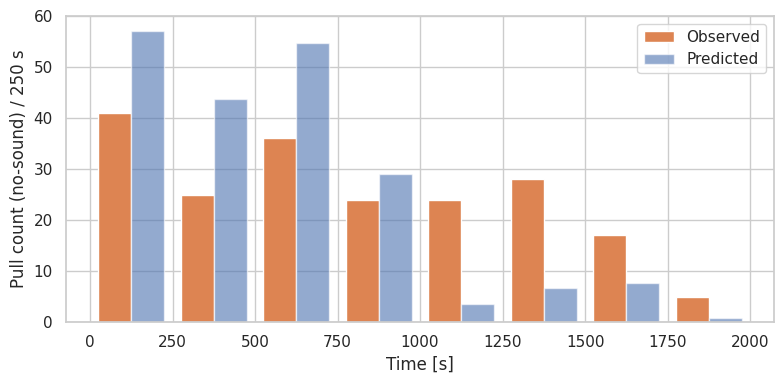

In [ ]:
# ----- 必要な入力 -----
# events         : 全試行データフレーム（t, state, action）
# Q_traj         : df_log などに保存した時点ごとの Q(0, pull) と Q(0, no-pull)
# epsilon        : ε-greedy の探索率
# bin_width      : 250  # [s]

# ============ 1. pull確率を時点ごとに計算 ============
def pull_prob_epsilon_greedy(q_pull, q_nop, eps):
    """音なし(s=0) の ε-greedy pull確率"""
    greedy_pull = (q_pull > q_nop)
    return (eps / 2) + (1 - eps) * greedy_pull

df_log['p_pull_pred'] = pull_prob_epsilon_greedy(
        df_log['Q_pull'], df_log['Q_nop'], epsilon)

# ============ 2. ビン内の試行数を数えて期待回数 ============
# ビン付け
events['bin']  = (events['t'] // bin_width) * bin_width + bin_width/2
df_log['bin']  = (df_log['t'] // bin_width) * bin_width + bin_width/2

# ① 観測：音なし pull 回数
obs_counts = (events[events.state==0]
              .groupby('bin')['action'].sum())

# ② 予測：音なし pull 回数 = Σ p_pull_pred
pred_counts = (df_log[df_log.state==0]
               .groupby('bin')['p_pull_pred'].sum())

# ③ 可視化
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.bar(obs_counts.index-50,  obs_counts.values, width=100, label='Observed', color='C1')
plt.bar(pred_counts.index+50, pred_counts.values, width=100, label='Predicted', color='C0', alpha=0.6)
plt.xlabel('Time [s]'); plt.ylabel('Pull count (no-sound) / 250 s')
plt.legend(); plt.tight_layout(); plt.show()


全試行数: 54000
フィルタリング後の試行数: 200


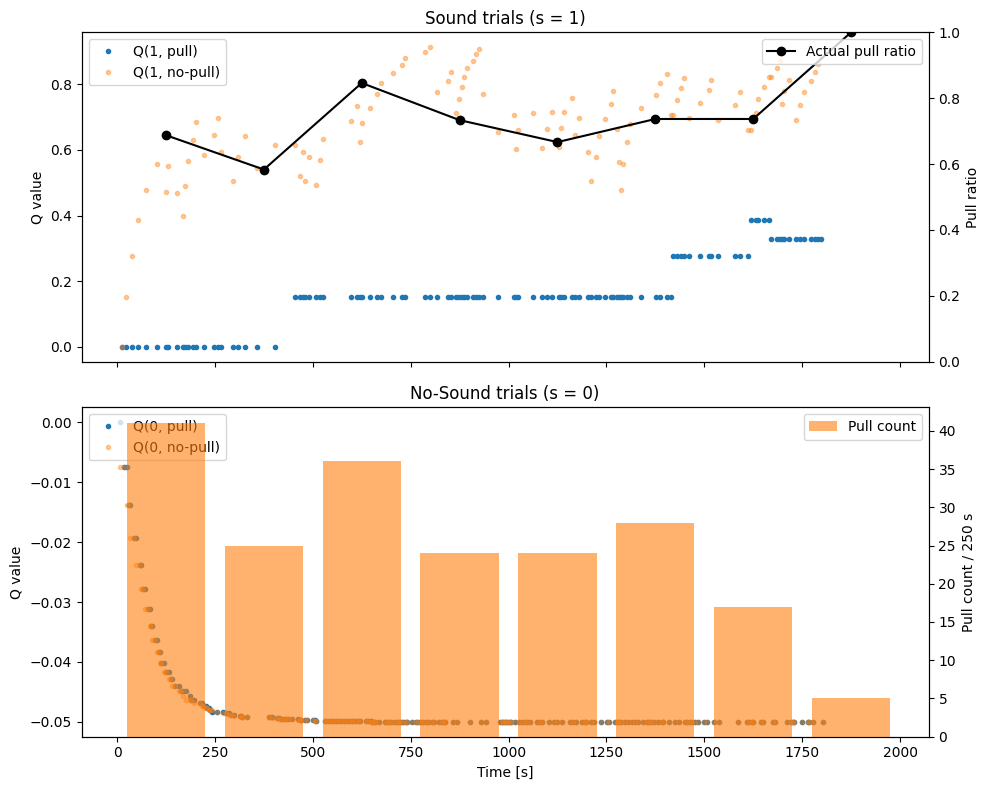

In [ ]:
# CSVファイルの読み込み
csv_path = Path('/content/drive/MyDrive/hackathon_data/VG1GC-105/task-day8/trials_L1L2.csv')
trials = pd.read_csv(csv_path)
print("全試行数:", len(trials))

# 条件に合致する行のフィルタリング
filtered_trials = trials[(trials['state_lever']==1) &
                         (trials['state_task'] == 0) &
                         (trials['diff_value'] > 0.4)].copy()
print("フィルタリング後の試行数:", len(filtered_trials))


filtered_trials['lever_time_nocue'] = filtered_trials['t'] - filtered_trials['diff_value']

# --- trials フィルタリング ---
filtered = trials.dropna(subset=['trial_outcome'])
filtered = filtered[
    (filtered['first_diff'] > 1.0) &
    (filtered['reaction_time'] > 0.091) &
    (filtered['reaction_time'] < 0.361)
].copy()


# --- 時間データ ---
sound_onsets = filtered['pull_onset']
nosound_onsets = filtered_trials['lever_time_nocue']

# trial_outcome が NaN でないもののうち、条件を満たさないが failer でもない行を抽出
rest = trials.dropna(subset=['trial_outcome'])
rest = rest[
    ~((rest['first_diff'] > 1.0) &
      (rest['reaction_time'] > 0.091) &
      (rest['reaction_time'] < 0.361))
].copy()
rest_pull_onsets=rest['pull_onset']

# ----------------------------  SET-UP  ----------------------------------
# ❶ 必要ライブラリ
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ❷ 必要な入力（あなたの環境に合わせて渡してください）
#    ・sound_onsets      : 音あり & pull         （1D array / Series）
#    ・rest_pull_onsets  : 音あり & no-pull 時刻  （1D array / Series）
#    ・nosound_onsets    : 音なし & pull          （1D array / Series）
# -----------------------------------------------------------------------

# ----------------------------  PARAMS  ----------------------------------
alpha      = 0.15   # Q 学習率
gamma      = 0.0    # 音なし後に将来価値を伝搬させない
epsilon    = 0.15   # ε-greedy 探索率 (≈ pull 割合 15 % に対応)
cost       = 0.05  # 音なし pull の罰則
bin_width  = 250    # 250 s ビンで集計
# -----------------------------------------------------------------------

# ----------------------------  BUILD EVENTS TABLE -----------------------
def make_df(ts, s, a, r):
    return pd.DataFrame({"t": ts, "state": s, "action": a, "reward": r})

events = pd.concat([
    make_df(sound_onsets,      1, 1, 1),          # 音あり pull → 報酬 1
    make_df(rest_pull_onsets,  1, 0, 0),          # 音あり no-pull → 報酬 0
    make_df(nosound_onsets,    0, 1, -cost)       # 音なし pull → 罰則
], ignore_index=True).sort_values("t").reset_index(drop=True)

# ビン中心を持つ列
events["bin"] = (events["t"] // bin_width) * bin_width + bin_width/2
# -----------------------------------------------------------------------

# ----------------------------  SARSA + ε-GREEDY -------------------------
Q = np.zeros((2, 2))          # Q[state, action]
log = []

rng = np.random.default_rng()

for i in range(len(events) - 1):
    s  = int(events.at[i,   "state"])
    r  = events.at[i,       "reward"]

    # ε-greedy 行動選択
    if rng.random() < epsilon:
        a = rng.integers(2)          # 0/1 ランダム探索
    else:
        a = np.argmax(Q[s])          # 活用

    # 次状態・行動（on-policy）
    sp = int(events.at[i+1, "state"])
    ap = np.argmax(Q[sp]) if rng.random() >= epsilon else rng.integers(2)

    # SARSA 更新
    td = r + gamma * Q[sp, ap] - Q[s, a]
    Q[s, a] += alpha * td

    # ログ
    log.append([
        events.at[i, "t"], s, a, Q[s, 1], Q[s, 0]
    ])

df_log = pd.DataFrame(
    log, columns=["t", "state", "action", "Q_pull", "Q_nop"]
)
# -----------------------------------------------------------------------

# ----------------------------  解析用集計 -------------------------------
# 音あり pull 率（pull / 全試行）
sound_trials = events[events.state == 1].groupby("bin")["action"]
pull_ratio_sound = sound_trials.mean()

# 音なし pull 回数
pull_count_nosound = (events[(events.state == 0) & (events.action == 1)]
                      .groupby("bin").size())

# Q 推移データを分離
mask_sound    = df_log.state == 1
mask_nosound  = df_log.state == 0
# -----------------------------------------------------------------------

# ----------------------------  PLOT -------------------------------------
fig, axes = plt.subplots(2, 1, figsize=(10, 8), sharex=True)

# ① 音あり：Q & pull-ratio
ax1 = axes[0]
ax1.plot(df_log.loc[mask_sound, "t"], df_log.loc[mask_sound, "Q_pull"],
         '.', label='Q(1, pull)')
ax1.plot(df_log.loc[mask_sound, "t"], df_log.loc[mask_sound, "Q_nop"],
         '.', label='Q(1, no-pull)', alpha=0.4)
ax1.set_ylabel('Q value')
ax1.set_title('Sound trials (s = 1)')
ax1.legend(loc='upper left')

ax1_twin = ax1.twinx()
ax1_twin.plot(pull_ratio_sound.index, pull_ratio_sound.values,
              'k-o', label='Actual pull ratio')
ax1_twin.set_ylim(0, 1)
ax1_twin.set_ylabel('Pull ratio')
ax1_twin.legend(loc='upper right')

# ② 音なし：Q & pull-count
ax2 = axes[1]
ax2.plot(df_log.loc[mask_nosound, "t"], df_log.loc[mask_nosound, "Q_pull"],
         '.', label='Q(0, pull)')
ax2.plot(df_log.loc[mask_nosound, "t"], df_log.loc[mask_nosound, "Q_nop"],
         '.', label='Q(0, no-pull)', alpha=0.4)
ax2.set_ylabel('Q value')
ax2.set_title('No-Sound trials (s = 0)')
ax2.legend(loc='upper left')

ax2_twin = ax2.twinx()
ax2_twin.bar(pull_count_nosound.index, pull_count_nosound.values,
             width=bin_width*0.8, color='C1', alpha=0.6,
             label='Pull count')
ax2_twin.set_ylabel('Pull count / 250 s')
ax2_twin.legend(loc='upper right')

ax2.set_xlabel('Time [s]')
plt.tight_layout()
plt.show()
# -----------------------------------------------------------------------

# ▼ 期待する挙動
# ・Q(1, pull) → ≈1 に収束し、pull ratio ≈1
# ・Q(0, pull) → 罰則で 0 近辺に落ち着く一方、
#   ε=0.15 の探索があるので pull count は ≈ 0.15 × 250 s ≃ 20〜40 回/ビン


In [ ]:
rest

,t,state_lever,state_task,start_time,stop_time,pull_onset,reaction_time,pull_duration_for_success,trial_outcome,diff_value,first_diff,lose
224,12.678400,0,0,11.878400,12.678400,12.645200,0.7738,0.3,miss,NaN,0.000000,L1
350,16.878599,0,0,15.845200,16.878599,NaN,NaN,0.3,failure,NaN,0.000000,L1
3578,124.479202,1,0,123.479202,124.479202,124.346001,0.8654,0.3,miss,NaN,0.933403,L2
4540,156.546204,0,0,154.079605,156.546204,154.246201,0.1656,0.3,success,NaN,0.500000,L2
4871,167.579605,1,0,167.379593,167.579605,167.513000,0.1364,0.3,miss,NaN,0.000000,L1
...,...,...,...,...,...,...,...,...,...,...,...,...
50046,1673.423950,0,0,1670.890625,1673.423950,1670.957153,0.0500,0.4,success,NaN,1.666626,L2
50813,1698.990845,0,0,1698.024048,1698.990845,1698.890747,0.8790,0.4,miss,NaN,0.066650,L1
51126,1709.424194,0,0,1708.424194,1709.424194,NaN,NaN,0.4,failure,NaN,0.000000,L1
51887,1734.791016,0,0,1734.490967,1734.791016,1734.757568,0.2426,0.4,miss,NaN,0.000000,L1


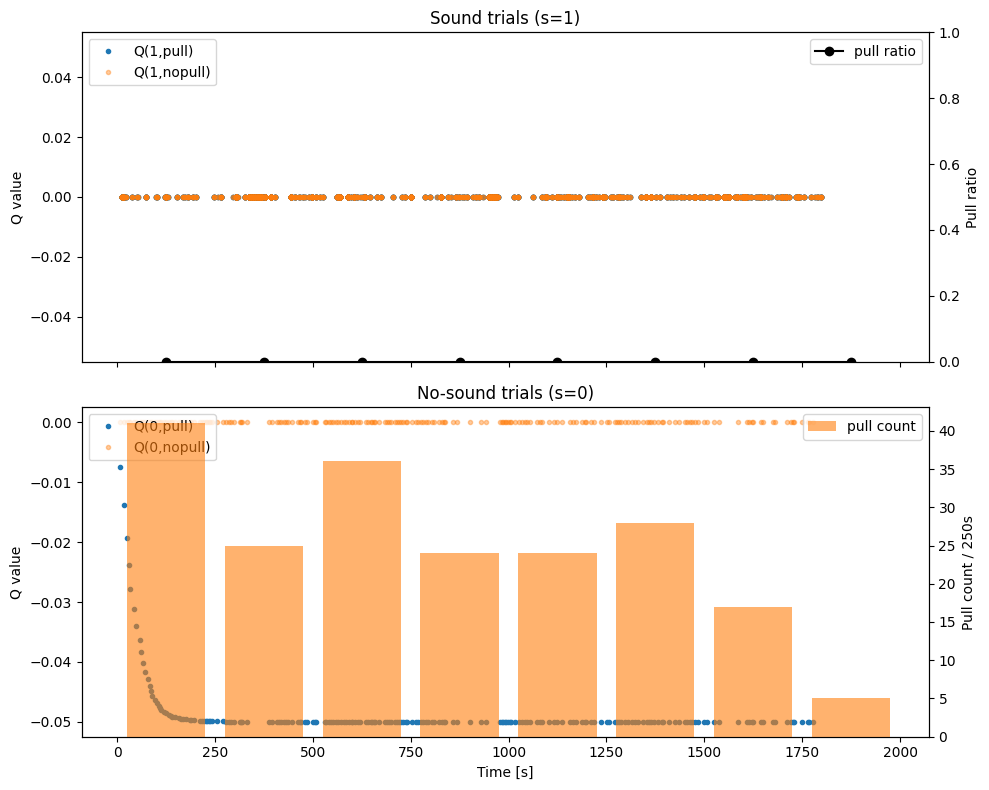

In [ ]:
"""
====================================================================
  OFF-POLICY SARSA で “内部 Q 値” を推定する最小構成
  ---------------------------------------------------
  - 観測データ（行動 = 実際にマウスが選択した行動）で Q を更新
  - ε-greedy は使わず、探索もシミュレーションもしない
  - 音あり no-pull 試行 (pull_onset == NaN) の時刻は
      1) 'sound_onset' 列があればそれを使用
      2) ない場合は 'start_time' 列
      3) それも無い場合は試行の先頭時刻 't'
====================================================================
"""

# ----------------------------  SET-UP  ------------------------------
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

# ---------- ❶ パラメータ（あとで cfg ファイルにしても可） ----------
CSV_PATH      = Path('/content/drive/MyDrive/hackathon_data/VG1GC-105/task-day8/trials_L1L2.csv')
THRESH_DIFF   = 0.4      # 音なし判定用
RT_LOWER, RT_UPPER = 0.091, 0.361
FIRST_DIFF_MIN     = 1.0

ALPHA   = 0.15   # 学習率
GAMMA   = 0.0    # 割引率（=0 なら 1 ステップ TD）
PENALTY = 0.05   # 音なし pull の罰則
BIN_W   = 250    # 集計ビン [s]
# -------------------------------------------------------------------

# ---------- ❷ データロード ----------
trials = pd.read_csv(CSV_PATH)

# ---------- ❸ 試行ごとの時刻列を定義 ----------
def get_sound_time(row):
    """音が鳴った時刻を返す（列が無ければ順にフォールバック）"""
    for col in ("sound_onset", "start_time", "t"):
        if col in row and not pd.isna(row[col]):
            return row[col]
    raise ValueError("音開始時刻を表す列が見つかりません")

trials["sound_time"] = trials.apply(get_sound_time, axis=1)

# ---------- ❹ 試行フィルタリング ----------
## 音なし & pull
mask_nosound_pull = (
    (trials.state_task == 0) &
    (trials.state_lever == 1) &
    (trials.diff_value  > THRESH_DIFF)
)
nosound_pull = trials.loc[mask_nosound_pull].copy()
nosound_pull["event_t"] = nosound_pull["t"] - nosound_pull["diff_value"]

## 音あり & pull (成功 / 失敗両方含む)
mask_sound = (
    (trials.state_task == 1) &               # 音あり
    (trials.state_lever == 1) &              # 引いた
    (trials.first_diff   > FIRST_DIFF_MIN) &
    (trials.reaction_time.between(RT_LOWER, RT_UPPER))
)
sound_pull = trials.loc[mask_sound].copy()
sound_pull["event_t"] = sound_pull["pull_onset"]

## 音あり & no-pull（pull_onset は NaN）
mask_sound_nopull = (
    (trials.state_task == 1) &
    (trials.state_lever == 0)
)
sound_nopull = trials.loc[mask_sound_nopull].copy()
sound_nopull["event_t"] = sound_nopull["sound_time"]

# ---------- ❺ イベント表 ----------
def build_events(df, state_val, action_val, reward_val):
    return pd.DataFrame({
        "t": df["event_t"],
        "state": state_val,
        "action": action_val,
        "reward": reward_val
    })

events = pd.concat([
    build_events(sound_pull,     1, 1, 1),         # 音あり pull  → +1
    build_events(sound_nopull,   1, 0, 0),         # 音あり nopull → 0
    build_events(nosound_pull,   0, 1, -PENALTY)   # 音なし pull   → −penalty
]).sort_values("t").reset_index(drop=True)

events["bin"] = (events.t // BIN_W) * BIN_W + BIN_W/2

# ---------- ❻ OFF-POLICY SARSA 更新 ----------
Q = np.zeros((2, 2))   # shape: [state, action]
log = []

for i in range(len(events) - 1):
    s, a, r = int(events.at[i,"state"]), int(events.at[i,"action"]), events.at[i,"reward"]
    sp, ap  = int(events.at[i+1,"state"]), int(events.at[i+1,"action"])  # “次の実際行動”

    td      = r + GAMMA * Q[sp, ap] - Q[s, a]
    Q[s, a] = Q[s, a] + ALPHA * td

    log.append([events.at[i,"t"], s, a, Q[s,1], Q[s,0]])

df_log = pd.DataFrame(log, columns=["t","state","action","Q_pull","Q_nop"])

# ---------- ❼ 集計 ----------
pull_ratio_sound = (
    events[events.state == 1]
    .groupby("bin")["action"].mean()
)
pull_count_nosound = (
    events[(events.state == 0) & (events.action == 1)]
    .groupby("bin").size()
)

# ---------- ❽ 可視化 ----------
fig, axes = plt.subplots(2, 1, figsize=(10, 8), sharex=True)

# ① 音あり
mask_sound_log = df_log.state == 1
ax = axes[0]
ax.plot(df_log.loc[mask_sound_log,"t"], df_log.loc[mask_sound_log,"Q_pull"], '.', label='Q(1,pull)')
ax.plot(df_log.loc[mask_sound_log,"t"], df_log.loc[mask_sound_log,"Q_nop"],  '.', alpha=0.4, label='Q(1,nopull)')
ax.set_ylabel("Q value")
ax.set_title("Sound trials (s=1)")
ax.legend(loc="upper left")

ax2 = ax.twinx()
ax2.plot(pull_ratio_sound.index, pull_ratio_sound.values, 'k-o', label='pull ratio')
ax2.set_ylim(0,1)
ax2.set_ylabel("Pull ratio")
ax2.legend(loc="upper right")

# ② 音なし
mask_nosound_log = df_log.state == 0
ax = axes[1]
ax.plot(df_log.loc[mask_nosound_log,"t"], df_log.loc[mask_nosound_log,"Q_pull"], '.', label='Q(0,pull)')
ax.plot(df_log.loc[mask_nosound_log,"t"], df_log.loc[mask_nosound_log,"Q_nop"],  '.', alpha=0.4, label='Q(0,nopull)')
ax.set_ylabel("Q value")
ax.set_title("No-sound trials (s=0)")
ax.legend(loc="upper left")

ax2 = ax.twinx()
ax2.bar(pull_count_nosound.index, pull_count_nosound.values,
        width=BIN_W*0.8, color='C1', alpha=0.6, label='pull count')
ax2.set_ylabel(f"Pull count / {BIN_W}s")
ax2.legend(loc="upper right")

axes[1].set_xlabel("Time [s]")
plt.tight_layout()
plt.show()


In [ ]:
trials

,t,state_lever,state_task,start_time,stop_time,pull_onset,reaction_time,pull_duration_for_success,trial_outcome,diff_value,first_diff,lose,sound_time
0,5.211800,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.211800
1,5.245000,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.245000
2,5.278400,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.278400
3,5.311800,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.311800
4,5.345000,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.345000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
53995,1805.058228,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1805.058228
53996,1805.091553,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1805.091553
53997,1805.124756,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1805.124756
53998,1805.158203,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1805.158203


In [ ]:
    # === 音なしレバー引き（diff_value > 0.4）===
    filtered_trials = trials[(trials['state_lever'] == 1) &
                             (trials['state_task'] == 0) &
                             (trials['diff_value'] > 0.4)].copy()
    filtered_trials['lever_time_nocue'] = filtered_trials['t'] - filtered_trials['diff_value']

    # === 音ありレバー引き（反応時間フィルタ）===
    filtered = trials.dropna(subset=['trial_outcome']).copy()
    filtered = filtered[
        (filtered['first_diff'] > 1.0) &
        (filtered['reaction_time'] > 0.091) &
        (filtered['reaction_time'] < 0.361)
    ].copy()

    #=== 音ありレバー無し　＝＝＝
    filtered_ = trials.dropna(subset=['trial_outcome']).copy()
    filtered_ = filtered_[
        (filtered_['trial_outcome'] == 'failure')
    ].copy()

    sound_onsets = filtered['pull_onset']
    no_sound_onsets = filtered_trials['lever_time_nocue']
    filterd_['start_time']


##数理モデル最終版

In [ ]:
#0530
import pandas as pd
from pathlib import Path

# ---------- ① データ読み込み ----------
CSV_PATH = Path('/content/drive/MyDrive/hackathon_data/VG1GC-105/task-day7/trials_L1L2.csv')
trials   = pd.read_csv(CSV_PATH)

# ---------- ② 音なし & pull  -----------------------------------------
mask_nosound_pull = (
    (trials.state_task == 0) &            # 音なし
    (trials.state_lever == 1) &           # レバーを押した記録
          # pull_onset が入っている (= 確実に押した)
    (trials.diff_value > 0.4)             # 閾値フィルタ
)
nosound_pull = trials.loc[mask_nosound_pull].copy()
nosound_pull['event_t'] = nosound_pull['t'] - nosound_pull['diff_value']   # lever_time_nocue

# ---------- ③ 音あり & pull  -----------------------------------------
mask_sound_pull = (    # 音あり
           # 押した
    (trials.first_diff   > 1.0) &         # 反応時間以外のフィルタ
    (trials.reaction_time.between(0.091, 0.361))
)
sound_pull = trials.loc[mask_sound_pull].copy()
sound_pull['event_t'] = sound_pull['pull_onset']          # レバーを引いた瞬間

# ---------- ④ 音あり & nopull  ---------------------------------------
mask_sound_nopull = (         # 音あり
           # レバーを引いていない
    (trials.trial_outcome == 'failure')   # 明示的に失敗扱い
)
sound_nopull = trials.loc[mask_sound_nopull].copy()

# 　ポイント時刻：音が鳴った瞬間
for col in ('sound_onset', 'start_time', 't'):            # 列の優先順
    if col in sound_nopull.columns:
        sound_nopull['event_t'] = sound_nopull[col]
        break
else:
    raise ValueError("sound_onset / start_time / t のいずれの列も見つかりません")

# ---------- ⑤ デバッグ用に件数を確認 ----------
print(f"音なし pull       : {len(nosound_pull):3d} trials")
print(f"音あり pull        : {len(sound_pull):3d} trials")
print(f"音あり nopull      : {len(sound_nopull):3d} trials")

# ---------- ⑥ 目的の Series (時刻) を用意 -----------------------------
sound_onsets    = sound_pull['event_t'].reset_index(drop=True)     # 音あり pull
no_sound_onsets = nosound_pull['event_t'].reset_index(drop=True)   # 音なし pull
sound_nopull_on = sound_nopull['event_t'].reset_index(drop=True)   # 音あり nopull

# 使いたいならまとめて dict に
onset_dict = {
    'sound_pull'   : sound_onsets,
    'nosound_pull' : no_sound_onsets,
    'sound_nopull' : sound_nopull_on,
}


音なし pull       : 283 trials
音あり pull        :  51 trials
音あり nopull      :  26 trials


音なし pull       : 283
音あり pull        :  51
音あり nopull      :  26


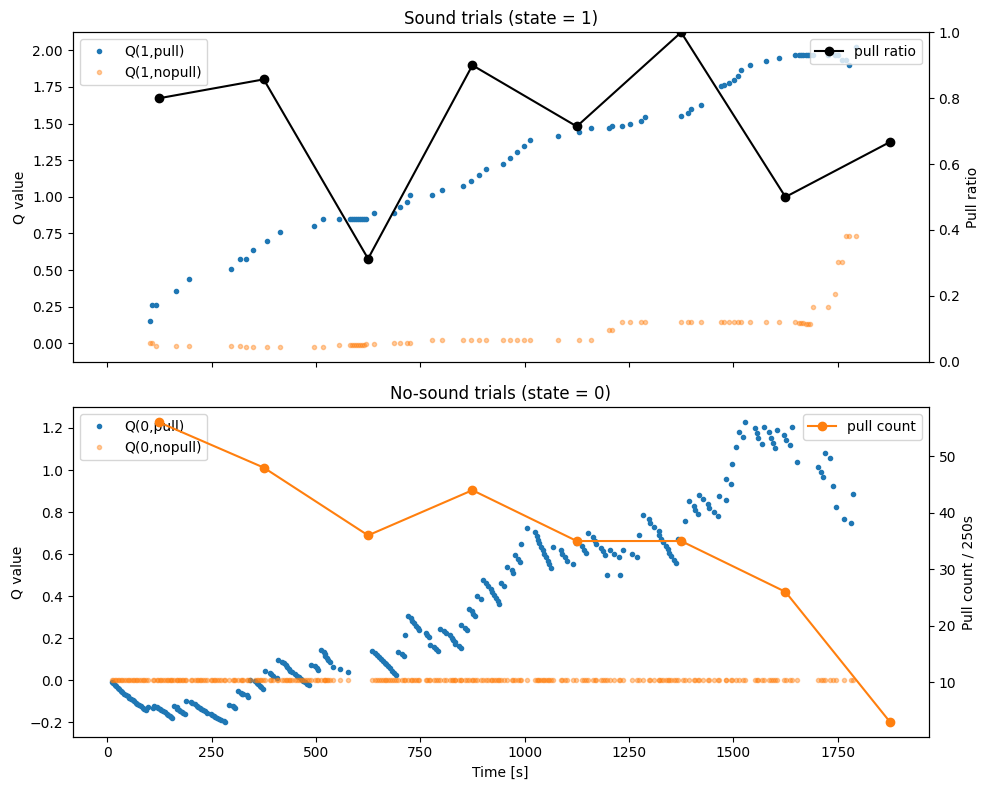

In [ ]:
"""
====================================================================
  OFF-POLICY SARSA でマウスの “内部 Q 値” を推定する最小構成（改訂版）
  ---------------------------------------------------------------
  * 3 カテゴリの試行を重複なく抽出
      1. 音なし & pull
      2. 音あり & pull
      3. 音あり & nopull（pull_onset==NaN）
  * イベント時刻
      ─ 音なし & pull        : t − diff_value  (= lever_time_nocue)
      ─ 音あり & pull        : pull_onset
      ─ 音あり & nopull      : 音開始時刻（sound_onset → start_time → t の優先順）
  * TD 更新は OFF-POLICY SARSA
====================================================================
"""

# ----------------------------  SET-UP  -----------------------------
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

# ---------- ❶ パラメータ ----------
CSV_PATH      = Path('/content/drive/MyDrive/hackathon_data/VG1GC-105/task-day7/trials_L1L2.csv')
THRESH_DIFF   = 0.4                 # 音なし判定用 diff_value 閾値
RT_LOWER, RT_UPPER = 0.091, 0.361   # 音あり pull の反応時間フィルタ
FIRST_DIFF_MIN     = 1.0            # 反応時間フィルタ 2
ALPHA   = 0.15                      # 学習率
GAMMA   = 0.90                      # 割引率 (0.0 なら逐次平均)
PENALTY = 0.05                      # 音なし pull 罰則
BIN_W   = 250                       # pull 率集計ビン [s]

# ---------------------------- ❷ データ -----------------------------
trials = pd.read_csv(CSV_PATH)

# ---------------------------- ❸ 試行抽出 ---------------------------
## --- 3.1  音なし & pull  ------------------------------------------
mask_nosound_pull = (
    (trials.state_task == 0) &          # 音なし
    (trials.state_lever == 1) &         # レバー押しフラグ
       # pull_onset が存在
    (trials.diff_value > THRESH_DIFF)   # diff_value 閾値
)
nosound_pull = trials.loc[mask_nosound_pull].copy()
nosound_pull['event_t'] = nosound_pull['t'] - nosound_pull['diff_value']

## --- 3.2  音あり & pull  ------------------------------------------
mask_sound_pull = (
       # 音あり
        # レバーを押した
    (trials.first_diff > FIRST_DIFF_MIN) &
    (trials.reaction_time.between(RT_LOWER, RT_UPPER))
)
sound_pull = trials.loc[mask_sound_pull].copy()
sound_pull['event_t'] = sound_pull['pull_onset']

## --- 3.3  音あり & nopull -----------------------------------------
mask_sound_nopull = (
         # 音あり
    trials.pull_onset.isna() &          # レバーを押していない
    (trials.trial_outcome == 'failure') # 明示的失敗
)
sound_nopull = trials.loc[mask_sound_nopull].copy()

for col in ('sound_onset', 'start_time', 't'):      # 音開始時刻の優先順
    if col in sound_nopull.columns:
        sound_nopull['event_t'] = sound_nopull[col]
        break
else:
    raise ValueError('sound_onset / start_time / t が見つかりません')

# ------- ❸-A デバッグ：件数確認 -------
print(f"音なし pull       : {len(nosound_pull):3d}")
print(f"音あり pull        : {len(sound_pull):3d}")
print(f"音あり nopull      : {len(sound_nopull):3d}")

# ---------------------------- ❹ イベント表 --------------------------
def build_events(df, state_val, action_val, reward_val):
    return pd.DataFrame({
        't'     : df['event_t'],
        'state' : state_val,       # 0: no-sound, 1: sound
        'action': action_val,      # 0: nopull,  1: pull
        'reward': reward_val
    })

events = pd.concat([
    build_events(sound_pull,     1, 1,  1),           # 正報酬
    build_events(sound_nopull,   1, 0,  0),           # 無報酬
    build_events(nosound_pull,   0, 1, -PENALTY)      # 罰則
]).sort_values('t').reset_index(drop=True)

# pull 率／pull 回数 集計用ビン
events['bin'] = (events.t // BIN_W) * BIN_W + BIN_W/2

# ---------------------------- ❺ SARSA 更新 --------------------------
Q = np.zeros((2, 2))          # Q[state, action]
log = []

for i in range(len(events) - 1):
    s, a, r = int(events.at[i,   'state']), int(events.at[i,   'action']), events.at[i,   'reward']
    sp, ap  = int(events.at[i+1, 'state']), int(events.at[i+1, 'action'])
    td      = r + GAMMA * Q[sp, ap] - Q[s, a]
    Q[s, a] = Q[s, a] + ALPHA * td
    # ログ：pull/nopull それぞれの Q
    log.append([events.at[i, 't'], s, a, Q[s, 1], Q[s, 0]])

df_log = pd.DataFrame(log, columns=['t', 'state', 'action', 'Q_pull', 'Q_nop'])

# ---------------------------- ❻ 指標 -------------------------------
pull_ratio_sound = (
    events[events.state == 1]
    .groupby('bin')['action'].mean()
)
pull_count_nosound = (
    events[(events.state == 0) & (events.action == 1)]
    .groupby('bin').size()
)



# ---------- 可視化 ----------
fig, axes = plt.subplots(2, 1, figsize=(10, 8), sharex=True)

# 音あり
mask_sound_log = df_log.state == 1
ax = axes[0]
ax.plot(df_log.loc[mask_sound_log, 't'], df_log.loc[mask_sound_log, 'Q_pull'], '.', label='Q(1,pull)')
ax.plot(df_log.loc[mask_sound_log, 't'], df_log.loc[mask_sound_log, 'Q_nop'], '.', alpha=0.4, label='Q(1,nopull)')
ax.set_ylabel('Q value')
ax.set_title('Sound trials (state = 1)')
ax.legend(loc='upper left')

ax2 = ax.twinx()
ax2.plot(pull_ratio_sound.index, pull_ratio_sound.values, 'k-o', label='pull ratio')
ax2.set_ylim(0, 1)
ax2.set_ylabel('Pull ratio')
ax2.legend(loc='upper right')

# 音なし
mask_nosound_log = df_log.state == 0
ax = axes[1]
ax.plot(df_log.loc[mask_nosound_log, 't'], df_log.loc[mask_nosound_log, 'Q_pull'], '.', label='Q(0,pull)')
ax.plot(df_log.loc[mask_nosound_log, 't'], df_log.loc[mask_nosound_log, 'Q_nop'], '.', alpha=0.4, label='Q(0,nopull)')
ax.set_ylabel('Q value')
ax.set_title('No-sound trials (state = 0)')
ax.legend(loc='upper left')

ax2 = ax.twinx()
ax2.plot(pull_count_nosound.index, pull_count_nosound.values, 'C1-o', label='pull count')
ax2.set_ylabel(f'Pull count / {BIN_W}s')
ax2.legend(loc='upper right')

axes[1].set_xlabel('Time [s]')
plt.tight_layout()
plt.show()


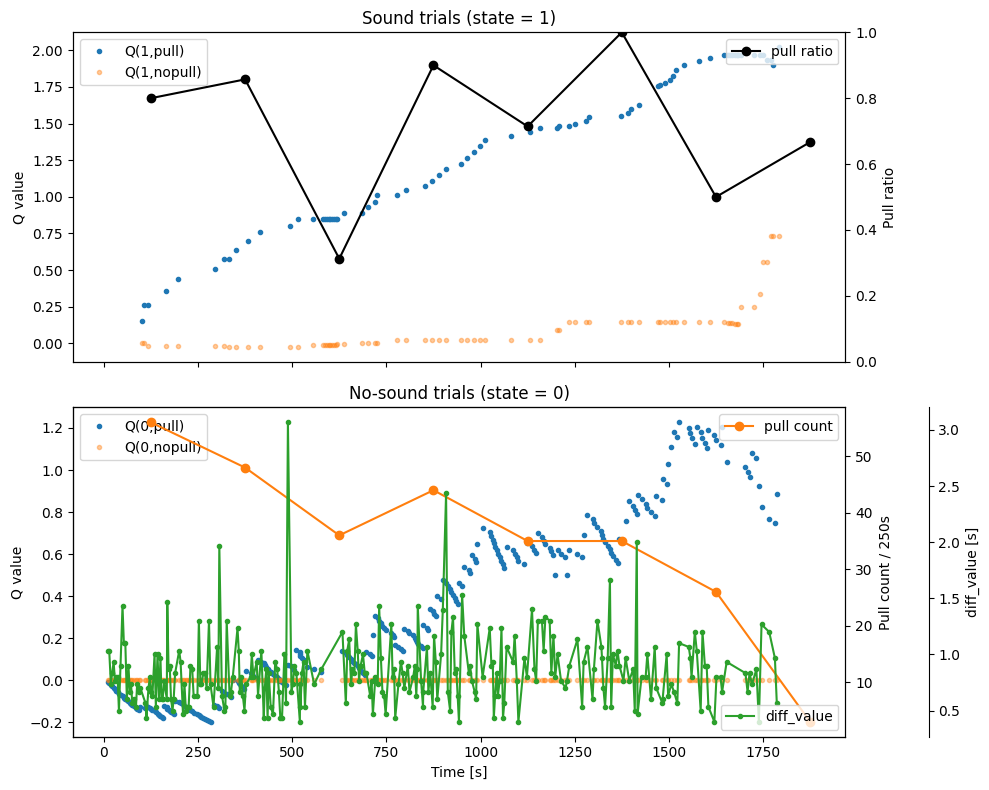

In [ ]:
# ---------- 可視化（Diff_value も追加） ----------
fig, axes = plt.subplots(2, 1, figsize=(10, 8), sharex=True)

# --- ① 音ありトライアルの Q と pull ratio ---
mask_sound_log = df_log.state == 1
ax = axes[0]
ax.plot(df_log.loc[mask_sound_log, 't'],
        df_log.loc[mask_sound_log, 'Q_pull'],   '.', label='Q(1,pull)')
ax.plot(df_log.loc[mask_sound_log, 't'],
        df_log.loc[mask_sound_log, 'Q_nop'],    '.', alpha=0.4, label='Q(1,nopull)')
ax.set_ylabel('Q value')
ax.set_title('Sound trials (state = 1)')
ax.legend(loc='upper left')

ax2 = ax.twinx()
ax2.plot(pull_ratio_sound.index,
         pull_ratio_sound.values,            'k-o', label='pull ratio')
ax2.set_ylim(0, 1)
ax2.set_ylabel('Pull ratio')
ax2.legend(loc='upper right')


# --- ② 音なしトライアルの Q, pull count, diff_value 推移 ---
mask_nosound_log = df_log.state == 0
ax = axes[1]
# Q values
ax.plot(df_log.loc[mask_nosound_log, 't'],
        df_log.loc[mask_nosound_log, 'Q_pull'],   '.', label='Q(0,pull)')
ax.plot(df_log.loc[mask_nosound_log, 't'],
        df_log.loc[mask_nosound_log, 'Q_nop'],    '.', alpha=0.4, label='Q(0,nopull)')
ax.set_ylabel('Q value')
ax.set_title('No-sound trials (state = 0)')
ax.legend(loc='upper left')

# pull count
ax2 = ax.twinx()
ax2.plot(pull_count_nosound.index,
         pull_count_nosound.values,         'C1-o', label='pull count')
ax2.set_ylabel(f'Pull count / {BIN_W}s')
ax2.legend(loc='upper right')

# diff_value の推移
ax3 = ax.twinx()
ax3.spines['right'].set_position(('outward', 60))   # 第3軸を右にオフセット
ax3.plot(nosound_pull['event_t'],
         nosound_pull['diff_value'],          'C2.-', label='diff_value')
ax3.set_ylabel('diff_value [s]')
ax3.legend(loc='lower right')

axes[1].set_xlabel('Time [s]')
plt.tight_layout()
plt.show()


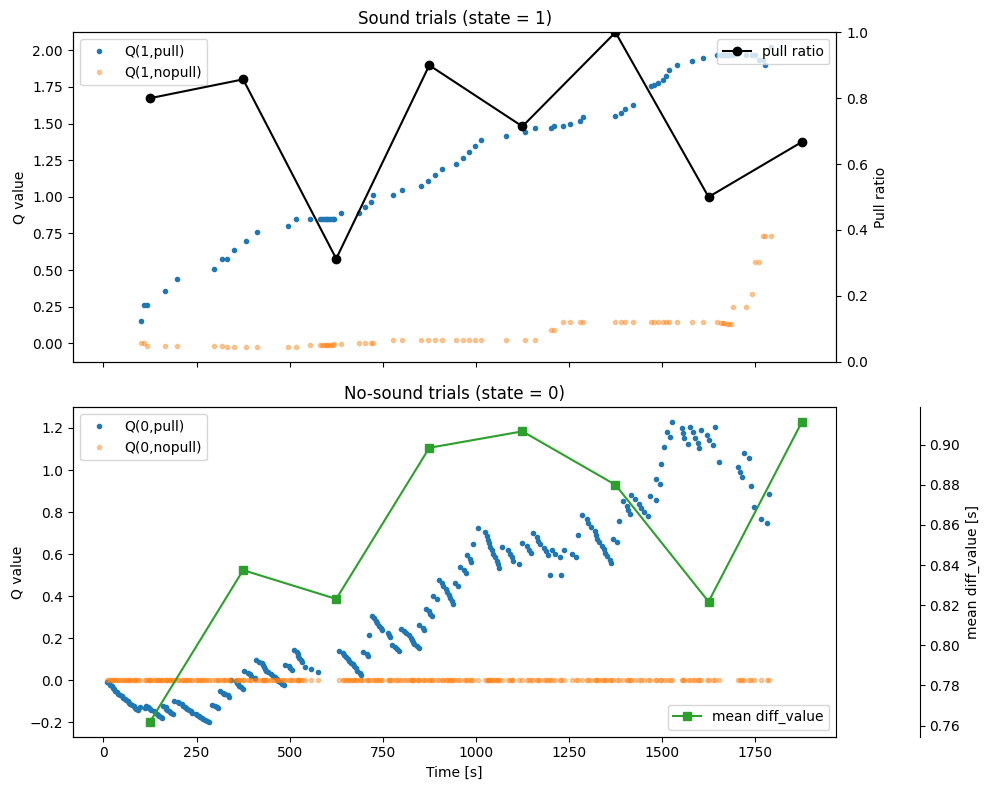

In [ ]:
# === 可視化：250秒ビンごとに3本軸で表示 ===
# 前提変数: nosound_pull, df_log, pull_ratio_sound, pull_count_nosound

# ① 250秒ビンを追加
BIN_W = 250
nosound_pull['bin'] = (nosound_pull['event_t'] // BIN_W) * BIN_W + BIN_W/2
diff_mean_nosound = nosound_pull.groupby('bin')['diff_value'].mean()

# ② プロット
fig, axes = plt.subplots(2, 1, figsize=(10, 8), sharex=True)

# -- 上段：音ありトライアルのQとpull ratio --
mask_sound = df_log.state == 1
ax = axes[0]
ax.plot(df_log.loc[mask_sound, 't'], df_log.loc[mask_sound, 'Q_pull'], '.', label='Q(1,pull)')
ax.plot(df_log.loc[mask_sound, 't'], df_log.loc[mask_sound, 'Q_nop'], '.', alpha=0.4, label='Q(1,nopull)')
ax.set_ylabel('Q value')
ax.set_title('Sound trials (state = 1)')
ax.legend(loc='upper left')

ax2 = ax.twinx()
ax2.plot(pull_ratio_sound.index, pull_ratio_sound.values, 'k-o', label='pull ratio')
ax2.set_ylim(0, 1)
ax2.set_ylabel('Pull ratio')
ax2.legend(loc='upper right')

# -- 下段：音なしトライアルのQ, pull count, diff_value --
mask_nosound = df_log.state == 0
ax = axes[1]
ax.plot(df_log.loc[mask_nosound, 't'], df_log.loc[mask_nosound, 'Q_pull'], '.', label='Q(0,pull)')
ax.plot(df_log.loc[mask_nosound, 't'], df_log.loc[mask_nosound, 'Q_nop'], '.', alpha=0.4, label='Q(0,nopull)')
ax.set_ylabel('Q value')
ax.set_title('No-sound trials (state = 0)')
ax.legend(loc='upper left')



# 第3軸：diff_value
ax3 = ax.twinx()
ax3.spines['right'].set_position(('outward', 60))
ax3.plot(diff_mean_nosound.index, diff_mean_nosound.values, 'C2-s', label='mean diff_value')
ax3.set_ylabel('mean diff_value [s]')
ax3.legend(loc='lower right')

axes[1].set_xlabel('Time [s]')
plt.tight_layout()
plt.show()


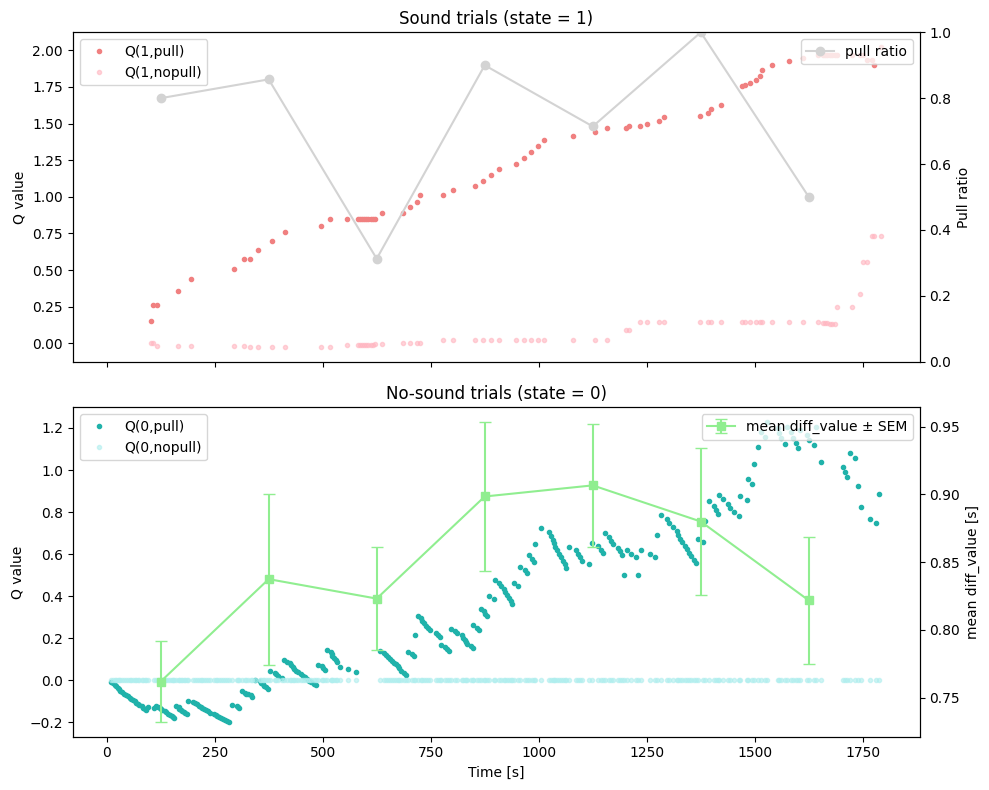

In [ ]:

# ---------- 可視化（1750秒以降除外＆パステルカラー） ----------
# 1750秒未満のビンに限定
mask_bins = diff_mean.index < 1750
diff_mean = diff_mean[mask_bins]; diff_sem = diff_sem[mask_bins]
pull_ratio_sound = pull_ratio_sound[pull_ratio_sound.index < 1750]

fig, axes = plt.subplots(2, 1, figsize=(10, 8), sharex=True)

# 音あり：Q & pull ratio
mask_sound = df_log.state==1
ax = axes[0]
ax.plot(df_log.loc[mask_sound,'t'], df_log.loc[mask_sound,'Q_pull'], '.', color='lightcoral', label='Q(1,pull)')
ax.plot(df_log.loc[mask_sound,'t'], df_log.loc[mask_sound,'Q_nop'], '.', alpha=0.6, color='lightpink', label='Q(1,nopull)')
ax.set_ylabel('Q value'); ax.set_title('Sound trials (state = 1)'); ax.legend(loc='upper left')
ax2 = ax.twinx()
ax2.plot(pull_ratio_sound.index, pull_ratio_sound.values, 'o-', color='lightgray', label='pull ratio')
ax2.set_ylim(0,1); ax2.set_ylabel('Pull ratio'); ax2.legend(loc='upper right')

# 音なし：Q & diff_value ± SEM
mask_nosound = df_log.state==0
ax = axes[1]
ax.plot(df_log.loc[mask_nosound,'t'], df_log.loc[mask_nosound,'Q_pull'], '.', color='lightseagreen', label='Q(0,pull)')
ax.plot(df_log.loc[mask_nosound,'t'], df_log.loc[mask_nosound,'Q_nop'], '.', alpha=0.6, color='paleturquoise', label='Q(0,nopull)')
ax.set_ylabel('Q value'); ax.set_title('No-sound trials (state = 0)'); ax.legend(loc='upper left')
ax2 = ax.twinx()
ax2.errorbar(diff_mean.index, diff_mean.values, yerr=diff_sem.values,
             fmt='s-', capsize=4, color='lightgreen', label='mean diff_value ± SEM')
ax2.set_ylabel('mean diff_value [s]'); ax2.legend(loc='upper right')

axes[1].set_xlabel('Time [s]')
plt.tight_layout()
plt.show()

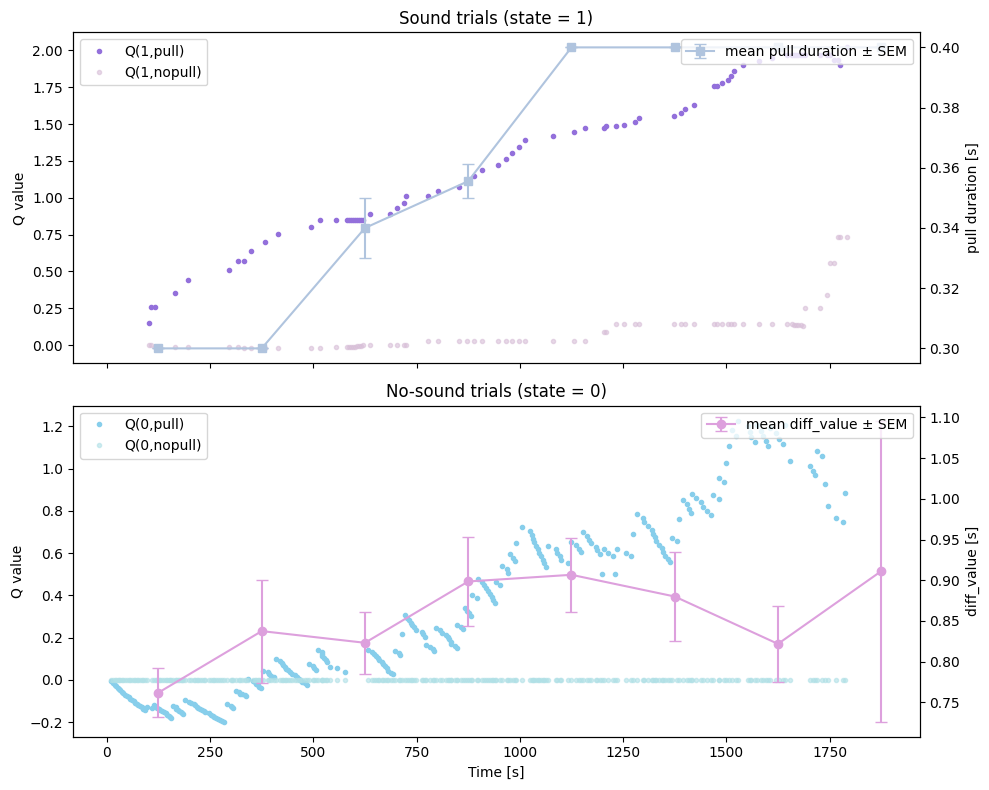

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

# ---------- データ読み込み & 前処理（最小限） ----------
CSV_PATH = Path('/content/drive/MyDrive/hackathon_data/VG1GC-105/task-day7/trials_L1L2.csv')
trials   = pd.read_csv(CSV_PATH)

# 抽出処理（音なし & pull / 音あり & pull / 音あり & nopull）
mask_nosound_pull = (trials.state_task==0)&(trials.state_lever==1)&(trials.diff_value>0.4)
mask_sound_pull   = (trials.first_diff>1.0)&trials.reaction_time.between(0.091,0.361)
mask_sound_nopull = (trials.trial_outcome=='failure')
nosound_pull = trials.loc[mask_nosound_pull].copy(); nosound_pull['event_t'] = nosound_pull['t'] - nosound_pull['diff_value']
sound_pull   = trials.loc[mask_sound_pull].copy();   sound_pull['event_t']   = sound_pull['pull_onset']
sound_nopull = trials.loc[mask_sound_nopull].copy()
for col in ('sound_onset','start_time','t'):
    if col in sound_nopull.columns:
        sound_nopull['event_t'] = sound_nopull[col]; break

# イベント表
def build_events(df,s,a,r):
    return pd.DataFrame({'t':df['event_t'],'state':s,'action':a,'reward':r})
events = pd.concat([
    build_events(sound_pull,1,1,1),
    build_events(sound_nopull,1,0,0),
    build_events(nosound_pull,0,1,-0.05)
]).sort_values('t').reset_index(drop=True)
events['bin'] = (events.t//250)*250 + 125

# Q 更新 & log
Q = np.zeros((2,2)); log=[]
for i in range(len(events)-1):
    s,a,r = int(events.at[i,'state']),int(events.at[i,'action']),events.at[i,'reward']
    sp,ap = int(events.at[i+1,'state']),int(events.at[i+1,'action'])
    td = r + 0.9*Q[sp,ap] - Q[s,a]
    Q[s,a] += 0.15*td
    log.append([events.at[i,'t'],s,a,Q[s,1],Q[s,0]])
df_log = pd.DataFrame(log,columns=['t','state','action','Q_pull','Q_nop'])
pull_ratio_sound = events[events.state==1].groupby('bin')['action'].mean()
nosound_pull['bin'] = (nosound_pull['event_t']//250)*250 + 125

# diff_value の平均と SEM
grouped = nosound_pull.groupby('bin')['diff_value']
diff_mean = grouped.mean()
diff_sem  = grouped.sem()

# ========= 可視化（パステル紫系 & 水色系）=============================
# 前提: df_log, sound_pull, nosound_pull がすでに定義されている
BIN_W = 250

# --- sound_pull: 250 s ビンごとのレバー引き時間（pull_duration_for_success）---
sound_pull['bin'] = (sound_pull['event_t'] // BIN_W) * BIN_W + BIN_W/2
gp_sound = sound_pull.groupby('bin')['pull_duration_for_success']
pd_mean  = gp_sound.mean()
pd_sem   = gp_sound.sem()

# --- nosound_pull: 250 s ビンごとの diff_value（lever_time_nocue）---
nosound_pull['bin'] = (nosound_pull['event_t'] // BIN_W) * BIN_W + BIN_W/2
gp_nosound = nosound_pull.groupby('bin')['diff_value']
dv_mean = gp_nosound.mean()
dv_sem  = gp_nosound.sem()

# （オプション）1750 s 未満だけ表示したい場合は以下を有効化
# pd_mean,  pd_sem  = pd_mean[pd_mean.index  < 1750], pd_sem[pd_sem.index  < 1750]
# dv_mean,  dv_sem  = dv_mean[dv_mean.index  < 1750], dv_sem[dv_sem.index  < 1750]

fig, axes = plt.subplots(2, 1, figsize=(10, 8), sharex=True)

# ---------- ① 音あり (state=1) ----------
mask_sound = df_log.state == 1
ax = axes[0]
ax.plot(df_log.loc[mask_sound, 't'],
        df_log.loc[mask_sound, 'Q_pull'],
        '.', label='Q(1,pull)',  color='mediumpurple')
ax.plot(df_log.loc[mask_sound, 't'],
        df_log.loc[mask_sound, 'Q_nop'],
        '.', alpha=0.6, label='Q(1,nopull)', color='thistle')
ax.set_ylabel('Q value')
ax.set_title('Sound trials (state = 1)')
ax.legend(loc='upper left')

# 2 本目の軸でレバー引き時間（エラーバー付き）
ax2 = ax.twinx()
ax2.errorbar(pd_mean.index, pd_mean.values,
             yerr=pd_sem.values,
             fmt='s-', capsize=4,
             color='lightsteelblue',
             label='mean pull duration ± SEM')
ax2.set_ylabel('pull duration [s]')
ax2.legend(loc='upper right')

# ---------- ② 音なし (state=0) ----------
mask_nosound = df_log.state == 0
ax = axes[1]
ax.plot(df_log.loc[mask_nosound, 't'],
        df_log.loc[mask_nosound, 'Q_pull'],
        '.', label='Q(0,pull)',  color='skyblue')
ax.plot(df_log.loc[mask_nosound, 't'],
        df_log.loc[mask_nosound, 'Q_nop'],
        '.', alpha=0.6, label='Q(0,nopull)', color='powderblue')
ax.set_ylabel('Q value')
ax.set_title('No-sound trials (state = 0)')
ax.legend(loc='upper left')

# 2 本目の軸で diff_value（エラーバー付き）
ax2 = ax.twinx()
ax2.errorbar(dv_mean.index, dv_mean.values,
             yerr=dv_sem.values,
             fmt='o-', capsize=4,
             color='plum',
             label='mean diff_value ± SEM')
ax2.set_ylabel('diff_value [s]')
ax2.legend(loc='upper right')

axes[1].set_xlabel('Time [s]')
plt.tight_layout()
plt.show()


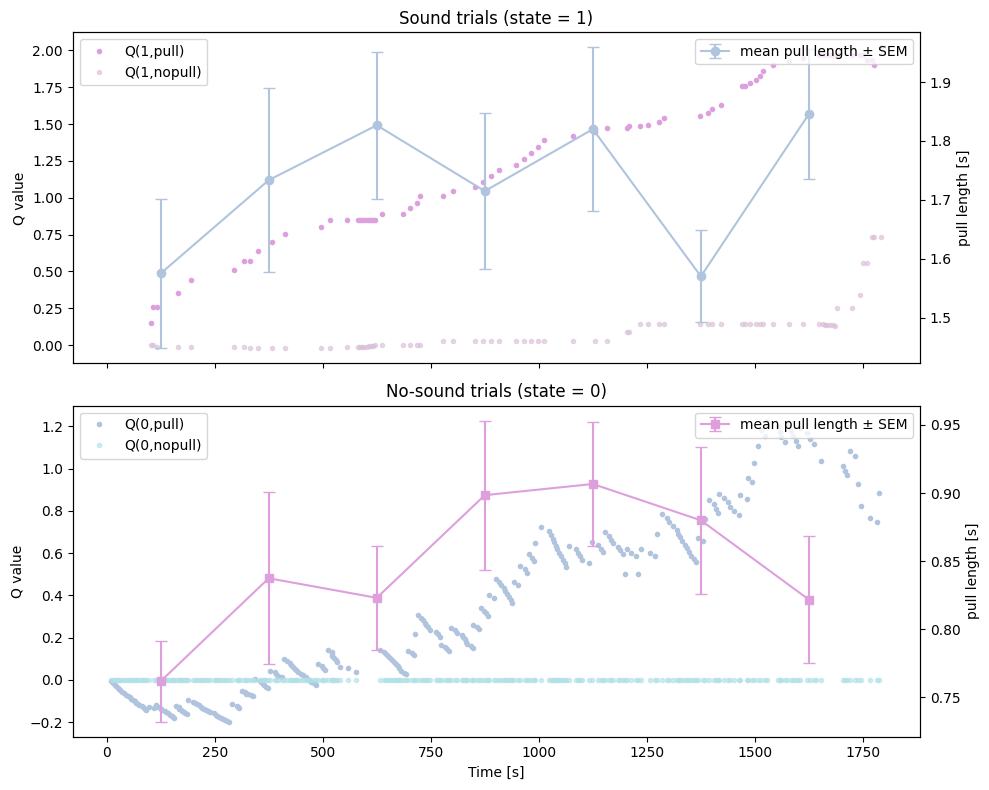

In [ ]:
# ===============================================================
# ❶ 250 s ビン平均 & SEM の準備
# ---------------------------------------------------------------
BIN_W = 250

# ―― 音あり試行（state = 1）first_diff ――
sound_pull['bin'] = (sound_pull['event_t'] // BIN_W) * BIN_W + BIN_W/2
fd_mean = sound_pull.groupby('bin')['first_diff'].mean()
fd_sem  = sound_pull.groupby('bin')['first_diff'].sem()

# ―― 音なし試行（state = 0）diff_value ――
nosound_pull['bin'] = (nosound_pull['event_t'] // BIN_W) * BIN_W + BIN_W/2
dv_mean = nosound_pull.groupby('bin')['diff_value'].mean()
dv_sem  = nosound_pull.groupby('bin')['diff_value'].sem()

# 1750 s 以降は描かない
fd_sel = fd_mean.index < 1750
dv_sel = dv_mean.index < 1750
fd_mean, fd_sem = fd_mean[fd_sel], fd_sem[fd_sel]
dv_mean, dv_sem = dv_mean[dv_sel], dv_sem[dv_sel]

# ===============================================================
# ❷ 可視化（パステル紫系 & 水色系、pull_rate は表示しない）
# ---------------------------------------------------------------
fig, axes = plt.subplots(2, 1, figsize=(10, 8), sharex=True)

# ---------- A. 音あり (state = 1) ----------
mask_sound = df_log.state == 1
ax = axes[0]

# Q 値
ax.plot(df_log.loc[mask_sound,'t'],
        df_log.loc[mask_sound,'Q_pull'], '.', color='plum', label='Q(1,pull)')
ax.plot(df_log.loc[mask_sound,'t'],
        df_log.loc[mask_sound,'Q_nop'],  '.', color='thistle', alpha=0.6, label='Q(1,nopull)')

# first_diff ± SEM（第 2 軸）
ax2 = ax.twinx()
ax2.errorbar(fd_mean.index, fd_mean.values, yerr=fd_sem.values,
             fmt='o-', capsize=4, color='lightsteelblue',
             label='mean pull length ± SEM')

# 軸ラベル等
ax.set_ylabel('Q value')
ax.set_title('Sound trials (state = 1)')
ax.legend(loc='upper left')
ax2.set_ylabel('pull length [s]')
ax2.legend(loc='upper right')

# ---------- B. 音なし (state = 0) ----------
mask_nosound = df_log.state == 0
ax = axes[1]

# Q 値
ax.plot(df_log.loc[mask_nosound,'t'],
        df_log.loc[mask_nosound,'Q_pull'], '.', color='lightsteelblue', label='Q(0,pull)')
ax.plot(df_log.loc[mask_nosound,'t'],
        df_log.loc[mask_nosound,'Q_nop'],  '.', color='powderblue',   alpha=0.6, label='Q(0,nopull)')

# diff_value ± SEM（第 2 軸）
ax2 = ax.twinx()
ax2.errorbar(dv_mean.index, dv_mean.values, yerr=dv_sem.values,
             fmt='s-', capsize=4, color='plum',
             label='mean pull length ± SEM')

# 軸ラベル等
ax.set_ylabel('Q value')
ax.set_title('No-sound trials (state = 0)')
ax.legend(loc='upper left')
ax2.set_ylabel('pull length [s]')
ax2.legend(loc='upper right')

axes[1].set_xlabel('Time [s]')
plt.tight_layout()
plt.show()


In [ ]:
# 相関をみたい！！
BIN_W = 250

# ❷ df_log にビン列を追加
df_log['bin'] = (df_log['t'] // BIN_W) * BIN_W + BIN_W/2

# ❸ 音ありトライアルの Q_pull のビン平均
q_pull_mean = (
    df_log[df_log.state == 1]
    .groupby('bin')['Q_pull']
    .mean()
)

# ❹ sound_pull で作成済みの first_diff ビン平均 (fd_mean) を再利用
#     — もし前のセルで fd_mean を作っていなければ、同じビン振りをして作成してください
#     例：
# sound_pull['bin'] = (sound_pull['event_t'] // BIN_W) * BIN_W + BIN_W/2
# fd_mean = sound_pull.groupby('bin')['first_diff'].mean()

# ❺ 相関用データフレームを結合
corr_df = pd.concat([q_pull_mean, fd_mean], axis=1, join='inner')
corr_df.columns = ['Q_pull', 'first_diff']

# ❻ ピアソン / スピアマン相関を計算
from scipy.stats import pearsonr, spearmanr

pear_r,  pear_p  = pearsonr (corr_df['Q_pull'], corr_df['first_diff'])
spear_r, spear_p = spearmanr(corr_df['Q_pull'], corr_df['first_diff'])

print(f"Pearson  r = {pear_r:.3f},  p = {pear_p:.3g}")
print(f"Spearman ρ = {spear_r:.3f},  p = {spear_p:.3g}")


Pearson  r = 0.368,  p = 0.416
Spearman ρ = 0.286,  p = 0.535


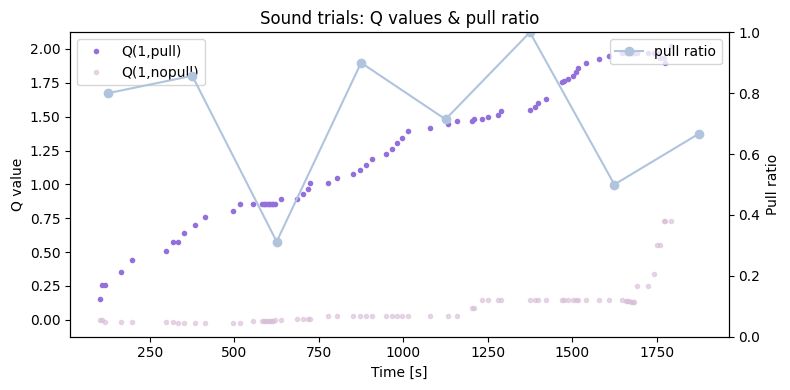

In [ ]:
# ========= pull ratio = 音あり pull ／(音あり pull + 音あり nopull) =========
# 前提: events  (columns: t, state, action, reward, bin) と df_log が既に存在

# --- ①  ビンごとに pull と nopull の回数を数える --------------------------
sound_counts = (
    events[events.state == 1]          # 音あり試行のみ
          .groupby(['bin', 'action'])  # action: 1=pull, 0=nopull
          .size()
          .unstack(fill_value=0)       # 列 0,1 に分ける
)
# 列が存在しない場合に備えて 0 を補完
for col in [0, 1]:
    if col not in sound_counts.columns:
        sound_counts[col] = 0

pull_ratio = sound_counts[1] / (sound_counts[1] + sound_counts[0])

# --- ②  グラフ -----------------------------------------------------------
fig, ax = plt.subplots(figsize=(8, 4))

# Q(1,pull) と Q(1,nopull)
mask_sound = df_log.state == 1
ax.plot(df_log.loc[mask_sound, 't'],
        df_log.loc[mask_sound, 'Q_pull'],
        '.', color='mediumpurple', label='Q(1,pull)')
ax.plot(df_log.loc[mask_sound, 't'],
        df_log.loc[mask_sound, 'Q_nop'],
        '.', alpha=0.6, color='thistle', label='Q(1,nopull)')
ax.set_ylabel('Q value')
ax.set_title('Sound trials: Q values & pull ratio')
ax.legend(loc='upper left')

# pull ratio を第 2 軸に
ax2 = ax.twinx()
ax2.plot(pull_ratio.index, pull_ratio.values,
         'o-', color='lightsteelblue', label='pull ratio')
ax2.set_ylim(0, 1)
ax2.set_ylabel('Pull ratio')
ax2.legend(loc='upper right')

ax.set_xlabel('Time [s]')
plt.tight_layout()
plt.show()

